<a href="https://colab.research.google.com/github/Germanlopezbucar/DataScience_CoderHouse_NBA/blob/main/Analisis_Estadisticas_NBA_(Completo_Colab).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

***
# **Abstract**
***

* **Introducción:** La NBA es la liga de basquet más popular del mundo y cada temporada los fanáticos de todos lados se emocionan con la posibilidad de ver a sus equipos favoritos en temporada regular y luego en los playoffs, donde la competencia se intensificaba y cada partido es muy importante. Exploraremos cómo las estadísticas de los partidos pueden afectar o influir en el resultado del mismo y también las características de los jugadores y equipos de la competición.
Personalmente me gusta mucho el basquet y el deporte en general, jugué al mismo durante muchos años. Elegí este tema porque me atrae y me intriga analizar todas las estadísticas que hay en profundidad, y ver con estas nuevas herramientas que conclusiones puedo sacar de ellas.


* **Objetivo**: Con este trabajo el objetivo es lograr un análisis completo de todas las variables de un partido, y ver como afectan al resultado del mismo. Analizar también las estadísticas individuales de los jugadores y de los equipos, conocer mejor las cualidades más relevantes del juego. Lograr un algoritmo que prediga con precisión el resultado de un partido y otro que agrupe a los jugadores de acuerdo a sus cualidades.

* **Contexto comercial:** Se trata del mundo del basquet profesional, más específicamente la liga NBA en Estados Unidos, donde es la mas importante a nivel internacional.
* **Problema comercial:** Información destinada a los equipos de la NBA, para la toma de decisiones en las estrategias de juego. Por lo cual es necesario conocer mejor las estadísticas de juego y cuales son importantes a la hora de decidir el resultado de un partido, así como también conocer las características de cada jugador.
* **Contexto analítico:** Combinamos varios archivos csv y también de excel para formar datasets mas completos, con la finalidad de realizar un análisis profundo de todas las estadísticas de un partido, tanto a nivel individual (jugadores) como a nivel grupal (equipos). Luego intentaremos resolver un problema de clasificación y otro de agrupación, aplicando modelos como regresión logística y árbol de decisión para el primer algoritmo, así como también el método de K-Means y Hirarchical para el segundo algoritmo.

***
# **Importación y Generación de Funciones**
***

## Librerias


In [ ]:
# Manipulacion de datos
import pandas as pd
import numpy as np
import datetime

# Graficos
import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
from matplotlib.colors import LinearSegmentedColormap
import seaborn as sns
import plotly.express as px

# Seleccion de variables, modelo y metricas
import sys
import joblib
sys.modules['sklearn.externals.joblib'] = joblib
from mlxtend.feature_selection import SequentialFeatureSelector as SFS
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
# Metricas (Algoritmo de clasificación)
from sklearn.metrics import mean_absolute_error, mean_absolute_percentage_error, r2_score
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score, f1_score, roc_auc_score
# Modelos/PCA
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LogisticRegression
from sklearn import tree
from sklearn.preprocessing import StandardScaler, RobustScaler
from sklearn.decomposition import PCA
from scipy import stats
# K-Means
from sklearn.cluster import KMeans
from yellowbrick.cluster import KElbowVisualizer
from yellowbrick.cluster import SilhouetteVisualizer
# Hirarchical Clustering
from scipy.cluster.hierarchy import linkage, dendrogram
from scipy.spatial.distance import pdist
from sklearn.cluster import AgglomerativeClustering as agc
# Metricas (Algoritmo de agrupación)
from sklearn.metrics import davies_bouldin_score
from sklearn.metrics import silhouette_score as sil_score

# Hiperparametros
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint
from sklearn.model_selection import GridSearchCV

In [ ]:
!pip install mlxtend

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
# Para ignorar errores
import warnings
warnings.filterwarnings("ignore")
mpl.style.use('bmh')    # Diseño de los graficos

## Funciones

In [ ]:
# Funcion para crear una tabla con valores comparativos (Analisis Univariado)

def univariado_info(data):
  df_info = pd.DataFrame(columns = ['Cantidad', 'Tipo', 'Nulos', 'Unicos'])

  for col in data:
    data_series = data[col]
    df_info.loc[col] = [data_series.count(), data_series.dtype, data_series.isnull().sum(), data_series.nunique()]

  df_describe = data.describe (include = 'all', datetime_is_numeric=True).T[['top', 'mean', 'std', 'min', '25%', '50%', '75%', 'max']]
  df_stats = pd.DataFrame([data.skew(), data.kurtosis()], index = ['sesgo', 'kurtosis']).T

  return pd.concat([df_info, pd.concat([df_describe, df_stats], axis=1)], axis=1).fillna('-')

In [ ]:
# Funcion para crear dos graficos y asi visualizar algunas variables en forma univariada:

def histogram_box_plot(data, nombre):
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,8), gridspec_kw={'width_ratios': [4, 1]})

    # Histograma
    perc_25_colour = 'gold'
    perc_50_colour = 'mediumaquamarine'
    perc_75_colour = 'deepskyblue'
    perc_95_colour = 'peachpuff'

    counts, bins, patches = ax1.hist(data, facecolor=perc_50_colour, edgecolor='gray', bins='sturges')

    ax1.set_xticks(bins.round(2))
    ax1.tick_params(axis='x', rotation=70)
    ax1.set_title('Histograma con separacion por percentiles', fontsize=14)
    ax1.set_xlabel(nombre)

    q25, q75, q95 = np.percentile(data, [25, 75, 95])

    # Asignacion de colores segun barra
    for patch, leftside, rightside in zip(patches, bins[:-1], bins[1:]):
        if rightside <= q25:
            patch.set_facecolor(perc_25_colour)
        elif leftside > q95:
            patch.set_facecolor(perc_95_colour)
        elif leftside >= q75:
            patch.set_facecolor(perc_75_colour)

    bin_x_centers = 0.5 * np.diff(bins) + bins[:-1]

    # Anotaciones de cada barra en porcentaje
    for i in range(len(bins)-1):
        bin_label = "({0:,.2f}%)".format((counts[i]/counts.sum())*100)
        ax1.text(bin_x_centers[i]- 1, counts[i]*1.01, bin_label, rotation_mode='anchor')

    # Leyenda para los percentiles
    handles = [Rectangle((0,0),1,1,color=c,ec="k") for c in [perc_25_colour, perc_50_colour, perc_75_colour, perc_95_colour]]
    labels= ["0-25 Percentile","25-50 Percentile", "50-75 Percentile", ">95 Percentile"]
    ax1.legend(handles, labels, bbox_to_anchor=(0.1, 0., 0.9, 0.99))

    # Boxplot
    ax2.boxplot(data,flierprops={'markerfacecolor': 'red', 'markersize': 6}, medianprops={'color': 'green', 'linewidth': 4})
    ax2.set_xlabel(nombre)
    ax2.set_title('Boxplot', fontsize=14)

    f.tight_layout()
    plt.show()

In [ ]:
# Funcion para un Analisis Bivariado

def heatmap_plot(data):

    plt.rcParams['figure.figsize'] = 32, 15
    corr = data.corr()
    mask = np.triu(np.ones_like(corr, dtype=np.bool))
    cmap = sns.light_palette('Green', as_cmap=True)

    sns.heatmap(corr, mask=mask, cmap=cmap, annot=True, linewidth=3)

In [ ]:
# Grafico Radar para comparar entre jugadores o entre equipos

def plot_radar_compare(data, nombre1, nombre2, nombre3, nombre4, primera_columna):

    radar = data[[primera_columna, 'PTS', 'AST', 'REB', 'CHAMPION_NUM', 'VICTORY_NUM', 'FG3A', 'STL', 'BLK']]
    radar.rename(columns={
    'PTS': 'Puntos',
    'AST': 'Asistencias',
    'REB': 'Rebotes',
    'STL': 'Robos',
    'BLK': 'Bloqueos',
    'FG3A': 'Tiro de tres',
    'VICTORY_NUM': 'Partidos Ganados',
    'CHAMPION_NUM': 'Campeonatos'}, inplace=True)
    factors = ['Puntos', 'Asistencias', 'Rebotes', 'Campeonatos', 'Partidos Ganados', 'Tiro de tres', 'Robos', 'Bloqueos']

    # Definir la nueva escala de 0 a 100
    new_max = 10
    new_min = 0
    new_range = new_max - new_min

    # Transformación lineal para cada variable a [0, 10]
    for factor in factors:
        max_val = radar[factor].max()
        min_val = radar[factor].min()
        val_range = max_val - min_val
        radar[factor] = radar[factor].apply(lambda x: (((x - min_val) * new_range) / val_range) + new_min)

    radar.set_index(primera_columna, inplace=True)    # Poner la primera columna como índice

    # Graficos
    fig, axs = plt.subplots(1, 4, figsize=(26, 26), dpi=450, subplot_kw=dict(polar=True))
    nombres = [nombre1, nombre2, nombre3, nombre4]

    for i, nombre in enumerate(nombres):

      values = radar.loc[nombre].tolist()                                    # Obtener los valores del nombre seleccionado
      num_vars = len(factors)                                                # Número de variables para el gráfico.
      angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()  # Dividir el círculo en partes iguales y obtener los ángulos

      values += values[:1]
      angles += angles[:1]

      axs[i].plot(angles, values, color='black', linewidth=1)   # Graficar los datos (ángulos)
      axs[i].fill(angles, values, color='green', alpha=0.25)    # Llenar el área interior del polígono
      axs[i].set_theta_offset(np.pi / 2)                        # Ajustar los parámetros de la figura
      axs[i].set_theta_direction(-1)
      axs[i].set_rlim(0, 10)                                    # Poner las etiquetas en el eje radial
      axs[i].set_thetagrids(np.degrees(angles[:-1]), factors)   # Poner las etiquetas en el eje angular
      axs[i].set_title(nombre)                                  # Establecer el título del gráfico

    plt.show()

***
# **Data Adquisición**
***

Para comenzar, recolectamos un gran conjunto de datos de partidos de temporada regular y de playoffs de la NBA, en los años 2003 al 2021, luego los vamos a limpiar y prepar para su análisis.

## Cargamos los Data sets

In [ ]:
# Contiene todas las estadisticas individuales de todos los partidos de la NBA (2003-2021)
df_games = pd.read_csv('games_details.csv')

# Contiene las mismas estadisticas pero no a nivel de jugador sino por equipo (Grupal)
data_NBA = pd.read_excel('games.xlsx')

# Contiene toda la informacion de los equipos NBA
teams = pd.read_csv('teams.csv')

# Contiene la conferencia correspondinte a cada partido en temporada regular
conference = pd.read_csv('ranking.csv')[['TEAM_ID', 'CONFERENCE']]

# Tabla creada en excel que contiene las fechas de inicio y final tanto en temporada regular como en playoffs de los años seleccionados
season_date = pd.read_excel('season_date.xlsx')

# Tabla creada en excel que contiene los premios invidivuales (MVP temporada, DPOY, MVP finals) de la NBA en los años seleccionados (2003-2021)
premios = pd.read_excel('premios.xlsx');

## Descripción de las columnas

* **GAME_ID:** Numero del partido
* **TEAM_ID:** Numero del equipo
* **TEAM_ABBREVIATION:** Abreviación del nombre del equipo
* **TEAM_CITY:** Ciudad del equipo
* **PLAYERS_ID:** Numero del jugador
* **PLAYER_NAME:** Nombre del jugador
* **NICKNAME:** Primer nombre del jugador
* **START_POSITION:** Posicion en la cancha del jugador
* **COMMET:** Comentario del partido
* **MIN:** Minutos
* **FGM:** Tiros de dos encestados
* **FGA:** Tiros de dos intentados
* **FG_PCT:** Porcentaje de tiro de dos
* **FG3M:** Tiros de tres encestados
* **FG3A:** Tiros de tres intentados
* **FG3_PCT:** Porcentaje de tiro de tres
* **FTM:** Tiros libres encestados
* **FTA:** Tiros libres intentados
* **FT_PCT:** Porcentaje de tiros libres
* **OREB:** Rebotes ofensivos
* **DREB:** Rebotes defensivos
* **REB:** Rebotes totales
* **AST:** Asistencias
* **STL:** Robos
* **BLK:** Bloqueos
* **TO:** Perdidas
* **PF:** Faltas
* **PTS:** Puntos
* **PLUS_MINUS:** +/- dentro de cancha

***
#**EDA**
***


Aca vamos a transformar los datos originales, limpiarlos y prepararlos para el análisis. Identificamos un conjunto de datos "df_games", donde nos muestra las estadísticas de todos los jugadores de cada equipo en todos los partidos que juegan durante el año. Teniendo en cuenta los 82 partidos oficiales que se juega por temporada para clasificar a los playoff, los partidos de post-temporada (playoffs) y los de pre-temporada (partidos no oficiales que juegan para ajustar ideas y tácticas).


## df_NBA

In [ ]:
df_NBA = df_games.copy()
df_NBA.drop_duplicates( subset=['GAME_ID', 'PLAYER_ID'], keep='first', inplace=True) # Eliminamos los duplicados
df_NBA.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 668339 entries, 0 to 668627
Data columns (total 29 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   GAME_ID            668339 non-null  int64  
 1   TEAM_ID            668339 non-null  int64  
 2   TEAM_ABBREVIATION  668339 non-null  object 
 3   TEAM_CITY          668339 non-null  object 
 4   PLAYER_ID          668339 non-null  int64  
 5   PLAYER_NAME        668339 non-null  object 
 6   NICKNAME           53037 non-null   object 
 7   START_POSITION     255644 non-null  object 
 8   COMMENT            109668 non-null  object 
 9   MIN                558670 non-null  object 
 10  FGM                558670 non-null  float64
 11  FGA                558670 non-null  float64
 12  FG_PCT             558670 non-null  float64
 13  FG3M               558670 non-null  float64
 14  FG3A               558670 non-null  float64
 15  FG3_PCT            558670 non-null  float64
 16  FT

In [ ]:
df_NBA = df_NBA.groupby( ['GAME_ID','TEAM_ID']).sum()                # Agrupamos las filas por juego y equipo
df_NBA.reset_index(inplace=True)                                     # Reseteamos el indice
df_NBA.drop(['FG_PCT', 'FG3_PCT', 'FT_PCT'], axis=1, inplace=True)

# Volvemos a calcular los porcentajes de tiros luego de borrar las columnas
df_NBA['FG_PCT'] = df_NBA['FGM']/df_NBA['FGA']
df_NBA['FG3_PCT'] = df_NBA['FG3M']/df_NBA['FG3A']
df_NBA['FT_PCT'] = df_NBA['FTM']/df_NBA['FTA']

df_NBA.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 53047 entries, 0 to 53046
Data columns (total 22 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   GAME_ID     53047 non-null  int64  
 1   TEAM_ID     53047 non-null  int64  
 2   PLAYER_ID   53047 non-null  int64  
 3   FGM         53047 non-null  float64
 4   FGA         53047 non-null  float64
 5   FG3M        53047 non-null  float64
 6   FG3A        53047 non-null  float64
 7   FTM         53047 non-null  float64
 8   FTA         53047 non-null  float64
 9   OREB        53047 non-null  float64
 10  DREB        53047 non-null  float64
 11  REB         53047 non-null  float64
 12  AST         53047 non-null  float64
 13  STL         53047 non-null  float64
 14  BLK         53047 non-null  float64
 15  TO          53047 non-null  float64
 16  PF          53047 non-null  float64
 17  PTS         53047 non-null  float64
 18  PLUS_MINUS  53047 non-null  float64
 19  FG_PCT      53046 non-nul

In [ ]:
# Fila NaN, sin datos en todas las columnas de estadisticas. Lo que afecta al analisis ya que hay 3 filas con el mismo GAME_ID
# siempre debe tener dos filas con el mismo numero de partido, que indican los dos equipos que juegan el mismo.
display(df_NBA[df_NBA['GAME_ID'] == 10500109])

df_NBA = df_NBA.drop(index=335,axis=0)
df_NBA = df_NBA.reset_index().drop('index',axis=1)

,GAME_ID,TEAM_ID,PLAYER_ID,FGM,FGA,FG3M,FG3A,FTM,FTA,OREB,...,AST,STL,BLK,TO,PF,PTS,PLUS_MINUS,FG_PCT,FG3_PCT,FT_PCT
334,10500109,1610612742,16233,36.0,73.0,5.0,16.0,26.0,35.0,10.0,...,18.0,8.0,9.0,13.0,19.0,103.0,0.0,0.493151,0.312500,0.742857
335,10500109,1610612756,2564,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN
336,10500109,1610612765,222934,40.0,87.0,4.0,9.0,13.0,15.0,15.0,...,20.0,7.0,11.0,13.0,29.0,97.0,0.0,0.459770,0.444444,0.866667


In [ ]:
df_NBA.sort_values('GAME_ID', inplace=True)  # Ordenamos los partidos de acuerdo a su numero
df_NBA['VICTORY'] = ""                       # Creamos una columna llamada 'VICTORY'

# Llenamos la columna de 'VICTORY' por SI o por NO, de acuerdo a su resultado
for i in range(0, len(df_NBA)-1, 2):

  if df_NBA['PTS'][i] > df_NBA['PTS'][i+1]:
    df_NBA.loc[i, 'VICTORY'] = 'SI'
    df_NBA.loc[i+1, 'VICTORY'] = 'NO'

  elif df_NBA['PTS'][i] < df_NBA['PTS'][i+1]:
    df_NBA.loc[i, 'VICTORY'] = 'NO'
    df_NBA.loc[i+1, 'VICTORY'] = 'SI'

In [ ]:
# Borramos los partidos que empataron, ya que afecta el analisis y porder predecir si un equipo gano o perdio
df_NBA.drop(df_NBA[df_NBA['VICTORY'] == ""].index, inplace=True)

# Unimos dos data sets (para agregar el año de la temporada al df)
seasons = data_NBA[['GAME_ID','SEASON']]
df_NBA = pd.merge(df_NBA, seasons, how='left', on='GAME_ID')

# Creamos una columna con el nombre completo del equipo
teams['TEAM'] = teams['CITY']+ ' '+ teams['NICKNAME']

# Unimos data sets
df_NBA = pd.merge(df_NBA, teams[['TEAM_ID','TEAM']], how='left', on='TEAM_ID')              # Nombre del equipo, que contiene el data set "teams"
df_NBA = pd.merge(df_NBA, data_NBA[['GAME_ID', 'GAME_DATE_EST']], how='left', on='GAME_ID') # Fecha del partido, que contiene el data set "data_NBA"

df_NBA.head()

,GAME_ID,TEAM_ID,PLAYER_ID,FGM,FGA,FG3M,FG3A,FTM,FTA,OREB,...,PF,PTS,PLUS_MINUS,FG_PCT,FG3_PCT,FT_PCT,VICTORY,SEASON,TEAM,GAME_DATE_EST
0,10300001,1610612742,17609,34.0,76.0,2.0,8.0,15.0,30.0,12.0,...,34.0,85.0,0.0,0.447368,0.250000,0.500000,NO,2003.0,Dallas Mavericks,2003-10-05
1,10300001,1610612762,38429,32.0,70.0,1.0,7.0,25.0,34.0,9.0,...,26.0,90.0,0.0,0.457143,0.142857,0.735294,SI,2003.0,Utah Jazz,2003-10-05
2,10300002,1610612749,23082,32.0,75.0,2.0,13.0,28.0,40.0,11.0,...,26.0,94.0,0.0,0.426667,0.153846,0.700000,NO,2003.0,Milwaukee Bucks,2003-10-06
3,10300002,1610612763,32790,40.0,81.0,4.0,15.0,21.0,34.0,14.0,...,35.0,105.0,0.0,0.493827,0.266667,0.617647,SI,2003.0,Memphis Grizzlies,2003-10-06
4,10300003,1610612739,26307,38.0,77.0,4.0,6.0,20.0,29.0,12.0,...,33.0,100.0,0.0,0.493506,0.666667,0.689655,SI,2003.0,Cleveland Cavaliers,2003-10-07


In [ ]:
df_NBA.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 53216 entries, 0 to 53215
Data columns (total 26 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   GAME_ID        53216 non-null  int64         
 1   TEAM_ID        53216 non-null  int64         
 2   PLAYER_ID      53216 non-null  int64         
 3   FGM            53216 non-null  float64       
 4   FGA            53216 non-null  float64       
 5   FG3M           53216 non-null  float64       
 6   FG3A           53216 non-null  float64       
 7   FTM            53216 non-null  float64       
 8   FTA            53216 non-null  float64       
 9   OREB           53216 non-null  float64       
 10  DREB           53216 non-null  float64       
 11  REB            53216 non-null  float64       
 12  AST            53216 non-null  float64       
 13  STL            53216 non-null  float64       
 14  BLK            53216 non-null  float64       
 15  TO             5321

In [ ]:
# Tabla que indica la conferencia de cada equipo segun su ID de equipo, con el fin de unirla despues a la tabla principal
# El campeonato se divide en dos conferencias (Este y Oeste), donde los equipos primero compiten por ser el campeon de cada conferencia
# y luego juegan la final del campeonato.
conference.head()

,TEAM_ID,CONFERENCE
0,1610612743,West
1,1610612763,West
2,1610612740,West
3,1610612756,West
4,1610612746,West


In [ ]:
conference.info() # 210342 filas

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 210342 entries, 0 to 210341
Data columns (total 2 columns):
 #   Column      Non-Null Count   Dtype 
---  ------      --------------   ----- 
 0   TEAM_ID     210342 non-null  int64 
 1   CONFERENCE  210342 non-null  object
dtypes: int64(1), object(1)
memory usage: 3.2+ MB


In [ ]:
# Elimino los equipos duplicados
conference.drop_duplicates(subset=['TEAM_ID'], keep='first', inplace=True)
conference.duplicated().sum()

0

In [ ]:
# Muestra solo los 30 equipos de la NBA
conference.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 30 entries, 0 to 4289
Data columns (total 2 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   TEAM_ID     30 non-null     int64 
 1   CONFERENCE  30 non-null     object
dtypes: int64(1), object(1)
memory usage: 720.0+ bytes


In [ ]:
# Agregamos la conferencia correspondiente al conjunto de datos
df_NBA = pd.merge(df_NBA, conference, how='left', on='TEAM_ID')
df_NBA.head()

,GAME_ID,TEAM_ID,PLAYER_ID,FGM,FGA,FG3M,FG3A,FTM,FTA,OREB,...,PTS,PLUS_MINUS,FG_PCT,FG3_PCT,FT_PCT,VICTORY,SEASON,TEAM,GAME_DATE_EST,CONFERENCE
0,10300001,1610612742,17609,34.0,76.0,2.0,8.0,15.0,30.0,12.0,...,85.0,0.0,0.447368,0.250000,0.500000,NO,2003.0,Dallas Mavericks,2003-10-05,West
1,10300001,1610612762,38429,32.0,70.0,1.0,7.0,25.0,34.0,9.0,...,90.0,0.0,0.457143,0.142857,0.735294,SI,2003.0,Utah Jazz,2003-10-05,West
2,10300002,1610612749,23082,32.0,75.0,2.0,13.0,28.0,40.0,11.0,...,94.0,0.0,0.426667,0.153846,0.700000,NO,2003.0,Milwaukee Bucks,2003-10-06,East
3,10300002,1610612763,32790,40.0,81.0,4.0,15.0,21.0,34.0,14.0,...,105.0,0.0,0.493827,0.266667,0.617647,SI,2003.0,Memphis Grizzlies,2003-10-06,West
4,10300003,1610612739,26307,38.0,77.0,4.0,6.0,20.0,29.0,12.0,...,100.0,0.0,0.493506,0.666667,0.689655,SI,2003.0,Cleveland Cavaliers,2003-10-07,East


In [ ]:
# Contiene el nombre del equipo que jugo de local con el ID de dicho partido
home_team = data_NBA[['GAME_ID', 'HOME_TEAM_ID']]
home_team.head()

,GAME_ID,HOME_TEAM_ID
0,22101005,Miami Heat
1,22101006,Chicago Bulls
2,22101007,San Antonio Spurs
3,22101008,Golden State Warriors
4,22101009,Denver Nuggets


In [ ]:
# Aca creamos una columna llamada 'HOME_TEAM_NUM', donde vamos a poner el equipo local y el visitante (con un 1 y un 0)
# Ya que jugar de local o visita afecfa mucho en el resultado de un partido.
df_NBA = pd.merge(df_NBA, home_team, how='left', on='GAME_ID')
df_NBA['HOME_TEAM_NUM'] = ""

In [ ]:
# 1: Equipo local
# 0: Equipo visitante
for i in range(0, len(df_NBA)):

  if df_NBA['TEAM'][i] == df_NBA['HOME_TEAM_ID'][i]:
    df_NBA.loc[i, 'HOME_TEAM_NUM'] = 1
  else:
    df_NBA.loc[i, 'HOME_TEAM_NUM'] = 0

df_NBA.head(5)

,GAME_ID,TEAM_ID,PLAYER_ID,FGM,FGA,FG3M,FG3A,FTM,FTA,OREB,...,FG_PCT,FG3_PCT,FT_PCT,VICTORY,SEASON,TEAM,GAME_DATE_EST,CONFERENCE,HOME_TEAM_ID,HOME_TEAM_NUM
0,10300001,1610612742,17609,34.0,76.0,2.0,8.0,15.0,30.0,12.0,...,0.447368,0.250000,0.500000,NO,2003.0,Dallas Mavericks,2003-10-05,West,Utah Jazz,0
1,10300001,1610612762,38429,32.0,70.0,1.0,7.0,25.0,34.0,9.0,...,0.457143,0.142857,0.735294,SI,2003.0,Utah Jazz,2003-10-05,West,Utah Jazz,1
2,10300002,1610612749,23082,32.0,75.0,2.0,13.0,28.0,40.0,11.0,...,0.426667,0.153846,0.700000,NO,2003.0,Milwaukee Bucks,2003-10-06,East,Memphis Grizzlies,0
3,10300002,1610612763,32790,40.0,81.0,4.0,15.0,21.0,34.0,14.0,...,0.493827,0.266667,0.617647,SI,2003.0,Memphis Grizzlies,2003-10-06,West,Memphis Grizzlies,1
4,10300003,1610612739,26307,38.0,77.0,4.0,6.0,20.0,29.0,12.0,...,0.493506,0.666667,0.689655,SI,2003.0,Cleveland Cavaliers,2003-10-07,East,Detroit Pistons,0


Luego hay que dividir la tabla en los partidos de temporada regular y los de playoff, para tener un mejor análisis y comparación de las dos etapas de competición.

Todas las temporadas tiene un total de 82 partidos por equipo, menos en determinadas temporadas como la 11-12 (donde cada equipo jugo aproximadamente 66 partidos), la temporada 19-20 (que jugaron entre 63-67 partidos cada equipo por motivo del COVID) y la temporada 20-21 (aca jugaron un total de 72, para lograr normalizar la situación, ya que por el COVID la competición estuvo suspendida por un tiempo)

Voy a crear una tabla con el año de la temporada regular, y la fecha de inicio y final de la misma; a si como también las fechas de los playoffs de los distintos años. Debido que en todos los años han cambiado el dia de inicio de la post temporada (playoffs). No hay un dia establecido, la temporada generalmente termina en abril y a los dias empiezan los playoffs. Motivo por el cual debo crear la tabla para un análisis más preciso.
Los datos fueron extraídos de fuentes confiables (Pagina de la NBA), dando mas valor a la tabla y a su posterior análisis.

In [ ]:
# Tabla creada en Excel
season_date.head(5)

,SEASON,START_DATE_SEASON,FINISH_DATE_SEASON,START_DATE_PLAYOFF,FINISH_DATE_PLAYOFF
0,2003,2003-10-28,2004-04-14,2004-04-17,2004-06-15
1,2004,2004-11-02,2005-04-20,2005-04-23,2005-06-23
2,2005,2005-11-01,2006-04-19,2006-04-22,2006-06-20
3,2006,2006-10-31,2007-04-18,2007-04-21,2007-06-14
4,2007,2007-10-30,2008-04-16,2008-04-19,2008-06-17


In [ ]:
df_NBA = pd.merge(df_NBA, season_date, how='left', on='SEASON')
df_NBA.head(5)

,GAME_ID,TEAM_ID,PLAYER_ID,FGM,FGA,FG3M,FG3A,FTM,FTA,OREB,...,SEASON,TEAM,GAME_DATE_EST,CONFERENCE,HOME_TEAM_ID,HOME_TEAM_NUM,START_DATE_SEASON,FINISH_DATE_SEASON,START_DATE_PLAYOFF,FINISH_DATE_PLAYOFF
0,10300001,1610612742,17609,34.0,76.0,2.0,8.0,15.0,30.0,12.0,...,2003.0,Dallas Mavericks,2003-10-05,West,Utah Jazz,0,2003-10-28,2004-04-14,2004-04-17,2004-06-15
1,10300001,1610612762,38429,32.0,70.0,1.0,7.0,25.0,34.0,9.0,...,2003.0,Utah Jazz,2003-10-05,West,Utah Jazz,1,2003-10-28,2004-04-14,2004-04-17,2004-06-15
2,10300002,1610612749,23082,32.0,75.0,2.0,13.0,28.0,40.0,11.0,...,2003.0,Milwaukee Bucks,2003-10-06,East,Memphis Grizzlies,0,2003-10-28,2004-04-14,2004-04-17,2004-06-15
3,10300002,1610612763,32790,40.0,81.0,4.0,15.0,21.0,34.0,14.0,...,2003.0,Memphis Grizzlies,2003-10-06,West,Memphis Grizzlies,1,2003-10-28,2004-04-14,2004-04-17,2004-06-15
4,10300003,1610612739,26307,38.0,77.0,4.0,6.0,20.0,29.0,12.0,...,2003.0,Cleveland Cavaliers,2003-10-07,East,Detroit Pistons,0,2003-10-28,2004-04-14,2004-04-17,2004-06-15


In [ ]:
# Ponemos las fechas en el mismo formato para poder hacer una comparación con las mismas,
# y de esa forma dividir los partidos en temporada regular y playoffs.
df_NBA['GAME_DATE_EST'] = pd.to_datetime(df_NBA['GAME_DATE_EST'], format='%m/%d/%Y')

La tabla también tiene partidos de pre-temporada, lo que afecta el análisis, ya que no son partidos oficiales (no valen por los puntos) y generalmente los equipos guardan a sus figuras y prueban diferentes tácticas o estrategias. Por lo cual hay que borrar dichos partidos. Los voy a dividir con la etiqueta 'Borrar'.

In [ ]:
# Creo una columna para que me indique si el partido corresponde a uno de temporada regular, playoff o de pre-temporada.
df_NBA['INSTANCE'] = ""

for i in range(0, len(df_NBA)):

  if df_NBA['START_DATE_SEASON'][i] <= df_NBA['GAME_DATE_EST'][i] <= df_NBA['FINISH_DATE_SEASON'][i]:
    df_NBA.loc[i, 'INSTANCE'] = 'Regular season'
  elif df_NBA['START_DATE_PLAYOFF'][i] <= df_NBA['GAME_DATE_EST'][i] <= df_NBA['FINISH_DATE_PLAYOFF'][i]:
    df_NBA.loc[i, 'INSTANCE'] = 'Playoff'
  else:
    df_NBA.loc[i, 'INSTANCE'] = 'Borrar' # Partidos de pre-temporada

df_NBA.head(1000)

,GAME_ID,TEAM_ID,PLAYER_ID,FGM,FGA,FG3M,FG3A,FTM,FTA,OREB,...,TEAM,GAME_DATE_EST,CONFERENCE,HOME_TEAM_ID,HOME_TEAM_NUM,START_DATE_SEASON,FINISH_DATE_SEASON,START_DATE_PLAYOFF,FINISH_DATE_PLAYOFF,INSTANCE
0,10300001,1610612742,17609,34.0,76.0,2.0,8.0,15.0,30.0,12.0,...,Dallas Mavericks,2003-10-05,West,Utah Jazz,0,2003-10-28,2004-04-14,2004-04-17,2004-06-15,Borrar
1,10300001,1610612762,38429,32.0,70.0,1.0,7.0,25.0,34.0,9.0,...,Utah Jazz,2003-10-05,West,Utah Jazz,1,2003-10-28,2004-04-14,2004-04-17,2004-06-15,Borrar
2,10300002,1610612749,23082,32.0,75.0,2.0,13.0,28.0,40.0,11.0,...,Milwaukee Bucks,2003-10-06,East,Memphis Grizzlies,0,2003-10-28,2004-04-14,2004-04-17,2004-06-15,Borrar
3,10300002,1610612763,32790,40.0,81.0,4.0,15.0,21.0,34.0,14.0,...,Memphis Grizzlies,2003-10-06,West,Memphis Grizzlies,1,2003-10-28,2004-04-14,2004-04-17,2004-06-15,Borrar
4,10300003,1610612739,26307,38.0,77.0,4.0,6.0,20.0,29.0,12.0,...,Cleveland Cavaliers,2003-10-07,East,Detroit Pistons,0,2003-10-28,2004-04-14,2004-04-17,2004-06-15,Borrar
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,10900008,1610612742,521513,31.0,79.0,7.0,18.0,36.0,41.0,10.0,...,Dallas Mavericks,2009-10-05,West,Dallas Mavericks,1,2009-10-27,2010-04-14,2010-04-17,2010-06-17,Borrar
996,10900009,1610612763,2621713,39.0,95.0,3.0,15.0,11.0,24.0,24.0,...,Memphis Grizzlies,2009-10-06,West,Washington Wizards,0,2009-10-27,2010-04-14,2010-04-17,2010-06-17,Borrar
997,10900009,1610612764,1019666,33.0,83.0,6.0,16.0,29.0,43.0,15.0,...,Washington Wizards,2009-10-06,East,Washington Wizards,1,2009-10-27,2010-04-14,2010-04-17,2010-06-17,Borrar
998,10900010,1610612739,2128817,28.0,70.0,3.0,15.0,33.0,41.0,10.0,...,Cleveland Cavaliers,2009-10-06,East,Cleveland Cavaliers,1,2009-10-27,2010-04-14,2010-04-17,2010-06-17,Borrar


In [ ]:
df_NBA['INSTANCE'].value_counts()

Regular season    45562
Borrar             4878
Playoff            3008
Name: INSTANCE, dtype: int64

In [ ]:
# Borramos los partidos de preparacion previos al inicio de la temporada
df_NBA.drop(df_NBA[df_NBA['INSTANCE'] == 'Borrar'].index, inplace=True)

# Cambiamos el tipo a entero, ya que hace referencia a años
df_NBA['SEASON'] = df_NBA['SEASON'].astype(int)
df_NBA['HOME_TEAM_NUM'] = df_NBA['HOME_TEAM_NUM'].astype(int)    # Lo cambiamos a entero para un mejor analisis posteriormente

In [ ]:
df_NBA['VICTORY_NUM'] = ""
df_NBA.reset_index(inplace=True)

for i in range( 0 ,len(df_NBA)):
  if df_NBA['VICTORY'][i] == 'SI':
    df_NBA.loc[ i, 'VICTORY_NUM'] = 1
  else:
    df_NBA.loc[ i, 'VICTORY_NUM'] = 0

df_NBA['VICTORY_NUM'] = df_NBA['VICTORY_NUM'].astype(int)

In [ ]:
df_NBA.head()

,index,GAME_ID,TEAM_ID,PLAYER_ID,FGM,FGA,FG3M,FG3A,FTM,FTA,...,GAME_DATE_EST,CONFERENCE,HOME_TEAM_ID,HOME_TEAM_NUM,START_DATE_SEASON,FINISH_DATE_SEASON,START_DATE_PLAYOFF,FINISH_DATE_PLAYOFF,INSTANCE,VICTORY_NUM
0,2924,11900101,1610612746,13324094,34.0,77.0,16.0,41.0,15.0,19.0,...,2020-07-22,West,Los Angeles Clippers,1,2019-10-22,2020-08-14,2020-08-17,2020-10-11,Regular season,1
1,2925,11900101,1610612753,14656393,32.0,76.0,5.0,28.0,21.0,26.0,...,2020-07-22,East,Los Angeles Clippers,0,2019-10-22,2020-08-14,2020-08-17,2020-10-11,Regular season,0
2,2926,11900102,1610612743,9770101,28.0,63.0,10.0,31.0,23.0,28.0,...,2020-07-22,West,Denver Nuggets,1,2019-10-22,2020-08-14,2020-08-17,2020-10-11,Regular season,1
3,2927,11900102,1610612764,19950731,31.0,85.0,9.0,34.0,11.0,16.0,...,2020-07-22,East,Denver Nuggets,0,2019-10-22,2020-08-14,2020-08-17,2020-10-11,Regular season,0
4,2928,11900103,1610612740,20555620,37.0,79.0,13.0,32.0,12.0,15.0,...,2020-07-22,West,Brooklyn Nets,0,2019-10-22,2020-08-14,2020-08-17,2020-10-11,Regular season,1


In [ ]:
df_NBA.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48570 entries, 0 to 48569
Data columns (total 36 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   index                48570 non-null  int64         
 1   GAME_ID              48570 non-null  int64         
 2   TEAM_ID              48570 non-null  int64         
 3   PLAYER_ID            48570 non-null  int64         
 4   FGM                  48570 non-null  float64       
 5   FGA                  48570 non-null  float64       
 6   FG3M                 48570 non-null  float64       
 7   FG3A                 48570 non-null  float64       
 8   FTM                  48570 non-null  float64       
 9   FTA                  48570 non-null  float64       
 10  OREB                 48570 non-null  float64       
 11  DREB                 48570 non-null  float64       
 12  REB                  48570 non-null  float64       
 13  AST                  48570 non-

In [ ]:
df_NBA.shape

(48570, 36)

## df_regular_season

Creamos una tabla de análisis llamada "df_regular_season", donde contiene verdaderamente tiene todos los partidos de los equipos en temporada regular. Muestra mucha informacíon como el nombre del equipo, todas las estadísticas de juego, el resultado del partido, la temporada, la fecha de juego, conferencia del equipo, si fue local o visitante en el partido. Lo necesario para hacer un interesante análisis en cuanto a la temporada de cada equipo en cada año.

In [ ]:
df_regular_season = df_NBA[df_NBA['INSTANCE'] == 'Regular season']
df_regular_season.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 45562 entries, 0 to 45561
Data columns (total 36 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   index                45562 non-null  int64         
 1   GAME_ID              45562 non-null  int64         
 2   TEAM_ID              45562 non-null  int64         
 3   PLAYER_ID            45562 non-null  int64         
 4   FGM                  45562 non-null  float64       
 5   FGA                  45562 non-null  float64       
 6   FG3M                 45562 non-null  float64       
 7   FG3A                 45562 non-null  float64       
 8   FTM                  45562 non-null  float64       
 9   FTA                  45562 non-null  float64       
 10  OREB                 45562 non-null  float64       
 11  DREB                 45562 non-null  float64       
 12  REB                  45562 non-null  float64       
 13  AST                  45562 non-

## df_playoffs

Creamos la otra tabla importante de análisis "df_playoffs", donde muestra todos los partidos de post-temporada de cada equipo en cada temporada. Los partidos mas importantes de la NBA, con todos los detalles de los mismos. Mostrando todas las estadísticas de juego, equipo, localia, resultado, conferencia, año de temporada, la instancia de ronda (si es un partido de primera ronda, semifinal de conferencia, final de conferencia y las finales del campeonato) y por supuesto lo mas importante el campeón de la NBA en cada temporada.

In [ ]:
# Creo una columna llamada 'PLAYOFFS', para poner la instancia del partido (ronda) correspondiente como lo explique anteriormente
df_playoffs = df_NBA[df_NBA['INSTANCE'] == 'Playoff']
df_playoffs['PLAYOFFS'] = ""
df_playoffs = df_playoffs.sort_values(['TEAM', 'GAME_ID']) #ordeno para tener todos los partidos por equipo y
                                                           #ver hasta donde llego el mismo en cada temporada (año)

victory_playoff = 0         # Variable que voy a utilizar para contar las victorias del equipo,
                            # si el equipo en el mismo año llega primero a 4 victorias que a 4 derrotas pasa de ronda

for i in range(0, len(df_playoffs)):

  if df_playoffs['SEASON'].iloc[i] == df_playoffs['SEASON'].iloc[i-1] and df_playoffs['TEAM_ID'].iloc[i] == df_playoffs['TEAM_ID'].iloc[i-1]:
   # condicion si sigue el mismo equipo y en el mismo año, quiere decir que el equipo va avanzando en la competicion

    if df_playoffs['VICTORY'].iloc[i] == 'SI':
      victory_playoff += 1                     # contador de victorias

    if victory_playoff <= 4:
      df_playoffs['PLAYOFFS'].iloc[i] = 'First round'
      if victory_playoff == 4 and df_playoffs['VICTORY'].iloc[i] == 'NO':
        df_playoffs['PLAYOFFS'].iloc[i] = 'Semi Conference'

    elif victory_playoff <= 8:
      df_playoffs['PLAYOFFS'].iloc[i] = 'Semi Conference'
      if victory_playoff == 8 and df_playoffs['VICTORY'].iloc[i] == 'NO':
        df_playoffs['PLAYOFFS'].iloc[i] = 'Final Conference'

    elif victory_playoff <= 12:
      df_playoffs['PLAYOFFS'].iloc[i] = 'Final Conference'
      if victory_playoff == 12 and df_playoffs['VICTORY'].iloc[i] == 'NO':
        df_playoffs['PLAYOFFS'].iloc[i] = 'The Finals'

    elif victory_playoff < 16:
      df_playoffs['PLAYOFFS'].iloc[i] = 'The Finals'

    elif victory_playoff == 16:
      df_playoffs['PLAYOFFS'].iloc[i] = 'Champion'
  else:
    victory_playoff = 0
    df_playoffs['PLAYOFFS'].iloc[i] = 'First round'
    if df_playoffs['VICTORY'].iloc[i] == 'SI':
      victory_playoff += 1

df_playoffs['PLAYOFFS'].value_counts()

First round         1568
Semi Conference      822
Final Conference     412
The Finals           188
Champion              18
Name: PLAYOFFS, dtype: int64

In [ ]:
# Ordenamos las filas por ID de partido
df_playoffs = df_playoffs.sort_values(['GAME_ID'])
df_playoffs.head(5)

,index,GAME_ID,TEAM_ID,PLAYER_ID,FGM,FGA,FG3M,FG3A,FTM,FTA,...,CONFERENCE,HOME_TEAM_ID,HOME_TEAM_NUM,START_DATE_SEASON,FINISH_DATE_SEASON,START_DATE_PLAYOFF,FINISH_DATE_PLAYOFF,INSTANCE,VICTORY_NUM,PLAYOFFS
45562,50240,40300101,1610612738,20465,29.0,72.0,8.0,14.0,22.0,29.0,...,East,Indiana Pacers,0,2003-10-28,2004-04-14,2004-04-17,2004-06-15,Playoff,0,First round
45563,50241,40300101,1610612754,18052,39.0,84.0,5.0,12.0,21.0,27.0,...,East,Indiana Pacers,1,2003-10-28,2004-04-14,2004-04-17,2004-06-15,Playoff,1,First round
45564,50242,40300102,1610612738,20465,27.0,67.0,5.0,18.0,31.0,38.0,...,East,Indiana Pacers,0,2003-10-28,2004-04-14,2004-04-17,2004-06-15,Playoff,0,First round
45565,50243,40300102,1610612754,18052,41.0,92.0,9.0,23.0,12.0,19.0,...,East,Indiana Pacers,1,2003-10-28,2004-04-14,2004-04-17,2004-06-15,Playoff,1,First round
45566,50244,40300103,1610612738,20465,32.0,76.0,3.0,14.0,18.0,23.0,...,East,Boston Celtics,1,2003-10-28,2004-04-14,2004-04-17,2004-06-15,Playoff,0,First round


In [ ]:
df_playoffs.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3008 entries, 45562 to 48569
Data columns (total 37 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   index                3008 non-null   int64         
 1   GAME_ID              3008 non-null   int64         
 2   TEAM_ID              3008 non-null   int64         
 3   PLAYER_ID            3008 non-null   int64         
 4   FGM                  3008 non-null   float64       
 5   FGA                  3008 non-null   float64       
 6   FG3M                 3008 non-null   float64       
 7   FG3A                 3008 non-null   float64       
 8   FTM                  3008 non-null   float64       
 9   FTA                  3008 non-null   float64       
 10  OREB                 3008 non-null   float64       
 11  DREB                 3008 non-null   float64       
 12  REB                  3008 non-null   float64       
 13  AST                  3008 no

## df_ranking_season

In [ ]:
# Creamos un nuevo data drame
df_ranking_season = df_regular_season.copy()

# Agregamos una columna para luego calcular la cantidad de partidos jugados por equipo en cada temporada
df_ranking_season['MATCHES'] = 1

# pasamos de tipo objeto a entero
df_ranking_season['VICTORY_NUM'] = df_ranking_season['VICTORY_NUM'].astype(int)

In [ ]:
# Agrupamos y realizamos los calculos correspondientes en cada columna
df_ranking_season = df_ranking_season.groupby(['TEAM', 'SEASON']).agg({'MATCHES':'sum', 'VICTORY_NUM':'sum',
                                                                'FGM':'mean', 'FGA':'mean',
                                                                'FG3M':'mean', 'FG3A':'mean',
                                                                'FTM':'mean','FTA':'mean',
                                                                'OREB':'mean', 'DREB':'mean',
                                                                'REB':'mean', 'AST':'mean',
                                                                'STL':'mean', 'BLK':'mean',
                                                                'TO':'mean', 'PF':'mean',
                                                                'PTS':'mean', 'FG_PCT':'mean',
                                                                'FG3_PCT':'mean', 'FT_PCT':'mean'})
df_ranking_season.head(100)

MATCHES  VICTORY_NUM        FGM        FGA  \
TEAM                SEASON                                               
Atlanta Hawks       2003         82           28  34.500000  79.621951   
                    2004         82           13  35.878049  81.353659   
                    2005         82           26  35.926829  79.219512   
                    2006         82           30  34.524390  77.707317   
                    2007         82           37  36.280488  79.902439   
...                             ...          ...        ...        ...   
Cleveland Cavaliers 2004         82           42  36.463415  81.548780   
                    2005         82           50  35.463415  78.195122   
                    2006         82           50  36.317073  81.195122   
                    2007         82           45  35.817073  81.670732   
                    2008         82           66  36.853659  78.707317   

                                FG3M       FG3A        FTM        FTA  \
TEAM                SEASON                                              
Atlanta Hawks       2003    5.109756  15.231707  18.707317  24.097561   
                    2004    3.707317  11.865854  17.280488  24.317073   
                    2005    5.170732  14.073171  20.195122  26.914634   
                    2006    4.158537  12.658537  20.451220  26.865854   
                    2007    4.682927  13.146341  20.975610  27.158537   
...                              ...        ...        ...        ...   
Cleveland Cavaliers 2004    3.658537  11.024390  19.926829  26.512195   
                    2005    6.060976  17.865854  20.597561  28.268293   
                    2006    6.024390  17.121951  18.097561  26.012195   
                    2007    6.731707  18.829268  18.012195  25.134146   
                    2008    8.000000  20.365854  18.573171  24.536585   

                                 OREB       DREB        REB        AST  \
TEAM                SEASON                                               
Atlanta Hawks       2003    12.146341  30.573171  42.719512  20.097561   
                    2004    13.414634  28.463415  41.878049  19.658537   
                    2005    13.036585  27.219512  40.256098  19.817073   
                    2006    11.902439  28.195122  40.097561  19.182927   
                    2007    12.292683  29.926829  42.219512  22.000000   
...                               ...        ...        ...        ...   
Cleveland Cavaliers 2004    13.621951  28.682927  42.304878  22.573171   
                    2005    11.695122  30.621951  42.317073  19.024390   
                    2006    12.670732  30.841463  43.512195  20.829268   
                    2007    13.317073  31.256098  44.573171  20.000000   
                    2008    10.804878  31.390244  42.195122  20.280488   

                                 STL       BLK         TO         PF  \
TEAM                SEASON                                             
Atlanta Hawks       2003    7.646341  4.975610  15.585366  22.268293   
                    2004    7.646341  4.195122  15.304878  24.500000   
                    2005    7.158537  4.804878  15.060976  25.048780   
                    2006    7.426829  5.439024  15.195122  24.024390   
                    2007    7.317073  5.463415  14.268293  20.402439   
...                              ...       ...        ...        ...   
Cleveland Cavaliers 2004    7.975610  5.621951  13.060976  22.560976   
                    2005    6.914634  4.780488  13.402439  21.134146   
                    2006    7.621951  4.304878  13.743902  21.719512   
                    2007    7.060976  5.207317  13.182927  20.878049   
                    2008    7.231707  5.304878  11.975610  20.280488   

                                   PTS    FG_PCT   FG3_PCT    FT_PCT  
TEAM                SEASON                                            
Atlanta Hawks       2003     92.817073  0.433656  0.319981  0.771988  
  

In [ ]:
# Reseteamos el indice
df_ranking_season.reset_index(inplace=True)

In [ ]:
# Creamos una columna que nos indique el porcentaje de vitoria que tuvo cada equipo en cada temporada en la NBA,
# ya que los ocho mejores de cada conferencia entran a los Playoffs.
df_ranking_season['WIN_PERCENTAGE'] = df_ranking_season['VICTORY_NUM'] / df_ranking_season['MATCHES']

In [ ]:
teams = df_regular_season[['TEAM', 'CONFERENCE']].drop_duplicates(subset=['TEAM'], keep='first')
teams.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 30 entries, 0 to 2477
Data columns (total 2 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   TEAM        30 non-null     object
 1   CONFERENCE  30 non-null     object
dtypes: object(2)
memory usage: 720.0+ bytes


In [ ]:
df_ranking_season = pd.merge(df_ranking_season, teams, how='left', on='TEAM')
df_ranking_season = df_ranking_season.sort_values(['SEASON', 'CONFERENCE', 'WIN_PERCENTAGE'], ascending=False)

df_ranking_season.head()

,TEAM,SEASON,MATCHES,VICTORY_NUM,FGM,FGA,FG3M,FG3A,FTM,FTA,...,STL,BLK,TO,PF,PTS,FG_PCT,FG3_PCT,FT_PCT,WIN_PERCENTAGE,CONFERENCE
454,Phoenix Suns,2021,67,53,43.044776,89.477612,11.522388,31.791045,16.029851,20.149254,...,8.552239,4.432836,12.432836,19.343284,113.641791,0.481896,0.362159,0.794939,0.791045,West
188,Golden State Warriors,2021,68,46,40.705882,86.764706,14.514706,39.955882,15.441176,20.250000,...,9.220588,4.735294,14.367647,20.647059,111.367647,0.469460,0.363562,0.764358,0.676471,West
283,Memphis Grizzlies,2021,68,46,43.102941,93.911765,11.029412,32.397059,17.014706,23.294118,...,9.867647,6.485294,12.485294,19.632353,114.250000,0.459650,0.341672,0.735795,0.676471,West
549,Utah Jazz,2021,67,42,40.716418,86.104478,14.671642,40.388060,17.761194,22.910448,...,7.104478,4.895522,13.343284,19.044776,113.865672,0.473559,0.362949,0.777855,0.626866,West
131,Dallas Mavericks,2021,67,41,39.074627,85.791045,12.731343,37.134328,15.895522,20.820896,...,6.985075,4.149254,11.701493,19.895522,106.776119,0.456180,0.343651,0.768883,0.611940,West


Tabla de análisis 'df_ranking_season', donde nos muestra el porcentaje de victorias que tuvo cada equipo en cada temporada regular (que es muy importante para definir los puestos y cruces de playoff). También muestra el promedio de todas las estadísticas de juego de cada equipo, año y la conferencia correspondiente.

In [ ]:
df_ranking_season.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 569 entries, 454 to 398
Data columns (total 24 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   TEAM            569 non-null    object 
 1   SEASON          569 non-null    int64  
 2   MATCHES         569 non-null    int64  
 3   VICTORY_NUM     569 non-null    int64  
 4   FGM             569 non-null    float64
 5   FGA             569 non-null    float64
 6   FG3M            569 non-null    float64
 7   FG3A            569 non-null    float64
 8   FTM             569 non-null    float64
 9   FTA             569 non-null    float64
 10  OREB            569 non-null    float64
 11  DREB            569 non-null    float64
 12  REB             569 non-null    float64
 13  AST             569 non-null    float64
 14  STL             569 non-null    float64
 15  BLK             569 non-null    float64
 16  TO              569 non-null    float64
 17  PF              569 non-null    f

In [ ]:
df_ranking_season.shape

(569, 24)

## df_players

En esta tabla tendremos todos los datos y estadísticas importantes a nivel individual de todos los jugadores de la competición (NBA).

In [ ]:
df_players = df_games.copy()
df_players.drop_duplicates( subset=['GAME_ID', 'PLAYER_ID'], keep='first', inplace=True) # Eliminamos los duplicados
df_players.head(5)

,GAME_ID,TEAM_ID,TEAM_ABBREVIATION,TEAM_CITY,PLAYER_ID,PLAYER_NAME,NICKNAME,START_POSITION,COMMENT,MIN,...,OREB,DREB,REB,AST,STL,BLK,TO,PF,PTS,PLUS_MINUS
0,22200477,1610612759,SAS,San Antonio,1629641,Romeo Langford,Romeo,F,NaN,18:06,...,1.0,1.0,2.0,0.0,1.0,0.0,2.0,5.0,2.0,-2.0
1,22200477,1610612759,SAS,San Antonio,1631110,Jeremy Sochan,Jeremy,F,NaN,31:01,...,6.0,3.0,9.0,6.0,1.0,0.0,2.0,1.0,23.0,-14.0
2,22200477,1610612759,SAS,San Antonio,1627751,Jakob Poeltl,Jakob,C,NaN,21:42,...,1.0,3.0,4.0,1.0,1.0,0.0,2.0,4.0,13.0,-4.0
3,22200477,1610612759,SAS,San Antonio,1630170,Devin Vassell,Devin,G,NaN,30:20,...,0.0,9.0,9.0,5.0,3.0,0.0,2.0,1.0,10.0,-18.0
4,22200477,1610612759,SAS,San Antonio,1630200,Tre Jones,Tre,G,NaN,27:44,...,0.0,2.0,2.0,3.0,0.0,0.0,2.0,2.0,19.0,0.0


In [ ]:
df_players.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 668339 entries, 0 to 668627
Data columns (total 29 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   GAME_ID            668339 non-null  int64  
 1   TEAM_ID            668339 non-null  int64  
 2   TEAM_ABBREVIATION  668339 non-null  object 
 3   TEAM_CITY          668339 non-null  object 
 4   PLAYER_ID          668339 non-null  int64  
 5   PLAYER_NAME        668339 non-null  object 
 6   NICKNAME           53037 non-null   object 
 7   START_POSITION     255644 non-null  object 
 8   COMMENT            109668 non-null  object 
 9   MIN                558670 non-null  object 
 10  FGM                558670 non-null  float64
 11  FGA                558670 non-null  float64
 12  FG_PCT             558670 non-null  float64
 13  FG3M               558670 non-null  float64
 14  FG3A               558670 non-null  float64
 15  FG3_PCT            558670 non-null  float64
 16  FT

In [ ]:
# Agregamos el año de temporada a la tabla:
df_players = pd.merge(df_players, seasons, how='left', on='GAME_ID')

# Agregamos el nombre de los equipos a la tabla:
teams = pd.read_csv('teams.csv')
teams['TEAM'] = teams['CITY']+ ' '+ teams['NICKNAME']   # Nombre compreto de los equipos
df_players = pd.merge(df_players, teams[['TEAM_ID','TEAM']], how='left', on='TEAM_ID')

# Agregamos el numero de victory (si gano o perdio el partido), para calcular cuantos partidos gano cada jugador:
num_victory = df_NBA[['GAME_ID', 'TEAM_ID', 'VICTORY_NUM']]
df_players = pd.merge(df_players, num_victory, how='left', on=['GAME_ID', 'TEAM_ID'])

In [ ]:
# Agregamos una columna que nos indique quienes salieron campeones, para un análisis individual del jugador:
df_playoffs['CHAMPION_NUM'] = ""
df_playoffs['CHAMPION_NUM'] = df_playoffs['PLAYOFFS'].apply(lambda x: 1 if x == 'Champion' else 0)

num_champion = df_playoffs[['GAME_ID', 'TEAM_ID', 'CHAMPION_NUM']]
df_players = pd.merge(df_players, num_champion, how='left', on=['GAME_ID', 'TEAM_ID'])

df_players.head()

,GAME_ID,TEAM_ID,TEAM_ABBREVIATION,TEAM_CITY,PLAYER_ID,PLAYER_NAME,NICKNAME,START_POSITION,COMMENT,MIN,...,STL,BLK,TO,PF,PTS,PLUS_MINUS,SEASON,TEAM,VICTORY_NUM,CHAMPION_NUM
0,22200477,1610612759,SAS,San Antonio,1629641,Romeo Langford,Romeo,F,NaN,18:06,...,1.0,0.0,2.0,5.0,2.0,-2.0,NaN,San Antonio Spurs,NaN,NaN
1,22200477,1610612759,SAS,San Antonio,1631110,Jeremy Sochan,Jeremy,F,NaN,31:01,...,1.0,0.0,2.0,1.0,23.0,-14.0,NaN,San Antonio Spurs,NaN,NaN
2,22200477,1610612759,SAS,San Antonio,1627751,Jakob Poeltl,Jakob,C,NaN,21:42,...,1.0,0.0,2.0,4.0,13.0,-4.0,NaN,San Antonio Spurs,NaN,NaN
3,22200477,1610612759,SAS,San Antonio,1630170,Devin Vassell,Devin,G,NaN,30:20,...,3.0,0.0,2.0,1.0,10.0,-18.0,NaN,San Antonio Spurs,NaN,NaN
4,22200477,1610612759,SAS,San Antonio,1630200,Tre Jones,Tre,G,NaN,27:44,...,0.0,0.0,2.0,2.0,19.0,0.0,NaN,San Antonio Spurs,NaN,NaN


In [ ]:
df_players.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 680489 entries, 0 to 680488
Data columns (total 33 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   GAME_ID            680489 non-null  int64  
 1   TEAM_ID            680489 non-null  int64  
 2   TEAM_ABBREVIATION  680489 non-null  object 
 3   TEAM_CITY          680489 non-null  object 
 4   PLAYER_ID          680489 non-null  int64  
 5   PLAYER_NAME        680489 non-null  object 
 6   NICKNAME           53037 non-null   object 
 7   START_POSITION     259994 non-null  object 
 8   COMMENT            112428 non-null  object 
 9   MIN                568060 non-null  object 
 10  FGM                568060 non-null  float64
 11  FGA                568060 non-null  float64
 12  FG_PCT             568060 non-null  float64
 13  FG3M               568060 non-null  float64
 14  FG3A               568060 non-null  float64
 15  FG3_PCT            568060 non-null  float64
 16  FT

In [ ]:
df_players['SEASON'].isnull().sum()  # Datos nulos

22675

In [ ]:
df_players = df_players.dropna(subset=['SEASON'])
df_players['SEASON'] = df_players['SEASON'].astype(int)
df_players['MATCHES'] = 1

In [ ]:
df_players['PLAYER_NAME'].nunique()   # Cantidad de jugadores en la NBA

2549

In [ ]:
df_players = df_players.groupby(['PLAYER_NAME', 'SEASON']).agg({'MATCHES':'sum',
                                                                'FGM':'sum', 'FGA':'sum',
                                                                'FG3M':'sum', 'FG3A':'sum',
                                                                'FTM':'sum','FTA':'sum',
                                                                'OREB':'sum', 'DREB':'sum',
                                                                'REB':'sum', 'AST':'sum',
                                                                'STL':'sum', 'BLK':'sum',
                                                                'TO':'sum', 'PF':'sum',
                                                                'PTS':'sum', 'FG_PCT':'sum',
                                                                'FG3_PCT':'sum', 'FT_PCT':'sum',
                                                                'VICTORY_NUM':'sum', 'CHAMPION_NUM':'sum'})
df_players.reset_index(inplace=True)

df_players.head(5)

,PLAYER_NAME,SEASON,MATCHES,FGM,FGA,FG3M,FG3A,FTM,FTA,OREB,...,STL,BLK,TO,PF,PTS,FG_PCT,FG3_PCT,FT_PCT,VICTORY_NUM,CHAMPION_NUM
0,A.J. Guyton,2003,1,0.0,4.0,0.0,2.0,4.0,4.0,1.0,...,1.0,0.0,0.0,2.0,4.0,0.000,0.000,1.000,0.0,0.0
1,A.J. Lawson,2021,2,2.0,3.0,2.0,2.0,2.0,2.0,0.0,...,0.0,0.0,1.0,0.0,8.0,0.667,1.000,1.000,0.0,0.0
2,AJ Hammons,2016,52,34.0,76.0,5.0,12.0,9.0,20.0,14.0,...,1.0,16.0,14.0,34.0,82.0,8.924,3.833,3.750,14.0,0.0
3,AJ Hammons,2017,6,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000,0.000,0.000,0.0,0.0
4,AJ Price,2009,83,166.0,403.0,67.0,195.0,62.0,81.0,14.0,...,37.0,3.0,65.0,65.0,461.0,24.278,18.813,25.317,32.0,0.0


In [ ]:
# Agregamos una columna para calcular la cantidad de temporadas que disputo en la NBA cada jugador:
df_players['SEASON_NUM'] = 1
df_players = df_players.groupby('PLAYER_NAME').sum()
df_players.reset_index(inplace=True)
df_players.drop(['SEASON'], axis=1, inplace=True)

In [ ]:
# Calculo el promedio de todas las estadísticas de juego teniendo en cuanta la cantidad de partidos jugados:
columns_divide = ['FGM', 'FGA', 'FG3M', 'FG3A', 'FTM','FTA', 'OREB', 'DREB', 'REB',
                  'AST', 'STL', 'BLK', 'TO', 'PF', 'PTS', 'FG_PCT', 'FG3_PCT', 'FT_PCT']

df_players[columns_divide] = df_players[columns_divide].div(df_players['MATCHES'], axis=0)

Para completar y darle mas valor a la tabla con informacíon relevante, cree una tabla de excel con ganadores de premios como el prestigioso MVP de temporada regular, a si como también los mejores quintetos de cada año (2003-2021). Estas elecciones las da la propia NBA como reconocimiento a los mejores de la temporada, por un lado elige los tres mejores quintetos (mejor quinteto, segundo mejor quinteto y tercer quinteto) son 15 jugadores en total; y por otro lado los dos mejores quintetos pero de la parte defensiva, en este caso serian 10 jugadores premiados.

In [ ]:
# Tabla de los premios:
premios.head()

,PLAYER_NAME,BEST_15,BEST_10_DEFENCE,MVP_SEASON
0,Al Horford,1.0,1.0,NaN
1,Al Jefferson,1.0,NaN,NaN
2,Allen Iverson,2.0,NaN,NaN
3,Amare Stoudemire,5.0,NaN,NaN
4,Anderson Varejao,NaN,1.0,NaN


In [ ]:
# Agregamos las columnas de los premios:
df_players = pd.merge(df_players, premios, how='left', on=['PLAYER_NAME'])

In [ ]:
df_players.isnull().sum()

PLAYER_NAME           0
MATCHES               0
FGM                   0
FGA                   0
FG3M                  0
FG3A                  0
FTM                   0
FTA                   0
OREB                  0
DREB                  0
REB                   0
AST                   0
STL                   0
BLK                   0
TO                    0
PF                    0
PTS                   0
FG_PCT                0
FG3_PCT               0
FT_PCT                0
VICTORY_NUM           0
CHAMPION_NUM          0
SEASON_NUM            0
BEST_15            2468
BEST_10_DEFENCE    2489
MVP_SEASON         2538
dtype: int64

In [ ]:
# Llenado de null por 0 (cero) en las nuevas columnas:
df_players.fillna(0, inplace=True)

In [ ]:
df_players.isnull().sum()

PLAYER_NAME        0
MATCHES            0
FGM                0
FGA                0
FG3M               0
FG3A               0
FTM                0
FTA                0
OREB               0
DREB               0
REB                0
AST                0
STL                0
BLK                0
TO                 0
PF                 0
PTS                0
FG_PCT             0
FG3_PCT            0
FT_PCT             0
VICTORY_NUM        0
CHAMPION_NUM       0
SEASON_NUM         0
BEST_15            0
BEST_10_DEFENCE    0
MVP_SEASON         0
dtype: int64

In [ ]:
df_players.head()

,PLAYER_NAME,MATCHES,FGM,FGA,FG3M,FG3A,FTM,FTA,OREB,DREB,...,PTS,FG_PCT,FG3_PCT,FT_PCT,VICTORY_NUM,CHAMPION_NUM,SEASON_NUM,BEST_15,BEST_10_DEFENCE,MVP_SEASON
0,A.J. Guyton,1,0.000000,4.000000,0.000000,2.000000,4.000000,4.000000,1.000000,1.000000,...,4.000000,0.000000,0.000000,1.000000,0.0,0.0,1,0.0,0.0,0.0
1,A.J. Lawson,2,1.000000,1.500000,1.000000,1.000000,1.000000,1.000000,0.000000,1.000000,...,4.000000,0.333500,0.500000,0.500000,0.0,0.0,1,0.0,0.0,0.0
2,AJ Hammons,58,0.586207,1.310345,0.086207,0.206897,0.155172,0.344828,0.241379,0.793103,...,1.413793,0.153862,0.066086,0.064655,14.0,0.0,2,0.0,0.0,0.0
3,AJ Price,415,1.578313,4.062651,0.643373,1.939759,0.614458,0.826506,0.200000,0.848193,...,4.414458,0.249624,0.187631,0.231696,178.0,0.0,6,0.0,0.0,0.0
4,Aamir Simms,4,0.250000,0.500000,0.000000,0.000000,0.500000,0.500000,0.750000,0.500000,...,1.000000,0.250000,0.000000,0.250000,0.0,0.0,1,0.0,0.0,0.0


In [ ]:
df_players.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2549 entries, 0 to 2548
Data columns (total 26 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   PLAYER_NAME      2549 non-null   object 
 1   MATCHES          2549 non-null   int64  
 2   FGM              2549 non-null   float64
 3   FGA              2549 non-null   float64
 4   FG3M             2549 non-null   float64
 5   FG3A             2549 non-null   float64
 6   FTM              2549 non-null   float64
 7   FTA              2549 non-null   float64
 8   OREB             2549 non-null   float64
 9   DREB             2549 non-null   float64
 10  REB              2549 non-null   float64
 11  AST              2549 non-null   float64
 12  STL              2549 non-null   float64
 13  BLK              2549 non-null   float64
 14  TO               2549 non-null   float64
 15  PF               2549 non-null   float64
 16  PTS              2549 non-null   float64
 17  FG_PCT        

In [ ]:
df_players.shape

(2549, 26)

***
# **Data Wrangling**
***

## Analisis Univariado

In [ ]:
# Analisis del data set df_NBA

df_NBA_uni = univariado_info(df_NBA)
df_NBA_uni

,Cantidad,Tipo,Nulos,Unicos,top,mean,std,min,25%,50%,75%,max,sesgo,kurtosis
index,48570,int64,0,48570,-,27654.388985,14165.572803,2924.0,15426.25,27568.5,39710.75,53247.0,0.031833,-1.161011
GAME_ID,48570,int64,0,24082,-,22414576.447313,4856103.227217,11900101.0,20701162.0,21300094.0,21800015.0,42000406.0,3.526361,10.82003
TEAM_ID,48570,int64,0,30,-,1610612751.392959,8.645557,1610612737.0,1610612744.0,1610612751.0,1610612759.0,1610612766.0,0.008431,-1.20728
PLAYER_ID,48570,int64,0,13942,-,4317091.528021,5320662.626053,10128.0,622075.5,1730124.0,6807413.0,24854572.0,1.338503,0.580711
FGM,48570,float64,0,47,-,37.853325,5.403486,16.0,34.0,38.0,41.0,63.0,0.150988,0.105467
FGA,48570,float64,0,76,-,83.206547,7.976445,51.0,78.0,83.0,88.0,129.0,0.239528,0.292342
FG3M,48570,float64,0,30,-,8.128433,4.100176,0.0,5.0,8.0,11.0,29.0,0.642127,0.342219
FG3A,48570,float64,0,64,-,22.787358,9.186869,1.0,16.0,22.0,29.0,70.0,0.550361,-0.053939
FTM,48570,float64,0,50,-,18.087914,6.210277,1.0,14.0,18.0,22.0,52.0,0.4219,0.196678
FTA,48570,float64,0,62,-,23.805085,7.644848,1.0,18.0,23.0,29.0,64.0,0.413721,0.241951


**Insights:**

* No se observan datos nulos, producto de las Transformaciones anteriores.
* Podemos ver que hay 30 equipos en total y también que hay datos de 19 temporadas.
* Existen dos conferencias, que divide geográficamente a EEUU (Oeste y Este).
* Existen más valores atípicos en los datos de tiros de tres puntos que en los de dos puntos, su desviación estándar es mayor. Se puede ver que los valores relacionados a los tiros y porcentaje de dos son mas uniformes, mientras que en el tiro de tres y su porcentaje se puede ver una gran diferencia entre el tercer cuartil (75%) y el valor máximo.
* Con relación a la columna de PTS, se ve una distribución más uniforme con respecto a los valores de los diferentes cuartil-es.
* También podemos ver posible presencia de outliers en las columnas de rebotes, asistencias, robos y bloqueos. Ya que hay mucha diferencia entre el tercer cuartil y el máximo. Esto puede deberse que la base de datos contiene muchos partidos durante estas 19 temporadas (48570 partidos), y al tratarse de los mejores jugadores del mundo (los mas talentosos), se puede dar fácilmente partidos históricos con estadísticas muy altas (atípicas).

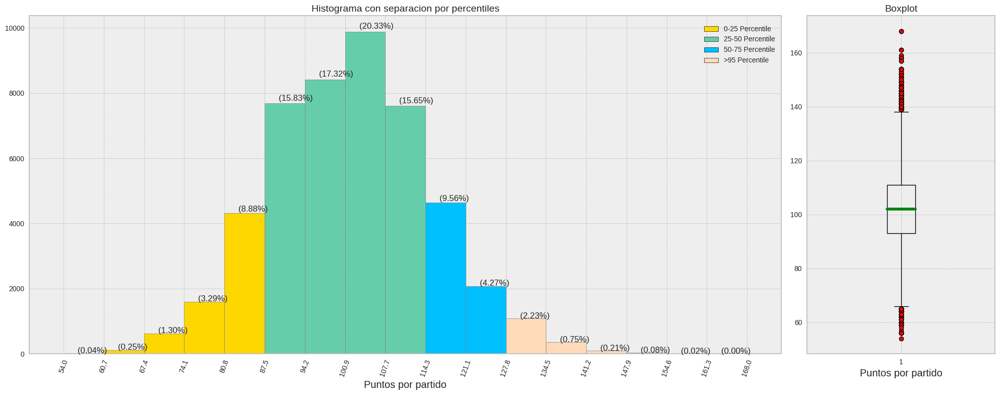

In [ ]:
# Puntos por partido:
histogram_box_plot(df_NBA['PTS'], 'Puntos por partido')

* Se puede ver en el grafico una distribución parecida a la normal, donde aproximadamente el 70% de los partidos (zona verde) oscilan entre 87 a 114 puntos por equipo.
* El valor máximo es 168 y su mínimo 54 puntos por partido.
* Su media supera apenas los 100 puntos (boxplot), considera outliers cuando supera aproximadamente los 138 y también cuando obtiene menos de 65 puntos aproximadamente.

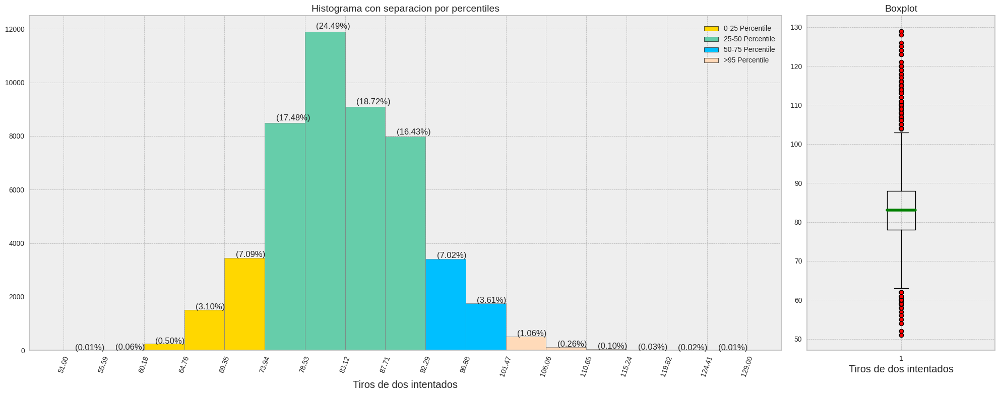

In [ ]:
# Tiros de dos intentados:
histogram_box_plot(df_NBA['FGA'], 'Tiros de dos intentados')

* Aproximadamente el 78% de los partidos (zona verde) oscilan entre los 74 a 92 tiros intentados por equipo por equipo.
* El valor máximo es 129 y su mínimo 51 tiros intentados.
* Su media aproximadamente es de 83 (boxplot), se puede ver mas presencia de outliers que la variable anterior. Los mismos se pueden ver cuando supera aproximadamente los 104 y también con menos de 63 tiros aproximadamente.

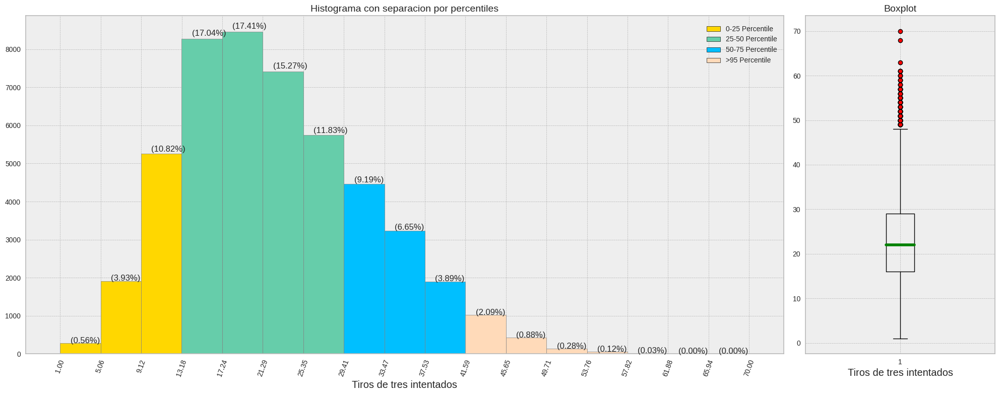

In [ ]:
# Tiros de tres intentados:
histogram_box_plot(df_NBA['FG3A'], 'Tiros de tres intentados')

* En este caso se puede ver una forma asimetrica hacia la izquierda (histogrma), aproximadamente el 61% de los partidos (zona verde) oscilan entre los 13 a 29 tiros intentados.
* El valor máximo es 70 y su mínimo un tiros intentados.
* Su media aproximadamente es de 22 (boxplot), se puede ver solo la presencia de outliers en la parte superior, cuando supera aproximadamente los 49 tiros.

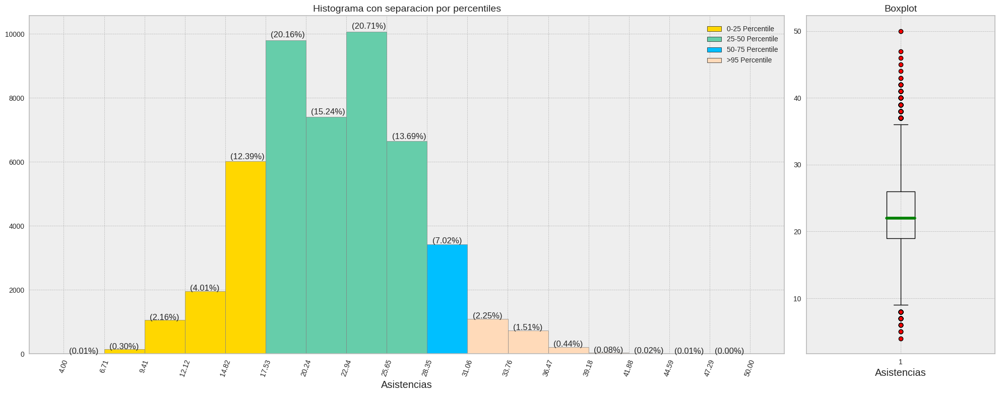

In [ ]:
# Asistencias:
histogram_box_plot(df_NBA['AST'], 'Asistencias')

* Tiene dos puntos altos de acuerdo a la forma del histograma,aproximadamente el 70% de los partidos (zona verde) oscilan entre los 17 a 28 asistencias por equipo.
* El valor máximo es 50 (un equipo en un solo partido alejado del resto) y su mínimo 4 tiros intentados.
* Su media aproximadamente es de 23 (boxplot), en el grafico se puede ver la presencia de pocos outliers. Los mismos se dan cuando supera aproximadamente los 36 y también con menos de 9 asistencias aproximadamente.

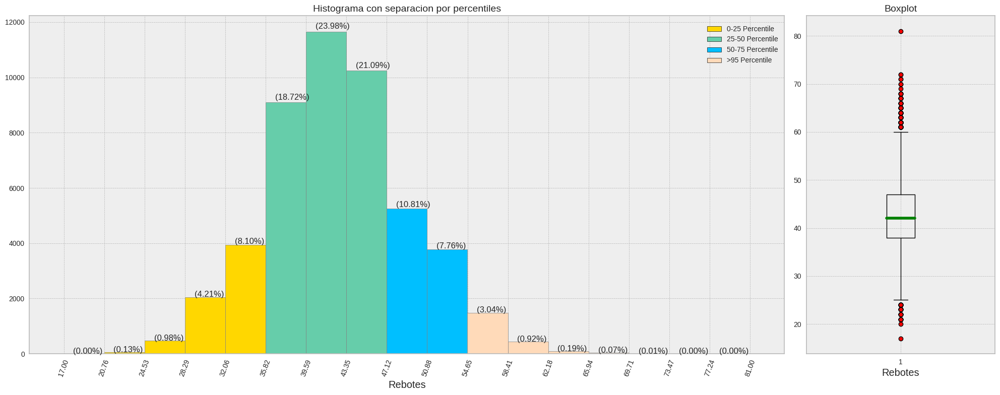

In [ ]:
# Rebotes:
histogram_box_plot(df_NBA['REB'], 'Rebotes')

* Aproximadamente el 64% de los partidos (zona verde) oscilan entre los 36 a 47 rebotes por equipo.
* El valor máximo es 81 (un equipo en un solo partido alejado del resto) y su mínimo 17 tiros intentados.
* Su media aproximadamente es de 43 (boxplot), en el grafico se puede ver la presencia de pocos outliers. Los mismos se dan cuando supera aproximadamente los 60 y también con menos de 26 rebotes aproximadamente.

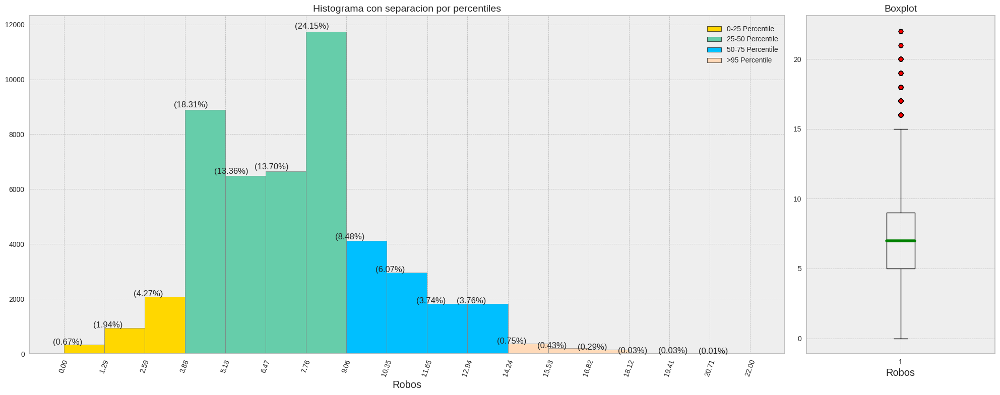

In [ ]:
# Robos:
histogram_box_plot(df_NBA['STL'], 'Robos')

* Tiene dos puntos altos de acuerdo a la forma del histograma,aproximadamente el 70% de los partidos (zona verde) oscilan entre los 4 a 9 robos por equipo.
* El valor máximo es 22 y su mínimo 0 robos.
* Su media aproximadamente es de 7 (boxplot), en el grafico se puede ver la presencia de muy pocos outliers y solo en la parte superior. Los mismos se dan cuando supera aproximadamente los 15 robos.

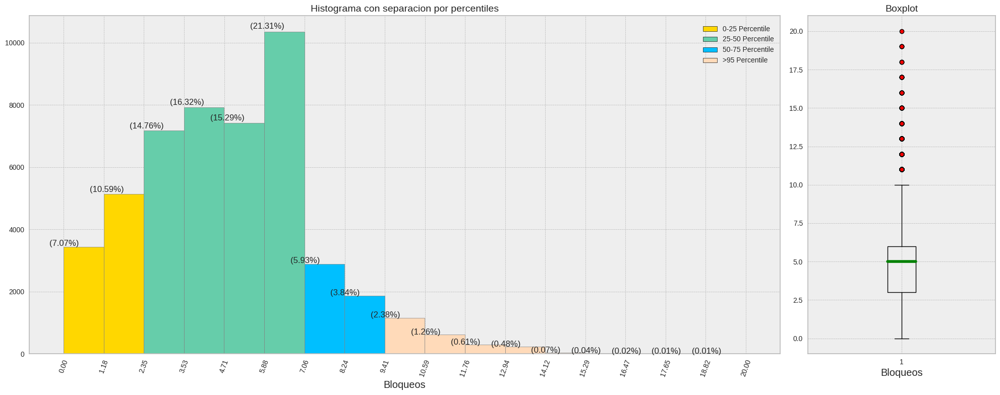

In [ ]:
# Bloqueos:
histogram_box_plot(df_NBA['BLK'], 'Bloqueos')

* Aproximadamente el 68% de los partidos (zona verde) oscilan entre los 2 a 7 bloqueos por equipo.
* El valor máximo es 20 y su mínimo 0 bloqueos.
* Su media aproximadamente es de 5 (boxplot), en el grafico se puede ver la presencia de muy pocos outliers y solo en la parte superior. Los mismos se dan cuando supera aproximadamente los 10 bloqueos.

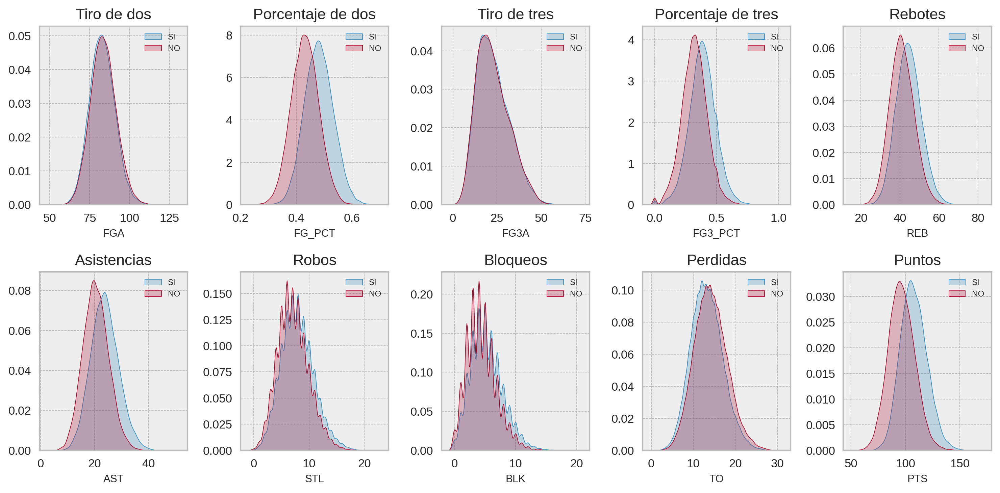

In [ ]:
# Comparo las distintas variables del Dataset con el target (Resultado del partido):

x_param = ['FGA', 'FG_PCT', 'FG3A', 'FG3_PCT', 'REB', 'AST', 'STL', 'BLK', 'TO', 'PTS']
f, axs = plt.subplots(2, 5, figsize=(12, 6), dpi=250)
x_title = ['Tiro de dos', 'Porcentaje de dos', 'Tiro de tres', 'Porcentaje de tres', 'Rebotes',
           'Asistencias', 'Robos', 'Bloqueos', 'Perdidas', 'Puntos']

for i, ax in enumerate(axs.flatten()):
    sns.kdeplot(df_NBA[x_param[i]][df_NBA['VICTORY']=='SI'], ax=ax, fill=True)
    sns.kdeplot(df_NBA[x_param[i]][df_NBA['VICTORY']=='NO'], ax=ax, fill=True)
    ax.set_xlabel(x_param[i], fontsize=9)
    ax.set_ylabel('')
    ax.set_title(x_title[i], fontsize=13)
    ax.legend(['SI','NO'], loc='upper right', fontsize=7)
f.tight_layout()
plt.show()

* A simple vista podemos ver las variables que cambian cuando las combinas con otra como el target ('VICTORY'), por lo que podemos decir que parámetros como "FG_PCT" (porcentaje de tiro de dos), "FG3_PCT" (porcentaje de tiro de tres), "AST" (asistencias), "REB" (rebotes), "PTS" (puntos) cambian de densidad o valores ante el resultado de un partido (cuando se gana o pierde).
* Las dos que más se destacan y diferencian entre perder o ganar un partido son los "PTS" (puntos) y el "FG_PCT" (porcentaje de tiro de dos).

In [ ]:
# Analisis del data set del ranking de cada equipo en cada temporada

df_ranking_season_uni = univariado_info(df_ranking_season)
df_ranking_season_uni

,Cantidad,Tipo,Nulos,Unicos,top,mean,std,min,25%,50%,75%,max,sesgo,kurtosis
TEAM,569,object,0,30,Phoenix Suns,-,-,-,-,-,-,-,-,-
SEASON,569,int64,0,19,-,2012.015817,5.473827,2003.0,2007.0,2012.0,2017.0,2021.0,-0.000846,-1.205674
MATCHES,569,int64,0,19,-,80.073814,5.543188,64.0,82.0,82.0,82.0,107.0,-1.373658,3.117556
VICTORY_NUM,569,int64,0,58,-,40.036907,12.444116,7.0,31.0,41.0,49.0,73.0,-0.054364,-0.658871
FGM,569,float64,0,449,-,37.980123,2.346853,32.365854,36.329268,37.80303,39.536232,45.674419,0.267307,-0.30738
FGA,569,float64,0,494,-,83.412365,4.021693,74.268293,80.5,82.939024,86.492537,93.97561,0.176737,-0.661096
FG3M,569,float64,0,452,-,8.162684,2.846306,2.817073,6.02439,7.621951,10.256098,16.134146,0.516095,-0.480359
FG3A,569,float64,0,506,-,22.874751,7.736628,8.158537,17.060976,21.158537,28.841463,45.56,0.546629,-0.535366
FTM,569,float64,0,437,-,18.008788,1.950654,12.243902,16.597561,17.780488,19.207317,24.109756,0.328488,0.078903
FTA,569,float64,0,448,-,23.69594,2.604335,16.573171,21.829268,23.405405,25.402439,31.54878,0.31795,-0.018299


- En esta tabla a diferencia de la otra muestra el promedio de las estadísticas, ya que la tabla original (df_ranking_season) muestras las estadísticas promedio totales que tuvo cada equipo en cada temporada, es decir, no esta divida por partido sino que por temporada completa. Por lo cual los valores atípicos que podemos ver en un partido en concreto ya se encuentran promediados. Como conclusión podemos ver valores más uniformes.

In [ ]:
# Analisis del data set df_players (infomacion de todos los jugadores)

df_players_uni = univariado_info(df_players)
df_players_uni

,Cantidad,Tipo,Nulos,Unicos,top,mean,std,min,25%,50%,75%,max,sesgo,kurtosis
PLAYER_NAME,2549,object,0,2549,A.J. Guyton,-,-,-,-,-,-,-,-,-
MATCHES,2549,int64,0,814,-,258.067477,325.662588,1.0,12.0,110.0,395.0,1756.0,1.524058,1.723067
FGM,2549,float64,0,1761,-,1.635677,1.603701,0.0,0.5,1.099415,2.318471,9.453872,1.536142,2.359623
FGA,2549,float64,0,1883,-,3.771466,3.460922,0.0,1.248649,2.714286,5.264481,19.246824,1.479448,2.135136
FG3M,2549,float64,0,1434,-,0.359961,0.500387,0.0,0.0,0.142857,0.5311,3.613445,1.863856,3.766087
FG3A,2549,float64,0,1666,-,1.08011,1.346181,0.0,0.030534,0.555556,1.6,8.641457,1.700702,3.049251
FTM,2549,float64,0,1673,-,0.777979,0.91237,0.0,0.189189,0.497055,1.006667,7.124161,2.396453,7.958261
FTA,2549,float64,0,1724,-,1.069819,1.172416,0.0,0.294118,0.714286,1.41573,8.335541,2.198223,6.573251
OREB,2549,float64,0,1652,-,0.52886,0.560806,0.0,0.135084,0.349153,0.734043,4.357673,1.821941,4.151356
DREB,2549,float64,0,1774,-,1.469147,1.349184,0.0,0.5,1.110985,2.072115,8.481436,1.597586,3.18617


**Insights:**
* Podemos notar que en esta tabla las estadísticas de juego (por ejemplo "puntos") son muy uniformes, existe mucha diferencia entre el 50% (mediana) y el valor máximo, tiene un gran volumen de datos en los primeros valores y pocos en los valores mas altos. Lo cual es lógico ya que son pocos jugadores los que se destacan con relación al resto (cada equipo esta integrado por 12 jugadores, de los cuales 5 pueden jugar en cancha y generalmente 2 o 3 se destacan en las estadísticas individuales).
* En este rango de años (2003-2021) podemos ver que el conjunto de datos contiene 2549 jugadores, de los cuales hay un jugador/es que estuvo en las 19 temporadas.
* El jugador/es que mas campeonatos logro en este periodo fueron 4 anillos.
* El/los que mas MVP de temporada regular logro son 4.
* El/los que mas veces fueron elegidos entre los mejores quintetos de la NBA fueron en 18 temporadas distintas.
* En cuando a los mejores quintetos defensivos el/los que mas veces estuvieron elegidos fue en 9 ocasiones.

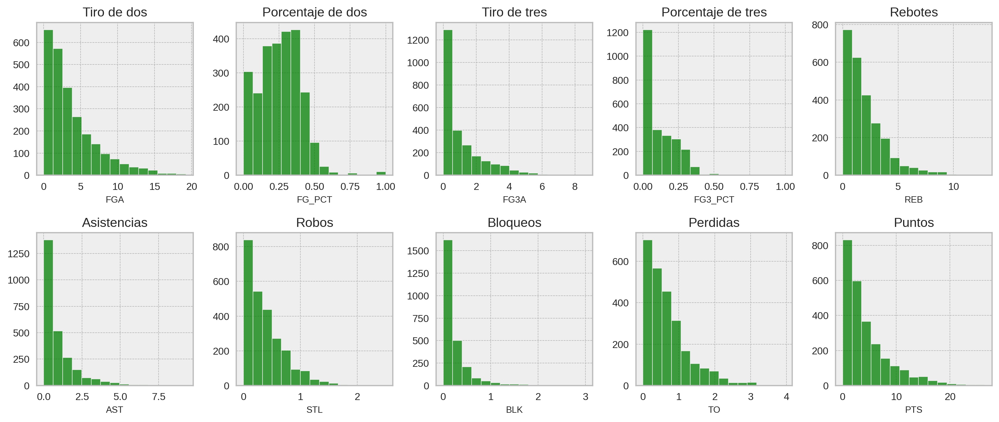

In [ ]:
# En estos gráficos podemos ver claramente que se ubican muchos valores en la zona baja de los mismos
# y pocos en los valores altos:

x_variables = ['FGA', 'FG_PCT', 'FG3A', 'FG3_PCT', 'REB', 'AST', 'STL', 'BLK', 'TO', 'PTS']
x_title = ['Tiro de dos', 'Porcentaje de dos', 'Tiro de tres', 'Porcentaje de tres', 'Rebotes',
           'Asistencias', 'Robos', 'Bloqueos', 'Perdidas', 'Puntos']
f, axs = plt.subplots(2, 5, figsize=(14,6), dpi=250)

for i, ax in enumerate(axs.flatten()):
    sns.histplot(df_players[x_variables[i]], ax=ax, bins=15, color='green')
    ax.set_xlabel(x_variables[i], fontsize=9)
    ax.set_ylabel('')
    ax.set_title(x_title[i], fontsize=13)
f.tight_layout()
plt.show()

## Preguntas (Análisis)

#### ¿Son distintas las estadisticas de temporada regular a comparacion con las de playoffs?

In [ ]:
# Graficos con las distintas variables
f, axs = plt.subplots(10, 2, figsize=(25, 100), dpi=300, gridspec_kw=dict(width_ratios=[10, 10]))

# Tiros de dos
sns.barplot(data=df_regular_season, x='SEASON', y='FGA', ax=axs[0,0])
sns.barplot(data=df_playoffs, x='SEASON', y='FGA', ax=axs[0,1])
FGA_regular = df_regular_season['FGA'].mean()
FGA_playoffs = df_playoffs['FGA'].mean()
axs[0,0].axhline(FGA_regular, color='blue', linestyle='--', alpha=0.8, linewidth=3, label='Valor promedio')
axs[0,1].axhline(FGA_playoffs, color='blue', linestyle='--', alpha=0.8, linewidth=3)
axs[0,0].set(xlabel='AÑO', ylabel='TIROS DE DOS INTENTADOS', title='TEMPORADA REGULAR')
axs[0,1].set(xlabel='AÑO', ylabel='TIROS DE DOS INTENTADOS', title='PLAYOFFS')
axs[0,0].legend()

# Porcentaje de tiros de dos
sns.lineplot(data=df_regular_season, x='SEASON', y='FG_PCT', ax=axs[1,0])
sns.lineplot(data=df_playoffs, x='SEASON', y='FG_PCT', ax=axs[1,1])
FG_PCT_regular = df_regular_season['FG_PCT'].mean()
FG_PCT_playoffs = df_playoffs['FG_PCT'].mean()
axs[1,0].axhline(FG_PCT_regular, color='blue', linestyle='--', alpha=0.8, linewidth=3, label='Valor promedio')
axs[1,1].axhline(FG_PCT_playoffs, color='blue', linestyle='--', alpha=0.8, linewidth=3)
axs[1,0].set(xlabel='AÑO', ylabel='PORCENTAJE DE TIROS DE DOS', title='TEMPORADA REGULAR')
axs[1,1].set(xlabel='AÑO', ylabel='PORCENTAJE DE TIROS DE DOS', title='PLAYOFFS')
axs[1,0].legend()

# Tiros de tres
sns.barplot(data=df_regular_season, x='SEASON', y='FG3A', ax=axs[2,0])
sns.barplot(data=df_playoffs, x='SEASON', y='FG3A', ax=axs[2,1])
FG3A_regular = df_regular_season['FG3A'].mean()
FG3A_playoffs = df_playoffs['FG3A'].mean()
axs[2,0].axhline(FG3A_regular, color='blue', linestyle='--', alpha=0.8, linewidth=3, label='Valor promedio')
axs[2,1].axhline(FG3A_playoffs, color='blue', linestyle='--', alpha=0.8, linewidth=3)
axs[2,0].set(xlabel='AÑO', ylabel='TIROS DE TRES INTENTADOS', title='TEMPORADA REGULAR')
axs[2,1].set(xlabel='AÑO', ylabel='TIROS DE TRES INTENTADOS', title='PLAYOFFS')
axs[2,0].legend()

# Porcentaje de tiros de tres
sns.lineplot(data=df_regular_season, x='SEASON', y='FG3_PCT', ax=axs[3,0])
sns.lineplot(data=df_playoffs, x='SEASON', y='FG3_PCT', ax=axs[3,1])
FG3_PCT_regular = df_regular_season['FG3_PCT'].mean()
FG3_PCT_playoffs = df_playoffs['FG3_PCT'].mean()
axs[3,0].axhline(FG3_PCT_regular, color='blue', linestyle='--', alpha=0.8, linewidth=3, label='Valor promedio')
axs[3,1].axhline(FG3_PCT_playoffs, color='blue', linestyle='--', alpha=0.8, linewidth=3)
axs[3,0].set(xlabel='AÑO', ylabel='PORCENTAJE DE TIROS DE TRES', title='TEMPORADA REGULAR')
axs[3,1].set(xlabel='AÑO', ylabel='PORCENTAJE DE TIROS DE TRES', title='PLAYOFFS')
axs[3,0].legend()

# Rebotes
sns.lineplot(data=df_regular_season, x='SEASON', y='REB', ax=axs[4,0])
sns.lineplot(data=df_playoffs, x='SEASON', y='REB', ax=axs[4,1])
REB_regular = df_regular_season['REB'].mean()
REB_playoffs = df_playoffs['REB'].mean()
axs[4,0].axhline(REB_regular, color='blue', linestyle='--', alpha=0.8, linewidth=3, label='Valor promedio')
axs[4,1].axhline(REB_playoffs, color='blue', linestyle='--', alpha=0.8, linewidth=3)
axs[4,0].set(xlabel='AÑO', ylabel='REBOTES PROMEDIO', title='TEMPORADA REGULAR')
axs[4,1].set(xlabel='AÑO', ylabel='REBOTES PROMEDIO', title='PLAYOFFS')
axs[4,0].legend()

# Asistencias
sns.barplot(data=df_regular_season, x='SEASON', y='AST', ax=axs[5,0])
sns.barplot(data=df_playoffs, x='SEASON', y='AST', ax=axs[5,1])
AST_regular = df_regular_season['AST'].mean()
AST_playoffs = df_playoffs['AST'].mean()
axs[5,0].axhline(AST_regular, color='blue', linestyle='--', alpha=0.8, linewidth=3, label='Valor promedio')
axs[5,1].axhline(AST_playoffs, color='blue', linestyle='--', alpha=0.8, linewidth=3)
axs[5,0].set(xlabel='AÑO', ylabel='ASISTENCIAS PROMEDIO', title='TEMPORADA REGULAR')
axs[5,1].set(xlabel='AÑO', ylabel='ASISTENCIAS PROMEDIO', title='PLAYOFFS')
axs[5,0].legend()

# Robos
sns.boxplot(data=df_regular_season, x='SEASON', y='STL', ax=axs[6,0])
sns.boxplot(data=df_playoffs, x='SEASON', y='STL', ax=axs[6,1])
STL_regular = df_regular_season['STL'].mean()
STL_playoffs = df_playoffs['STL'].mean()
axs[6,0].axhline(STL_regular, color='blue', linestyle='--', alpha=0.8, linewidth=3, label='Valor promedio')
axs[6,1].axhline(STL_playoffs, color='blue', linestyle='--', alpha=0.8, linewidth=3)
axs[6,0].set(xlabel='AÑO', ylabel='ROBOS PROMEDIO', title='TEMPORADA REGULAR')
axs[6,1].set(xlabel='AÑO', ylabel='ROBOS PROMEDIO', title='PLAYOFFS')
axs[6,0].legend()

# Bloqueos
sns.boxplot(data=df_regular_season, x='SEASON', y='BLK', ax=axs[7,0])
sns.boxplot(data=df_playoffs, x='SEASON', y='BLK', ax=axs[7,1])
BLK_regular = df_regular_season['BLK'].mean()
BLK_playoffs = df_playoffs['BLK'].mean()
axs[7,0].axhline(BLK_regular, color='blue', linestyle='--', alpha=0.8, linewidth=3, label='Valor promedio')
axs[7,1].axhline(BLK_playoffs, color='blue', linestyle='--', alpha=0.8, linewidth=3)
axs[7,0].set(xlabel='AÑO', ylabel='BLOQUEOS PROMEDIO', title='TEMPORADA REGULAR')
axs[7,1].set(xlabel='AÑO', ylabel='BLOQUEOS PROMEDIO', title='PLAYOFFS')
axs[7,0].legend()

# Perdidas
sns.lineplot(data=df_regular_season, x='SEASON', y='TO', ax=axs[8,0])
sns.lineplot(data=df_playoffs, x='SEASON', y='TO', ax=axs[8,1])
TO_regular = df_regular_season['TO'].mean()
TO_playoffs = df_playoffs['TO'].mean()
axs[8,0].axhline(TO_regular, color='blue', linestyle='--', alpha=0.8, linewidth=3, label='Valor promedio')
axs[8,1].axhline(TO_playoffs, color='blue', linestyle='--', alpha=0.8, linewidth=3)
axs[8,0].set(xlabel='AÑO', ylabel='PEDIDAS PROMEDIO', title='TEMPORADA REGULAR')
axs[8,1].set(xlabel='AÑO', ylabel='PERDIDAS PROMEDIO', title='PLAYOFFS')
axs[8,0].legend()

# Puntos
sns.barplot(data=df_regular_season, x='SEASON', y='PTS', ax=axs[9,0])
sns.barplot(data=df_playoffs, x='SEASON', y='PTS', ax=axs[9,1])
PTS_regular = df_regular_season['PTS'].mean()
PTS_playoffs = df_playoffs['PTS'].mean()
axs[9,0].axhline(PTS_regular, color='blue', linestyle='--', alpha=0.8, linewidth=3, label='Valor promedio')
axs[9,1].axhline(PTS_playoffs, color='blue', linestyle='--', alpha=0.8, linewidth=3)
axs[9,0].set(xlabel='AÑO', ylabel='PUNTOS PROMEDIO', title='TEMPORADA REGULAR')
axs[9,1].set(xlabel='AÑO', ylabel='PUNTOS PROMEDIO', title='PLAYOFFS')
axs[9,0].legend()

f.tight_layout();

**Insights:**

* **Tiros de dos:** Podemos ver un comportamiento similar tanto en temporada regular como en playoffs, tiende a un aumento leve en la cantidad de tiros intentados año tras año, observando que a partir del 2014 ya empieza a superar la media en la cantidad de tiros. Tanto la media como los tiros intentados a lo largo de los años en temporada regular son mas altos que en playoffs, esto puede deberse a posesiones mas largas o una defensa mas agresiva en post-temporada.
* **Porcentaje de tiros de dos:** Podemos ver que en ambas etapas de la competición existe un crecimiento pronunciado entre los años 2003 a 2005 aproximadamente.Luego entre el 2005 y el 2021, si bien se puede ver años donde el porcentaje mejora y otros donde baja de la media, el mismo tiende a mantenerse en el tiempo. Parece determinante mantener el mismo porcentaje de tiro con más cantidad de intentos. La media de temporada regular es un poco mas alta que la de playoffs.
* **Tiros de tres:** Posiblemente sea el aspecto de juego más interesante del conjunto de datos, ya que presenta un aumento muy importante a lo largo de las temporadas. La media es muy similar en ambas etapas del juego (temporada regular y playoffs). Podemos observar un comportamiento muy distinto en dos intervalos de tiempo, primero del año 2003 al 2010, donde en estas temporadas se ve un aumento aproximadamente de 3 tiros intentados en temporada regular y en 2 en playoffs; mientras que en el segundo intervalo entre el 2011 al 2021, parte de 18 tiros llegando el ultimo año a 35 intentos promedio por equipo. Se puede ver claramente un estilo de juego distinto, intentando a lo largo de los años tener un mayor volumen de tiros de tres, interpretando que se tiene más posibilidades de ganar un partido.
* **Porcentaje de tiros de tres:** Muy similar al porcentaje de tiros de dos, donde en los primeros años (2003-2005) se puede ver un aumento y luego se mantiene intercalando años con mayor y otros con menor porcentaje que la media.
* **Rebotes:** La media en ambas etapas de competición cambia aproximadamente en un rebote mas en temporada regular que en playoffs. Podemos ver una evolución leve en la cantidad de rebotes alcanzados, un poco más pronunciada en temporada regular. También podemos dividir en dos intervalos de tiempo, el primero del 2003 al 2012 donde se mantiene la cantidad, y el segundo del 2013 al 2021 que pasa aproximadamente de 42 a 44,5 rebotes en temporada regular y de 41 a 43,5 en playoffs.
* **Asistencias:** La media cambia aproximadamente en dos asistencias mas en temporada regular que en playoffs, pasa de 20 a 22. Podemos apreciar un comportamiento similar en ambas etapas de competición, donde entre los años 2003 al 2015 esta por debajo de la media, mientras que a partir del 2016 ya es superior a la misma.
* **Robos:** En este caso pareciera que tiende a mantenerse a lo largo de estos años. Pero si nos fijamos detenidamente en el periodo entre el 2003 al 2011 vemos mas años que se encuentran por debajo de la media, mientras que en el periodo entre el 2012 al 2021 se puede observar mas años que superan la media, ademas que tienen cuartil-es mas altos que el intervalo anterior.
* **Bloqueos:** Se observa que se mantiene a través de los años. Salvo en algunos años puntuales, donde la media es más alta. Esto puede deberse al nivel de juego de un grupo dominante de jugadores que coinciden en una misma temporada.
* **Perdidas:** En cuanto a este apartado se mantiene a través de las temporadas, salvo en los primeros años (2003-2007), donde presenta una disminución en la cantidad de perdidas.
* **Puntos:** En ambas etapas de la competición aumenta paulatinamente a través de los años, también se puede dividir en dos intervalos de tiempo, pero es diferente en temporada regular y en playoffs. El primer intervalo va desde el 2003 al 2014 de temporada regular y desde 2003 al 2012 en playoffs, donde se encuentra por debajo de la media; mientras que en el segundo intervalo la cantidad de puntos por partido es superior a la media, en temporada regular empieza a partir del 2015 y en playoff a partir del 2013.

#### El data set contiene muchos años, ¿se puede dividir el mismo en dos periodos de tiempo distintos?

Con las conclusiones obtenidas en los gráficos anteriores, es posible dividir el data set en periodos distintos de tiempo, ya que la mayoría de las estadísticas cambian a través de las temporadas y se podría obtener una mejor predicción tanto para el resultado de un partido como para otro tipo de target. Dividir el data set en dos partes, la primera desde el 2003 al 2011 y la segunda desde el 2012 al 2021. De esta forma notaremos algunos cambios en los valores de los distintos parámetros, principalmente en el tiro de tres intentado por equipo en un partido, a si como también veremos variaciones en la cantidad de tiros de dos intentados, rebotes, asistencias, robos y puntos por partido.

In [ ]:
df_NBA.head(3) # Contiene temporada regular y playoffs

,index,GAME_ID,TEAM_ID,PLAYER_ID,FGM,FGA,FG3M,FG3A,FTM,FTA,...,GAME_DATE_EST,CONFERENCE,HOME_TEAM_ID,HOME_TEAM_NUM,START_DATE_SEASON,FINISH_DATE_SEASON,START_DATE_PLAYOFF,FINISH_DATE_PLAYOFF,INSTANCE,VICTORY_NUM
0,2924,11900101,1610612746,13324094,34.0,77.0,16.0,41.0,15.0,19.0,...,2020-07-22,West,Los Angeles Clippers,1,2019-10-22,2020-08-14,2020-08-17,2020-10-11,Regular season,1
1,2925,11900101,1610612753,14656393,32.0,76.0,5.0,28.0,21.0,26.0,...,2020-07-22,East,Los Angeles Clippers,0,2019-10-22,2020-08-14,2020-08-17,2020-10-11,Regular season,0
2,2926,11900102,1610612743,9770101,28.0,63.0,10.0,31.0,23.0,28.0,...,2020-07-22,West,Denver Nuggets,1,2019-10-22,2020-08-14,2020-08-17,2020-10-11,Regular season,1


In [ ]:
# Dividimos el Data set en dos periodos:
df_NBA['PERIOD'] = ""
df_NBA.reset_index(inplace=True)

for i in range(0, len(df_NBA)):
  if df_NBA['SEASON'][i]<= 2011:
    df_NBA.loc[i, 'PERIOD'] = '2003-2011'
  else:
    df_NBA.loc[i, 'PERIOD'] = '2012-2021'

In [ ]:
# Agrupamos las estadisticas mas importantes en los dos periodos de tiempo, para poder hacer la comparativa:
df_periods = df_NBA.groupby(['PERIOD']).agg({'FGA':'mean','FG_PCT':'mean', 'FG3A':'mean', 'FG3_PCT':'mean', 'FTA':'mean',
                                             'FT_PCT':'mean', 'REB':'mean', 'OREB':'mean', 'DREB':'mean', 'AST':'mean',
                                             'TO':'mean', 'STL':'mean', 'BLK':'mean', 'PTS':'mean'})

df_periods.reset_index(inplace=True)
df_periods.head()

,PERIOD,FGA,FG_PCT,FG3A,FG3_PCT,FTA,FT_PCT,REB,OREB,DREB,AST,TO,STL,BLK,PTS
0,2003-2011,80.412774,0.454081,17.170942,0.351880,24.979764,0.756000,41.557631,11.284817,30.272814,21.074053,13.762848,7.364156,4.843271,97.882919
1,2012-2021,85.735760,0.457359,27.871921,0.355403,22.741644,0.764363,43.748352,10.369842,33.378511,23.099247,13.617959,7.674290,4.865487,105.580496


**Insights:** Podemos observar varias diferencias teniendo en cuenta que son valores promedios que cubren varios años.
* La diferencia mas importante es la cantidad de tiros intentados de tres, ya que aumento mas de 10 tiros por equipo lo que significa un incremento del 62,3%.
* Rebotes defensivos por equipo en un partido: Una diferencia de mas de 3 rebotes entre los periodos (crecimiento de un 10,3%).
* Asistencias por partido: Aumento mas de 2 unidades (crecimiento de un 9,6%).
* Puntos por equipo: Aumento 8 puntos por partido (crecimiento de un 8%).
* Tiros intentados de dos puntos: Una diferencia de mas de 5 tiros (crecimiento de un 6,6%).
* Tiros libres intentados: Una diferencia a favor del primer periodo de mas de 2 tiros (disminuyo un 9% el segundo periodo).
* Todo lo otro se mantiene, es decir presentan valores muy similares.

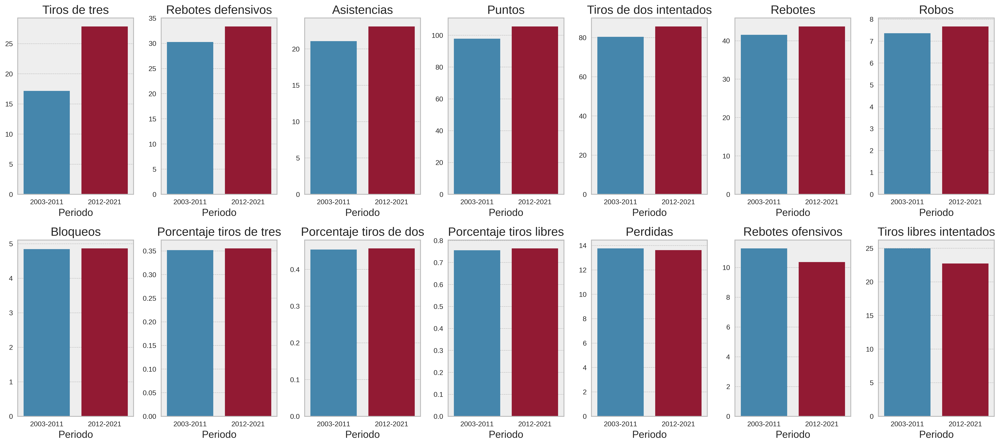

In [ ]:
# Grafico de todos los parametros mensionados, para distingir visualmente la diferencia entre los periodos:
f, axs = plt.subplots(2, 7, figsize=(20, 9), dpi=350)
parametro = ['FG3A', 'DREB', 'AST', 'PTS', 'FGA', 'REB', 'STL', 'BLK', 'FG3_PCT', 'FG_PCT', 'FT_PCT', 'TO', 'OREB', 'FTA']

for i, parametro in enumerate(parametro):
    sns.barplot(df_periods, x='PERIOD', y=parametro, ax=axs[i // 7, i % 7])

axs[0,0].set(xlabel='Periodo', title='Tiros de tres', ylabel='')
axs[0,1].set(xlabel='Periodo', title='Rebotes defensivos', ylabel='')
axs[0,2].set(xlabel='Periodo', title='Asistencias', ylabel='')
axs[0,3].set(xlabel='Periodo', title='Puntos', ylabel='')
axs[0,4].set(xlabel='Periodo', title='Tiros de dos intentados', ylabel='')
axs[0,5].set(xlabel='Periodo', title='Rebotes', ylabel='')
axs[0,6].set(xlabel='Periodo', title='Robos', ylabel='')
axs[1,0].set(xlabel='Periodo', title='Bloqueos', ylabel='')
axs[1,1].set(xlabel='Periodo', title='Porcentaje tiros de tres', ylabel='')
axs[1,2].set(xlabel='Periodo', title='Porcentaje tiros de dos', ylabel='')
axs[1,3].set(xlabel='Periodo', title='Porcentaje tiros libres', ylabel='')
axs[1,4].set(xlabel='Periodo', title='Perdidas', ylabel='')
axs[1,5].set(xlabel='Periodo', title='Rebotes ofensivos', ylabel='')
axs[1,6].set(xlabel='Periodo', title='Tiros libres intentados', ylabel='')

f.tight_layout()

#### ¿Afecta mucho el resultado de un partido cuando jugas de local?

In [ ]:
# Se crea una columna nueva "LOCAL/VISIT", para indicar si el equipo en el partido jugo en condición local o visita:
df_NBA['LOCAL/VISIT'] = ""
df_NBA['MATCHES'] = 1       # Contador de partidos

for i in range( 0 ,len(df_NBA)):
  if df_NBA['HOME_TEAM_NUM'][i] == 1:
    df_NBA.loc[ i, 'LOCAL/VISIT'] = 'Local'
  else:
    df_NBA.loc[ i, 'LOCAL/VISIT'] = 'Visit'

df_NBA.head(3)

,level_0,index,GAME_ID,TEAM_ID,PLAYER_ID,FGM,FGA,FG3M,FG3A,FTM,...,HOME_TEAM_NUM,START_DATE_SEASON,FINISH_DATE_SEASON,START_DATE_PLAYOFF,FINISH_DATE_PLAYOFF,INSTANCE,VICTORY_NUM,PERIOD,LOCAL/VISIT,MATCHES
0,0,2924,11900101,1610612746,13324094,34.0,77.0,16.0,41.0,15.0,...,1,2019-10-22,2020-08-14,2020-08-17,2020-10-11,Regular season,1,2012-2021,Local,1
1,1,2925,11900101,1610612753,14656393,32.0,76.0,5.0,28.0,21.0,...,0,2019-10-22,2020-08-14,2020-08-17,2020-10-11,Regular season,0,2012-2021,Visit,1
2,2,2926,11900102,1610612743,9770101,28.0,63.0,10.0,31.0,23.0,...,1,2019-10-22,2020-08-14,2020-08-17,2020-10-11,Regular season,1,2012-2021,Local,1


In [ ]:
# Creamos una tabla en la cual agrupamos primero por temporada (año) y luego por local/visita,
# con tres columnas más, que nos indican cuantas victorias hubo de local o visita en las temporadas,
# la cantidad de partidos que se jugo en dicho año y el porcentaje de victoria en las dos condiciones:

local_visit_all = df_NBA.groupby(['SEASON', 'LOCAL/VISIT']).agg({'VICTORY_NUM':'sum', 'MATCHES':'sum'})
local_visit_all.reset_index(inplace=True)
local_visit_all['WIN_PERCENTAGE'] = ""

# Calculo del porcentaje de victoria
for i in range(0, len(local_visit_all)):
  local_visit_all.loc[i, 'WIN_PERCENTAGE'] = (local_visit_all.loc[i, 'VICTORY_NUM']/local_visit_all.loc[i, 'MATCHES'])*100

local_visit_all.head(5)

,SEASON,LOCAL/VISIT,VICTORY_NUM,MATCHES,WIN_PERCENTAGE
0,2003,Local,789,1271,62.077105
1,2003,Visit,482,1271,37.922895
2,2004,Local,791,1312,60.289634
3,2004,Visit,521,1312,39.710366
4,2005,Local,802,1319,60.803639


In [ ]:
# Creamos otra tabla en la cual agrupamos primero por periodo de tiempo (2003-2011 y 2012-2021) y luego por
# local/visita, con tres columnas más como en la tabla anterior, que nos indican cuantas victorias hubo de local o visita
# en los periodos, la cantidad de partidos que se jugo en dicho lapso y el porcentaje de victoria en las dos condiciones:

local_visit_period = df_NBA.groupby(['PERIOD', 'LOCAL/VISIT']).agg({'VICTORY_NUM':'sum', 'MATCHES': 'sum'})
local_visit_period.reset_index(inplace=True)
local_visit_period['WIN_PERCENTAGE'] = ""

# Calculo del porcentaje de victoria
for i in range(0, len(local_visit_period)):
  local_visit_period.loc[i, 'WIN_PERCENTAGE'] = (local_visit_period.loc[i, 'VICTORY_NUM']/local_visit_period.loc[i, 'MATCHES'])*100

local_visit_period.head()

,PERIOD,LOCAL/VISIT,VICTORY_NUM,MATCHES,WIN_PERCENTAGE
0,2003-2011,Local,6988,11539,60.559841
1,2003-2011,Visit,4551,11539,39.440159
2,2012-2021,Local,7362,12746,57.759297
3,2012-2021,Visit,5384,12746,42.240703


In [ ]:
# Creamos la tercera tabla en la cual agrupamos primero por instancia (temporada regular y playoffs) y luego por
# local/visita, con tres columnas más como las demas tablas, que nos indican cuantas victorias hubo de local o visita
# en las instancias, la cantidad de partidos que se jugo y el porcentaje de victoria en las dos condiciones:

local_visit_instance_all = df_NBA.groupby(['INSTANCE', 'LOCAL/VISIT']).agg({'VICTORY_NUM':'sum', 'MATCHES': 'sum'})
local_visit_instance_all.reset_index(inplace=True)
local_visit_instance_all['WIN_PERCENTAGE'] = ""

# Calculo del porcentaje de victoria
for i in range(0, len(local_visit_instance_all)):
  local_visit_instance_all.loc[i, 'WIN_PERCENTAGE'] = (local_visit_instance_all.loc[i, 'VICTORY_NUM']/local_visit_instance_all.loc[i, 'MATCHES'])*100

local_visit_instance_all.head(5)

,INSTANCE,LOCAL/VISIT,VICTORY_NUM,MATCHES,WIN_PERCENTAGE
0,Playoff,Local,952,1504,63.297872
1,Playoff,Visit,552,1504,36.702128
2,Regular season,Local,13398,22781,58.812168
3,Regular season,Visit,9383,22781,41.187832


In [ ]:
# Creamos la cuarta tabla en la cual agrupamos primero por instancia (temporada regular y playoffs), luego por temporada
# y por ultimo local/visita, con tres columnas más como las demas tablas, que nos indican cuantas victorias hubo de local o visita
# en las instancias, la cantidad de partidos que se jugo y el porcentaje de victoria en las dos condiciones.
# En este caso luego dividimos la tabla en dos subtablas, para tener agrupada la informacíon de las dos instancias por separado:

local_visit_instance = df_NBA.groupby(['INSTANCE', 'SEASON', 'LOCAL/VISIT']).agg({'VICTORY_NUM':'sum', 'MATCHES':'sum'})
local_visit_instance.reset_index(inplace=True)
local_visit_instance['WIN_PERCENTAGE'] = ""

# Calculo del porcentaje de victoria
for i in range(0, len(local_visit_instance)):
 local_visit_instance.loc[i, 'WIN_PERCENTAGE'] = (local_visit_instance.loc[i, 'VICTORY_NUM']/local_visit_instance.loc[i, 'MATCHES'])*100

# Lo divido en temporada regular y playoffs
local_visit_season = local_visit_instance[local_visit_instance['INSTANCE'] == 'Regular season']
local_visit_playoffs = local_visit_instance[local_visit_instance['INSTANCE'] == 'Playoff']

local_visit_instance.head()

,INSTANCE,SEASON,LOCAL/VISIT,VICTORY_NUM,MATCHES,WIN_PERCENTAGE
0,Playoff,2003,Local,59,82,71.95122
1,Playoff,2003,Visit,23,82,28.04878
2,Playoff,2004,Local,47,84,55.952381
3,Playoff,2004,Visit,37,84,44.047619
4,Playoff,2005,Local,60,89,67.41573


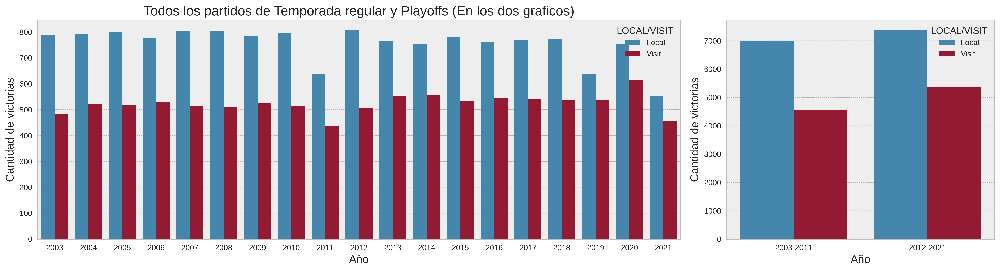

In [ ]:
# Grafico N°1:
f, axs = plt.subplots(1, 2, figsize=(18,5), dpi=350, gridspec_kw=dict(width_ratios=[12, 5]))

sns.barplot(local_visit_all, x='SEASON', y='VICTORY_NUM', hue='LOCAL/VISIT', ax=axs[0])
sns.barplot(local_visit_period, x='PERIOD', y='VICTORY_NUM', hue='LOCAL/VISIT', ax=axs[1])

axs[0].set(xlabel='Año', ylabel='Cantidad de victorias', title='Todos los partidos de Temporada regular y Playoffs (En los dos graficos)')
axs[1].set(xlabel='Año', ylabel='Cantidad de victorias')

f.tight_layout()

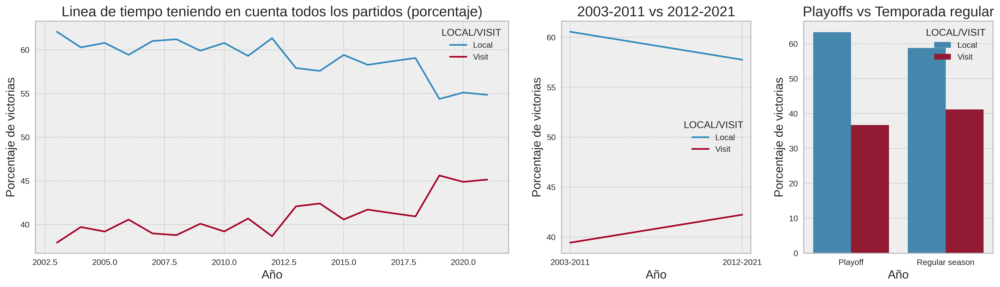

In [ ]:
# Grafico N°2:
f, axs = plt.subplots(1, 3, figsize=(17,5), dpi=350, gridspec_kw=dict(width_ratios=[10, 4, 4]))

sns.lineplot(local_visit_all, x='SEASON', y='WIN_PERCENTAGE', hue='LOCAL/VISIT', ax=axs[0])
sns.lineplot(local_visit_period, x='PERIOD', y='WIN_PERCENTAGE', hue='LOCAL/VISIT', ax=axs[1])
sns.barplot(local_visit_instance_all, x='INSTANCE', y='WIN_PERCENTAGE', hue='LOCAL/VISIT', ax=axs[2])

axs[0].set(xlabel='Año', ylabel='Porcentaje de victorias', title='Linea de tiempo teniendo en cuenta todos los partidos (porcentaje)')
axs[1].set(xlabel='Año', ylabel='Porcentaje de victorias', title='2003-2011 vs 2012-2021')
axs[2].set(xlabel='Año', ylabel='Porcentaje de victorias', title='Playoffs vs Temporada regular')

f.tight_layout();

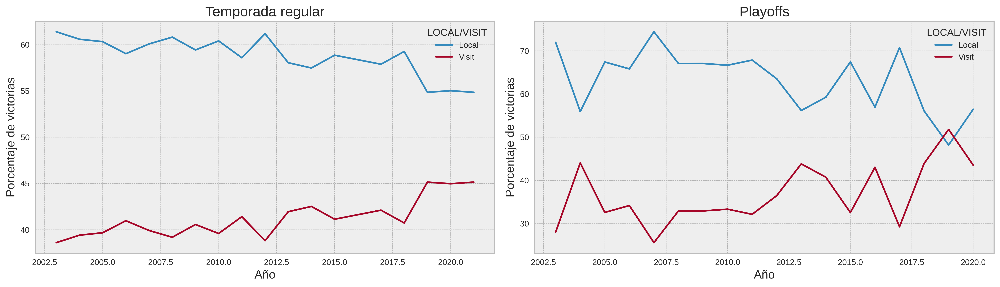

In [ ]:
# Grafico N°3:
f, axs = plt.subplots(1, 2, figsize=(17,5), dpi=350, gridspec_kw=dict(width_ratios=[10, 10]))

sns.lineplot(local_visit_season, x='SEASON', y='WIN_PERCENTAGE', hue='LOCAL/VISIT', ax=axs[0])
sns.lineplot(local_visit_playoffs, x='SEASON', y='WIN_PERCENTAGE', hue='LOCAL/VISIT', ax=axs[1])

axs[0].set(xlabel='Año', ylabel='Porcentaje de victorias', title='Temporada regular')
axs[1].set(xlabel='Año', ylabel='Porcentaje de victorias', title='Playoffs')

f.tight_layout();

**Insights:** Podemos ver que jugar de local influye mucho en el resultado de un partido:
* **Grafico N°1:** Vemos una importante diferencia en la cantidad de victorias de local con relación a las que se tienen de visita, tanto en las distintas temporadas a lo largo de los años, como en los dos periodos de tiempo seleccionados.
* **Grafico N°2:** Podemos observar que a medida que pasan los años la brecha del porcentaje de victoria entre jugar de local o vista va disminuyendo, es decir, tiende a influir menos en el resultado de un partido jugar en tu estadio con tu afición, esto puede deberse que tanto los equipos y como los jugadores individualmente se preparan cada vez mejor cuando juegan lejos de casa. También podemos ver que en playoffs la diferencia es mayor entre jugar de local o visita, es decir, pesa mas la localia a la hora de definir un partido. Ya que en la tabla se puede ver que jugando de local se tiene un porcentaje de victoria del 63,3%, mientras que en temporada regular un 58,8% (una diferencia de casi 5%).
* **Grafico N°3:** Con este grafico podemos ver de manera mas precisa la evolución que tiene a lo largo de los años la influencia de jugar de local, tanto en temporada regular como en playoffs. En temporada regular presenta una linea mas uniforme que en playoffs, esto puede deberse que la cantidad de partidos que hay es mayor (45562 contra 3002), por lo que es mas preciso sacar una tendencia. Observamos que parte de mas de un 61% de victorias jugando de local sobre el total de partidos en el 2003, y lentamente va disminuyendo hasta un 55% aproximadamente en 2021. Mientras que en playoffs la linea temporal no se uniforme, va variando con los años, aunque tiene un periodo donde se mantiene algo constante (2005-2012) oscilando en un 67% aproximadamente, luego varia mucho, hasta el punto que en el año 2019 presenta un porcentaje de victorias menor al 50% jugando de local (único año que tiene un porcentaje desfavorable). En lineas generales también disminuye el porcentaje a través de los años.

#### ¿Que pasa si viculamos cada estadistica de juego, que analisis podemos ver de ellas con relacion al resultado de un partido (victoria)?


<Figure size 1200x1200 with 0 Axes>

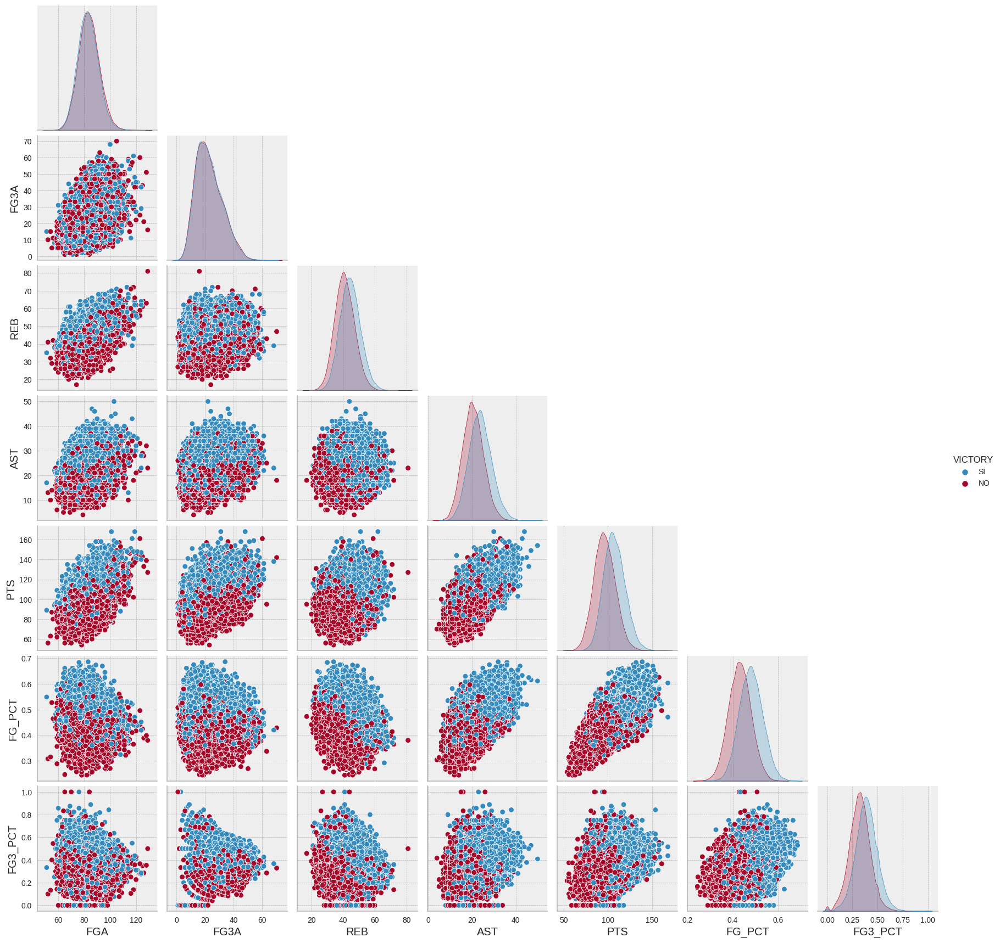

In [ ]:
# Grafico que visualiza todas las relaciones entre las estadísticas más importantes:
plt.figure(figsize=(12, 12))

sns.pairplot(df_NBA[['FGA', 'FG3A', 'REB', 'AST', 'PTS', 'FG_PCT', 'FG3_PCT','VICTORY']], diag_kind='kde', hue='VICTORY', corner=True)

In [ ]:
# Ahora vamos a dividir el df_NBA en los dos periodos de tiempo antes analizados (2003-2011 y 2012-2021):
period_analysis_1 = df_NBA[df_NBA['PERIOD'] == '2003-2011']
period_analysis_2 = df_NBA[df_NBA['PERIOD'] == '2012-2021']

matches_period = df_NBA.groupby(['PERIOD']).agg({'MATCHES':'sum'})
matches_period.head()

,MATCHES
PERIOD,
2003-2011,23078
2012-2021,25492


* Podemos ver que la cantidad de partidos entre un periodo y el otro es similir, por lo cual se puede hacer una correcta comparacion.

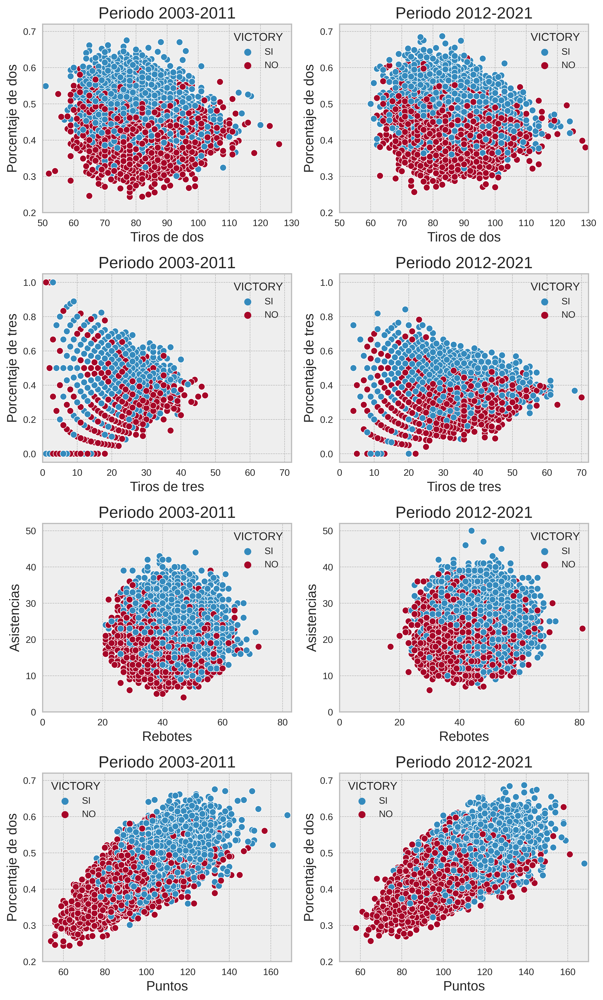

In [ ]:
# Vamos a seleccionar las visualizaciones más interesantes del primer apartado y compararlos entre los dos periodos:
f, axs = plt.subplots(4, 2, figsize=(9, 15), dpi=600)

order = ['SI', 'NO']

sns.scatterplot(period_analysis_1, x='FGA', y='FG_PCT', hue='VICTORY', hue_order=order, ax=axs[0,0])
sns.scatterplot(period_analysis_2, x='FGA', y='FG_PCT', hue='VICTORY', hue_order=order, ax=axs[0,1])
sns.scatterplot(period_analysis_1, x='FG3A', y='FG3_PCT', hue='VICTORY', hue_order=order, ax=axs[1,0])
sns.scatterplot(period_analysis_2, x='FG3A', y='FG3_PCT', hue='VICTORY', hue_order=order, ax=axs[1,1])
sns.scatterplot(period_analysis_1, x='REB', y='AST', hue='VICTORY', hue_order=order, ax=axs[2,0])
sns.scatterplot(period_analysis_2, x='REB', y='AST', hue='VICTORY', hue_order=order, ax=axs[2,1])
sns.scatterplot(period_analysis_1, x='PTS', y='FG_PCT', hue='VICTORY', hue_order=order, ax=axs[3,0])
sns.scatterplot(period_analysis_2, x='PTS', y='FG_PCT', hue='VICTORY', hue_order=order, ax=axs[3,1])

axs[0,0].set(xlabel='Tiros de dos', ylabel='Porcentaje de dos', title='Periodo 2003-2011', ylim=(0.2,0.72), xlim=(50,130))
axs[0,1].set(xlabel='Tiros de dos', ylabel='Porcentaje de dos', title='Periodo 2012-2021', ylim=(0.2,0.72), xlim=(50,130))
axs[1,0].set(xlabel='Tiros de tres', ylabel='Porcentaje de tres', title='Periodo 2003-2011', ylim=(-0.05,1.05), xlim=(0,72))
axs[1,1].set(xlabel='Tiros de tres', ylabel='Porcentaje de tres', title='Periodo 2012-2021', ylim=(-0.05,1.05), xlim=(0,72))
axs[2,0].set(xlabel='Rebotes', ylabel='Asistencias', title='Periodo 2003-2011', ylim=(0,52), xlim=(0,83))
axs[2,1].set(xlabel='Rebotes', ylabel='Asistencias', title='Periodo 2012-2021', ylim=(0,52), xlim=(0,83))
axs[3,0].set(xlabel='Puntos', ylabel='Porcentaje de dos', title='Periodo 2003-2011', ylim=(0.2,0.72), xlim=(50,170))
axs[3,1].set(xlabel='Puntos', ylabel='Porcentaje de dos', title='Periodo 2012-2021', ylim=(0.2,0.72), xlim=(50,170))

f.tight_layout()

**Insights:**
* **Tiro de dos y su porcentaje:** Vemos que existe una conexión entre las variables, podemos distinguir que en ambos periodos el porcentaje de tiro tiene más influencia en el resultado de un partido (victoria), ya que los puntos azules se ubican en la zona alta del grafico. Pero los mismos se encuentran más dispersos en el eje x (tiros intentados). Con respecto a la diferencia entre los periodos vemos que hubo un crecimiento tanto en el porcentaje como en la cantidad de tiros, pero podemos observar que los puntos se desplazaron más horizontalmente (tiros) que verticalmente (porcentaje). Por lo que hubo un aumento más grande en los tiros de dos intentados por equipo.
* **Tiro de tres y su porcentaje:** Aca también vemos que visualmente el porcentaje de tiro influye mucho mas en el resultado de un partido que la cantidad de tiros intentados. En cuando a los periodos el cambio es muy significativo y notorio, se puede apreciar mucha mas cantidad de puntos en los valores altos del eje x (tiros intentados) en el periodo del 2012-2021.
* **Asistencias y rebotes:** En este caso podemos ver que tanto las asistencias como los rebotes influyen positivamente en un partido. Entre los periodos en lineas generales no se observan muchos cambios, en cuanto a la forma del grafico, solo se puede apreciar un pequeño aumento en los valores de ambas variables entre el periodo 2003-2011 al 2012-2021.
* **Puntos y porcentaje de tiro de dos:** Es uno de los gráficos más interesantes, ya que ambas variables son muy importantes en un partido, se puede ver una influencia muy positiva en el resultado del mismo, en el grafico se aprecia muy claro la división entre las victorias y las derrotas. La ubicación de las victorias (puntos azules) tienden a estar en el extremo superior derecho del grafico. En cuanto a los periodos de tiempo vemos un aumento marcado en los puntos por partido, ya que se pueden observar más puntos ubicados en los valores altos del eje x (puntos).

#### ¿Como podríamos graficar las algunas de las características más destacadas de los jugadores de la NBA?

**Grafico 1:** LeBron James, sin duda es uno de los mejores jugadores de la historia, considerado ya por algunos el mejor de la historia por delante de Michael Jordan, dos jugadores que marcaron sus épocas. LeBron por ahora triunfo en 3 equipos donde gano sus campeonatos, compartiendo equipo con jugadores muy talentosos. Entre ellos se pueden destacar Dwyane Wade (Miami), Kyrie Irving (Cleveland) y Anthony Davis que juega actualmente en los Lakers.

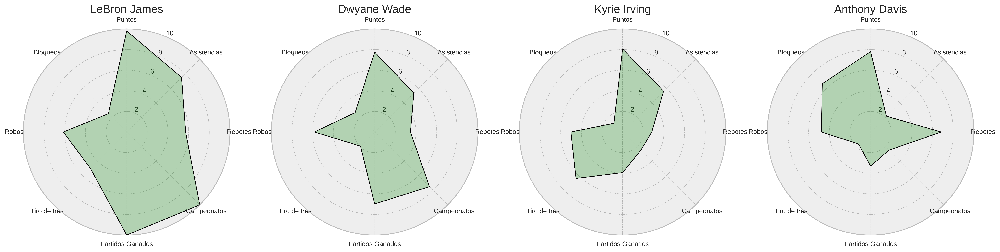

In [ ]:
# Grafico 1:
plot_radar_compare(df_players, 'LeBron James', 'Dwyane Wade', 'Kyrie Irving', 'Anthony Davis', 'PLAYER_NAME')

**Insights:**
* Podemos ver que **LeBron** destaca mucho en aspectos como puntos y asistencias por partido. En puntos tiene uno de los mejores promedios en los últimos 20 años. Pero también destaca en atributos como rebotes y robos, teniendo más que muchos jugadores de la competición, sumado a que tiene un tiro de tres aceptable. En conclusión es un jugador muy completo que ayuda al equipo en casi todos los aspectos del juego.
* **Dwyane Wade** jugo con LeBron en Miami donde ganaron dos campeonatos, un jugador que ayuda tanto ofensivamente como defensivamente, ya que destaca mucho en puntos, asistencias y robos.
* **Kyrie Irving** jugo con LeBron en Cleveland donde ganaron un campeonato, aporta el mismo nivel alto de puntos que el anterior, es un poco mas ofensivo que Dwyane Wade, ya que tiene bastante mas tiro de tres y un poco mas de asistencias. Pero en el apartado defensivo es peor, ya que tiene menos bloqueos, rebotes y robos.
* **Anthony Davis** juega actualmente con LeBron en los Lakers donde ganaron un campeonato, aporta al equipo el mismo nivel de puntos que los anteriores jugadores. Pero a diferencia de los otros dos ayuda mucho a niveles defensivos en la zona pintada (cerca del aro), ya que tiene un alto nivel en rebotes y bloqueos, no quedándose a tras también en robos.
***


**Grafico 2:** Stephen Curry, sin duda uno de los mejores jugadores de los últimos 20 años, considerado para algunos dentro de los 10 o 15 mejores de la historia. Junto a Klay Thompson, Draymond Green y luego en un par de años con Kevin Durant hicieron que Golden State Warriors sea uno de los equipos mas exitosos en estos últimos 20 años.

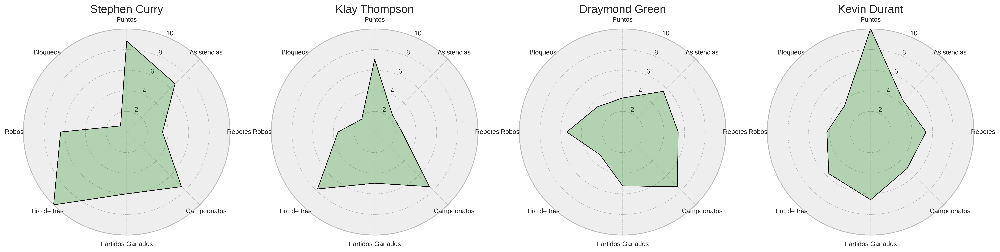

In [ ]:
# Grafico 2:
plot_radar_compare(df_players, 'Stephen Curry', 'Klay Thompson', 'Draymond Green', 'Kevin Durant', 'PLAYER_NAME')

**Insighs:**
* Podemos ver que **Stephen Curry** le aporta a su equipo un gran volumen de tiro de tres (logrando abrir la cancha y dejar mas espacios a sus compañeros), también un volumen alto de puntos y robos por partido, no quedandose a tras en el apartado de las asistencias.
* **Klay Thompson** refuerza junto a Curry el volumen en el tiro de tres y aporta un nivel de puntos alto.
* **Draymond Green** no aporta muchos puntos por partido. Pero parece un jugador más completo, ya que se puede ver que ayuda en apartados como asistencias, robos, rebotes y bloqueos. Logrando reforzar todos los aspectos del juego.
* **Kevin Durant** considerado por algunos uno de los mejores jugadores de la historia en el apartado ofensivo. Claramente se puede ver en el grafico, ya que ofrece uno de los volúmenes mas altos de puntos en los últimos años (2003-2021). Destacándose también en el rebote y tiro de tres.
***

**Grafico 3:** Tim Ducan, Manu Ginobili y Tony Parker considerado uno de los tridentes mas ganadores de la NBA (equipo: San Antonio Spurs), con 4 campeonatos juntos de los cuales en este Data set hay 3. El ultimo campeonato lo ganaron junto a Kawhi Leonard, siendo este la figura de las finales.



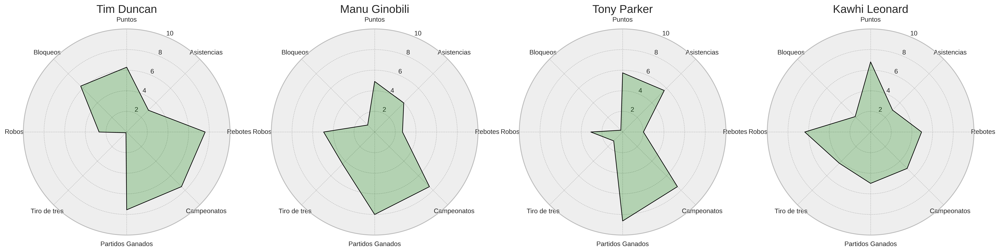

In [ ]:
# Grafico 3:
plot_radar_compare(df_players, 'Tim Duncan', 'Manu Ginobili', 'Tony Parker', 'Kawhi Leonard', 'PLAYER_NAME')

**Insights:**
* Se puede ver en el grafico que **Tim Duncan**, **Manu Ginobili** y **Tony Parker** son jugadores con estadísticas diferentes, aportando cada uno facetas de juego distintas y así logrando un muy buen balance en el equipo. Duncan aporta puntos, bloqueos y un nivel muy alto de rebotes; Ginobili aporta puntos, asistencias, tiro de tres y un nivel alto de robos; y Parker aporta un nivel alto en puntos y asistencias.
* **Kawhi Leonard** jugo con ellos en los últimos años de excito en la franquicia (Spurs), un jugador que aporta muchos puntos y también es muy bueno defensivamente, ya que se puede ver en el grafico que ayuda en los rebotes y sobre todo en robos, donde tiene un nivel alto.
***

In [ ]:
# Agregar una fila con el promedio de todos los jugadores en cada una de las columnas
mean = df_players.mean()
mean['PLAYER_NAME'] = 'El promedio de todos los jugadores'
df_players = df_players.append(mean, ignore_index=True)

**Grafico 4:** Jugadores top como Chris Paul, Russell Westbrook y James Harden que hasta ahora no pudieron ganar ningún campeonato en su carrera. En comparación también con el promedio de todos los jugadores de la NBA.

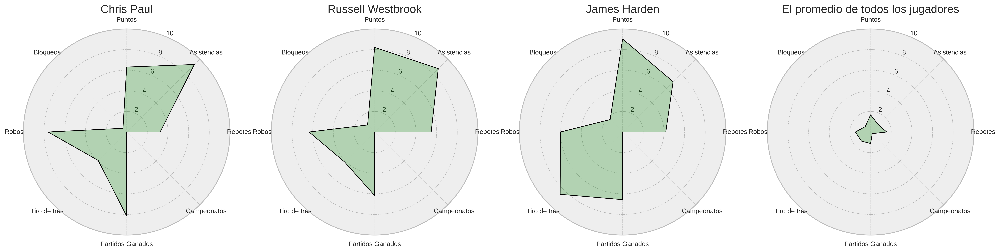

In [ ]:
# Grafico 4:
plot_radar_compare(df_players, 'Chris Paul', 'Russell Westbrook', 'James Harden', 'El promedio de todos los jugadores', 'PLAYER_NAME')

**Insights:**
* **Chris Paul** es considerado uno de los mejores pasadores de la historia (asistencias), donde claramente en el grafico se puede ver que es su mejor cualidad, también destaca mucho en robos con un nivel alto y en puntos no se queda atrás.
* **Russell Westbrook**, se puede ver que es un jugador completo, donde destaca mucho en los puntos y asistencias por partido, y en un segundo escalón en robos y rebotes.
* **James Harden**, sus dos mejores cualidades son el tiro de tres y los puntos por partido, siguiendo después por los robos y asistencias.
* En el ultimo grafico se puede ver el promedio de todos los jugadores, claramente hay mucha diferencia con los jugadores top.

#### Y con relacion a los equipos de la NBA ¿Se podria graficar las mismas características?

In [ ]:
# Creamos una tabla nueva 'teams_NBA', para agregar al mismo el numero de los campeonatos ganados y vincularlo con el equipo correspondiente
teams_NBA = df_NBA.copy()
teams_NBA = pd.merge(teams_NBA, num_champion, how='left', on=['GAME_ID', 'TEAM_ID'])
teams_NBA.fillna(0, inplace=True)   # llenado de nulos por 0 (cero)
teams_NBA.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 48570 entries, 0 to 48569
Data columns (total 41 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   level_0              48570 non-null  int64         
 1   index                48570 non-null  int64         
 2   GAME_ID              48570 non-null  int64         
 3   TEAM_ID              48570 non-null  int64         
 4   PLAYER_ID            48570 non-null  int64         
 5   FGM                  48570 non-null  float64       
 6   FGA                  48570 non-null  float64       
 7   FG3M                 48570 non-null  float64       
 8   FG3A                 48570 non-null  float64       
 9   FTM                  48570 non-null  float64       
 10  FTA                  48570 non-null  float64       
 11  OREB                 48570 non-null  float64       
 12  DREB                 48570 non-null  float64       
 13  REB                  48570 non-

In [ ]:
# Cantidad de campeonatos en el Data set
teams_NBA['CHAMPION_NUM'].sum()

18.0

In [ ]:
# Agrupamos por equipo y las variables que seleccionamos anteriormente
teams_NBA = teams_NBA.groupby(['TEAM']).agg({'FG3A':'sum','REB':'sum', 'AST':'sum',
                                          'STL':'sum', 'BLK':'sum','PTS':'sum',
                                          'VICTORY_NUM':'sum', 'CHAMPION_NUM':'sum'})
teams_NBA.reset_index(inplace=True)
teams_NBA.head(5)

,TEAM,FG3A,REB,AST,STL,BLK,PTS,VICTORY_NUM,CHAMPION_NUM
0,Atlanta Hawks,38283.0,68863.0,37030.0,12474.0,7784.0,165807.0,766,0.0
1,Boston Celtics,39874.0,72074.0,39077.0,13652.0,8152.0,174274.0,945,1.0
2,Brooklyn Nets,38890.0,68596.0,36368.0,11442.0,7081.0,163191.0,714,0.0
3,Charlotte Hornets,32097.0,60898.0,31938.0,10606.0,7226.0,143984.0,584,0.0
4,Chicago Bulls,33344.0,70667.0,35978.0,11583.0,8014.0,160106.0,794,0.0


In [ ]:
# Seleccionamos solo los equipos que ganaron aunque sea un campeonato
pie_teams = teams_NBA[['TEAM','CHAMPION_NUM']]
pie_teams = pie_teams[ pie_teams['CHAMPION_NUM'] >= 1]
pie_teams

,TEAM,CHAMPION_NUM
1,Boston Celtics,1.0
5,Cleveland Cavaliers,1.0
6,Dallas Mavericks,1.0
8,Detroit Pistons,1.0
9,Golden State Warriors,3.0
13,Los Angeles Lakers,3.0
15,Miami Heat,3.0
16,Milwaukee Bucks,1.0
26,San Antonio Spurs,3.0
27,Toronto Raptors,1.0


In [ ]:
# Grafico de torta para poder distinguir más fácilmente los equipos mas exitosos del periodo
fig = px.pie(pie_teams, values='CHAMPION_NUM', names='TEAM', title='Mejores equipos (2003-2021)')
fig.update_traces( textposition='outside', textinfo='percent+label')

fig.show()

* Podemos distinguir que hay 4 equipos que destacan sobre el resto, ganando cada uno 3 campeonatos en el lapso analizado (2003-2021).

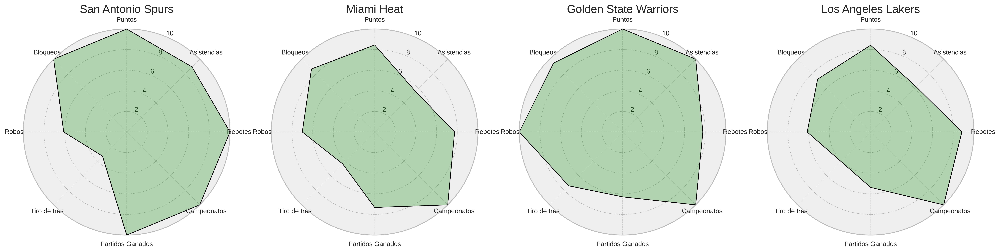

In [ ]:
# Equipos que consiguieron los 3 anillos
plot_radar_compare(teams_NBA, 'San Antonio Spurs', 'Miami Heat', 'Golden State Warriors', 'Los Angeles Lakers', 'TEAM')

**Insights:**
* **San Antonio Spurs**: Podemos ver que en este intervalo de tiempo (2003-2021) domino ampliamente en puntos, rebotes y bloqueos. Un juego muy solido en defensa y sobre todo cerca del aro (por los rebotes y bloqueos). Siendo uno de los equipos más constantes y manteniendo un nivel muy alto en dichas estadísticas. También se puede apreciar un nivel muy alto en asistencias, donde la mayoría de los puntos provenían de un pase.
* **Golden State Warriors:** En este grafico podemos notar que domina en apartados como puntos, asistencias, robos y también en el tiro de tres (parámetro que destaca mucho con respecto a los otros 3 equipos analizados). Un juego muy solido en el perímetro (lejos del aro), tanto ofensivamente como defensivamente. También se puede ver un nivel muy alto en los rebotes y bloqueos.
* **Miami Heat** y **Los Angeles Lakers** presentan siluetas muy parecidas con algunas diferencias. En puntos son muy similares, mientras que se diferencian en bloqueos y robos, donde Miami presenta un nivel un poco más alto (dando más importancia a la defensa). Y también en rebotes, asistencias y tiro de tres, donde en los Lakers se pueden ver niveles un poco mas altos (la parte mas ofensiva).
***

## Analisis Bivariado

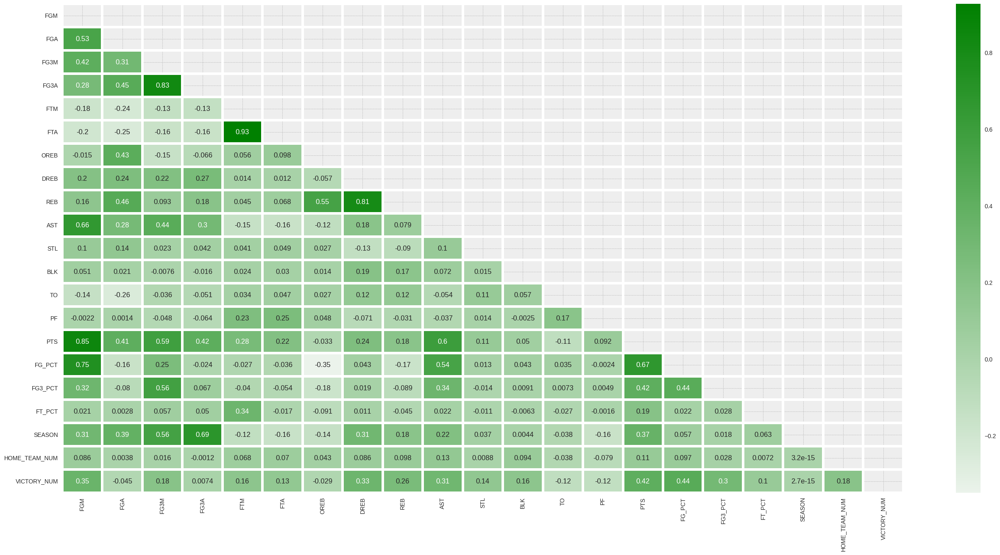

In [ ]:
# Analisis Bivariado del data set df_NBA, para ver posibles relaciones entre los parametros:

df_NBA_AB = df_NBA.drop(['index', 'level_0', 'GAME_ID', 'TEAM_ID', 'PLAYER_ID', 'PLUS_MINUS', 'MATCHES'], axis=1)

heatmap_plot(df_NBA_AB)

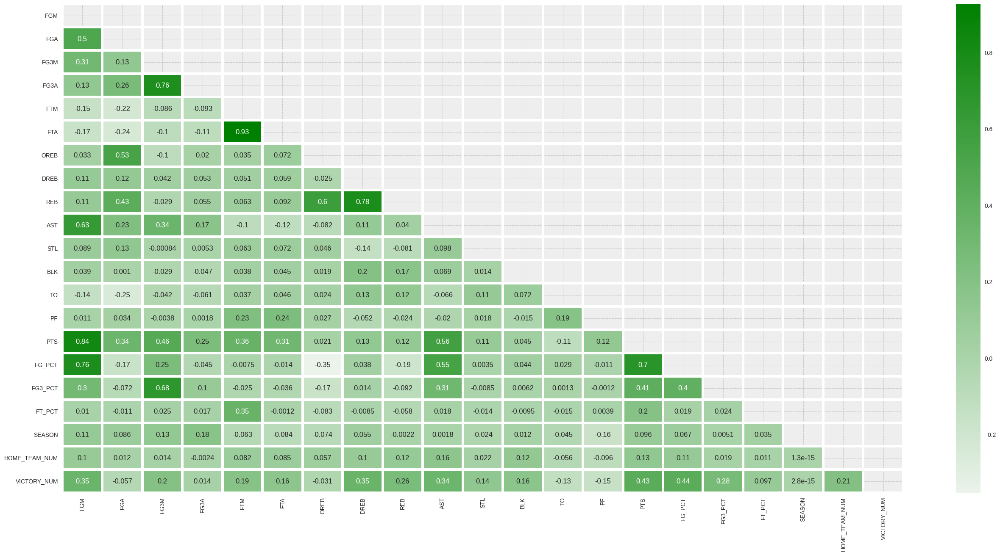

In [ ]:
# Aca tenemos en cuenta el primer periodo (2003-2011), para ver si hay alguna diferencia notoria con el segundo periodo:

df_AB_1 = period_analysis_1.drop(['level_0','index', 'GAME_ID', 'TEAM_ID', 'PLAYER_ID', 'PLUS_MINUS','MATCHES'], axis=1)

heatmap_plot(df_AB_1)

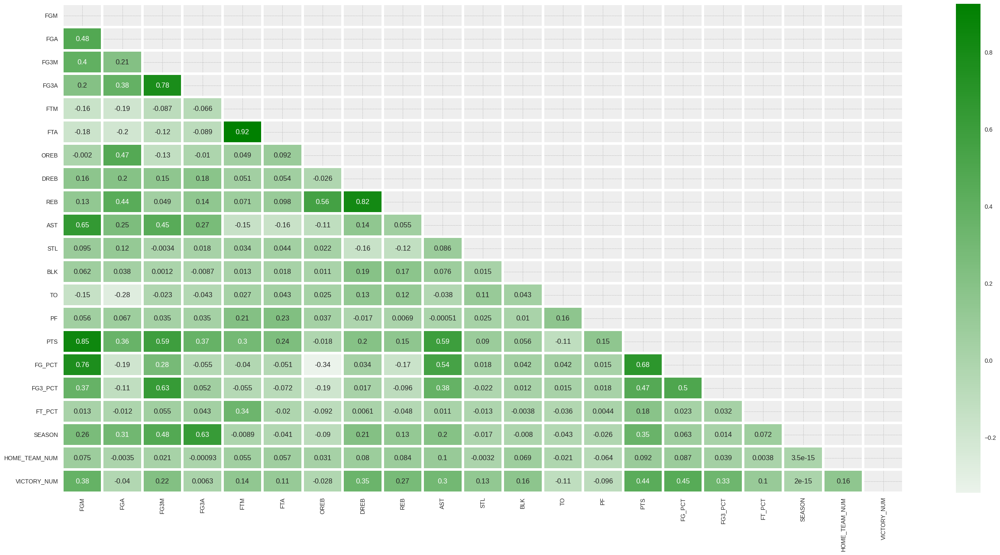

In [ ]:
# Aca tenemos en cuenta el primer periodo (2012-2021):

df_AB_2 = period_analysis_2.drop(['level_0','index', 'GAME_ID', 'TEAM_ID', 'PLAYER_ID', 'PLUS_MINUS','MATCHES'], axis=1)

heatmap_plot(df_AB_2)

**Insights:**

* **FG3A y FG3M:** En "df_NBA" la relación es fuerte (0,83), por lo que podemos elegir uno de los dos parámetros si la finalidad es simplificar la tabla. Me parece mas determinante los tiros de tres intentados (FG3A) que los tiros de tres encestados (FG3M), ya que una de las variables que también hay es el porcentaje de acierto de los tiros intentados (FG3_PCT). En cuanto a los dos periodos de tiempo mencionado anteriormente, no existe mucha diferencia entre ellos y baja un poco el vinculo, en el primero 0,76 y en el segundo 0,78.
* **FTA y FTM:** En "df_NBA" la relación es muy fuerte (0,93), tiene el mismo fundamento que la relación anterior. Podemos elegir un parámetro de los dos, y el indicado seria la cantidad de tiros libres intentados (FTA) por sobre los tiros encestados (FTM), ya que la tabla también cuenta con el porcentaje de acierto de los mismos (FT_PCT). En cuanto a los dos periodos de tiempo establecidos no hay diferencia ninguna, ya que el primero tiene una relación del 0,93 y el segundo 0,92.
* **REB y DREB:** En "df_NBA" la relación es fuerte (0,81), en este caso si tuviéramos que elegir un parámetro de los dos, seria los rebotes totales (REB) por sobre los rebotes defensivos (DREB), ya que abarca también la informacíon de los rebotes ofensivos (OREB), por lo que me parece una variable mas completa. En cuanto a los dos periodos de tiempo existe una pequeña diferencia en la relación entre las variables, en el primero 0,78 mientras que en el segundo periodo 0,82.
* **PTS y FGM:** En "df_NBA" la relación es muy fuerte (0,85), el parámetro mas importante y determinante para ami son los puntos por partido (PTS) por sobre los tiros de dos encestados (FGM), porque ami entender dicha variable abarca mas informacíon, ya que los puntos pueden provenir no solo de tiros de dos, si no también tiros de tres y tiros libres. En cuanto a los dos periodos de tiempo no existe diferencia, ya que el primero tiene una relación del 0,84 y el segundo 0,85.
* **SEASON y FG3A:** Esta relación es para destacar, ya que es interesante. Por un lado tenemos los años de las temporadas que se jugaron (SEASON) y por el otro los tiros de tres intentados (FG3A). Tiene una relación de 0,69, por lo que a medida que pasaban las temporadas, aumentaban también el promedio de los tiros intentados de todos los equipos, por lo que se intuye un intento diferente de jugar, dando cada vez mas importancia a los tiros de tres, logrando agrandar mas la zona de tiro. En el primer periodo de tiempo (2003-2011) tiene una relación de 0,18, por lo que vemos que no tienen mucha incidencia; pero en el segundo periodo de tiempo (2012-2021) existe una relación del 0,63, si vemos una relación mas directa.
* **FG_PCT y OREB:** Es la relación negativa mas grande que encontramos en la matriz, con un -0,35. Lo que podemos intuir que tiene una pequeña tendencia a que cuando un equipo tiene un porcentaje de tiro de dos bajo, la cantidad de rebotes ofensivos tiende a aumentar. Lo que parece algo lógico, ya que cuando erras un tiro se te abre la posibilidad de agarrar un rebote ofensivo.

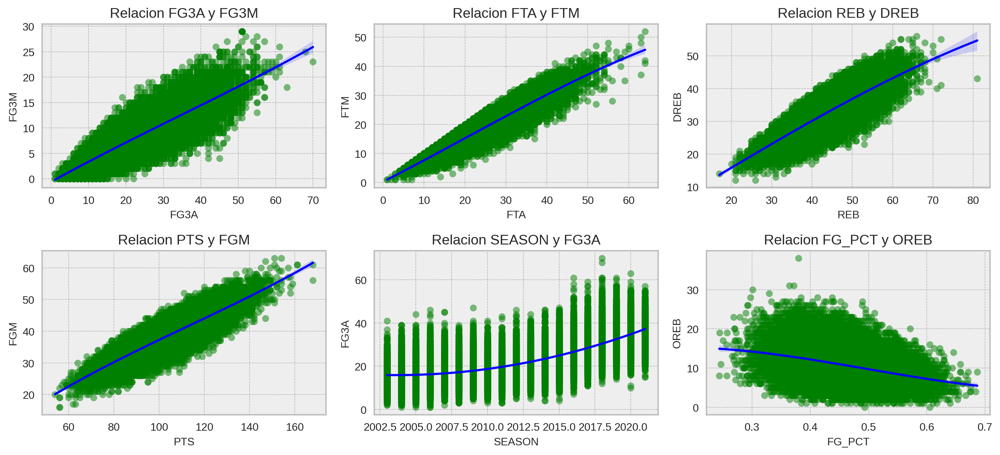

In [ ]:
# Grafico que muestra mas facilmente la relacion directa de las variables explicadas anteriormente:

x_vars = ['FG3A', 'FTA', 'REB', 'PTS', 'SEASON', 'FG_PCT']
y_vars = ['FG3M', 'FTM', 'DREB', 'FGM', 'FG3A', 'OREB']

f, axs = plt.subplots(2, 3, figsize=(13, 6), dpi=250)

for i, ax in enumerate(axs.flatten()):
    sns.regplot(df_NBA, x=x_vars[i], y=y_vars[i], ax=ax,
                scatter_kws={'s': 40, 'color': 'green', 'edgecolor': 'black', 'alpha': 0.5},
                order=3, line_kws={'linewidth': 2, 'color': 'blue'})
    ax.set_xlabel(x_vars[i], fontsize=10)
    ax.set_ylabel(y_vars[i], fontsize=10)
    ax.set_title(f'Relacion {x_vars[i]} y {y_vars[i]}', fontsize=13)

f.tight_layout()
plt.show()

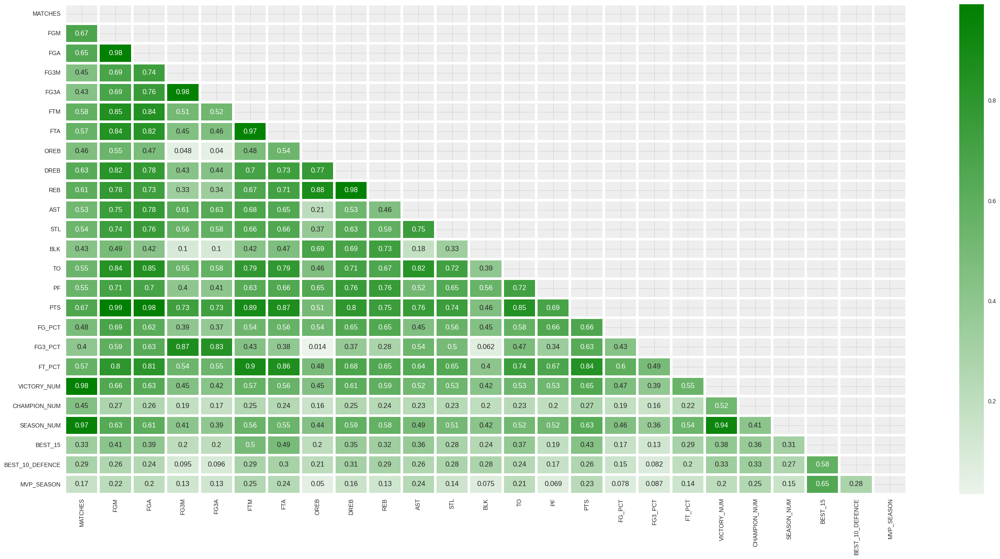

In [ ]:
# Analisis Bivariado del data set df_players, para ver posibles relaciones entre los parametros:

heatmap_plot(df_players)

**Insights:** En este grafico podemos ver muchas relaciones de estadísticas que tienen una fuerte vinculación entre ellas. Vamos a nombrar las más importantes (mayor a 0,9):
* **FGA y FGM:** La relación es muy fuerte (0,98), por lo que podemos elegir uno de los dos parámetros si la finalidad es simplificar la tabla. Me parece mas determinante los tiros de dos intentados (FGA) que los tiros encestados (FGM), ya que una de las variables que también hay en la tabla es el porcentaje de acierto de los tiros intentados (FG_PCT).
* **FG3A y FG3M:** En este apartado también tiene una vinculación muy fuerte (0,98), y es la misma analogía que la relación anterior. Por lo que elegimos "FG3A" por sobre "FGM".
* **FTA y FTM:** Tienen una relación del 0,97, nos quedaríamos con la variable "FTA" por la misma razón que las anteriores.
* **FTM y FT_PCT:** Tienen una relación del 0,9. Debido a que es le tiro más simple del juego, más fácil de anotar, por lo que el porcentaje de tiro es el más alto. Si tuviéramos que quedarnos con una variable seria el porcentaje de tiro, ya que también indirectamente tiene en cuenta los tiros errados.
* **REB y DREB:** Tienen una relación del 0,98. "REB" es una variable mas completa que "DREB", ya que contiene también los rebotes ofensivos.
* **(PTS y FGA) y la relación (PTS y FGM):** Ambas relaciones tienen un vinculo muy fuerte, 0,98 y 0,99 respectivamente. Por lo que podemos ver que existen 3 variables (PTS, FGA, FGM) que se relacionan muy fuerte entre ellas y con tener una sola de ellas se podría explicar las dos restantes. En este caso me parece más completa la variable "PTS" que las otras dos.
* **(MATCHES y VICTORY_NUM), (MATCHES y SEASON_NUM) y (VICTORY_NUM Y SEASON_NUM):** Tres variables que también tienen un vinculo muy fuerte entre ellas (0,98, 0,97 y 0,94 respectivamente). Si tuviéramos que elegir dos variables entre ellas, serian el numero de victorias (VICTORY_NUM) y cantidad de partidos (MATCHES) antes que el numero de temporadas jugadas (SEASON_NUM), ya que son variables que abarcan mas informacíon. Y si fuera una, seria personalmente la cantidad de victorias conseguidas.

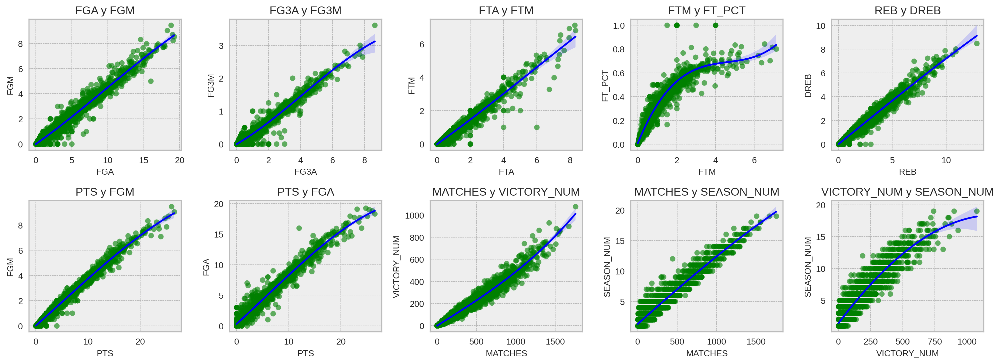

In [ ]:
# Grafico que muestra mas facilmente la relacion directa de las variables explicadas anteriormente:

x_params = ['FGA', 'FG3A', 'FTA', 'FTM', 'REB', 'PTS', 'PTS',  'MATCHES',  'MATCHES' , 'VICTORY_NUM']
y_params = ['FGM', 'FG3M', 'FTM','FT_PCT','DREB','FGM','FGA','VICTORY_NUM','SEASON_NUM','SEASON_NUM']

f, axs = plt.subplots(2, 5, figsize=(16, 6), dpi=250)

for i, ax in enumerate(axs.flatten()):
    sns.regplot(df_players, x=x_params[i], y=y_params[i], ax=ax,
                scatter_kws={'s': 40, 'color': 'green', 'edgecolor': 'black', 'alpha': 0.6},
                order=3, line_kws={'linewidth': 2, 'color': 'blue'})
    ax.set_xlabel(x_params[i], fontsize=10)
    ax.set_ylabel(y_params[i], fontsize=10)
    ax.set_title(f'{x_params[i]} y {y_params[i]}', fontsize=13)

f.tight_layout()
plt.show()

<Figure size 1200x1200 with 0 Axes>

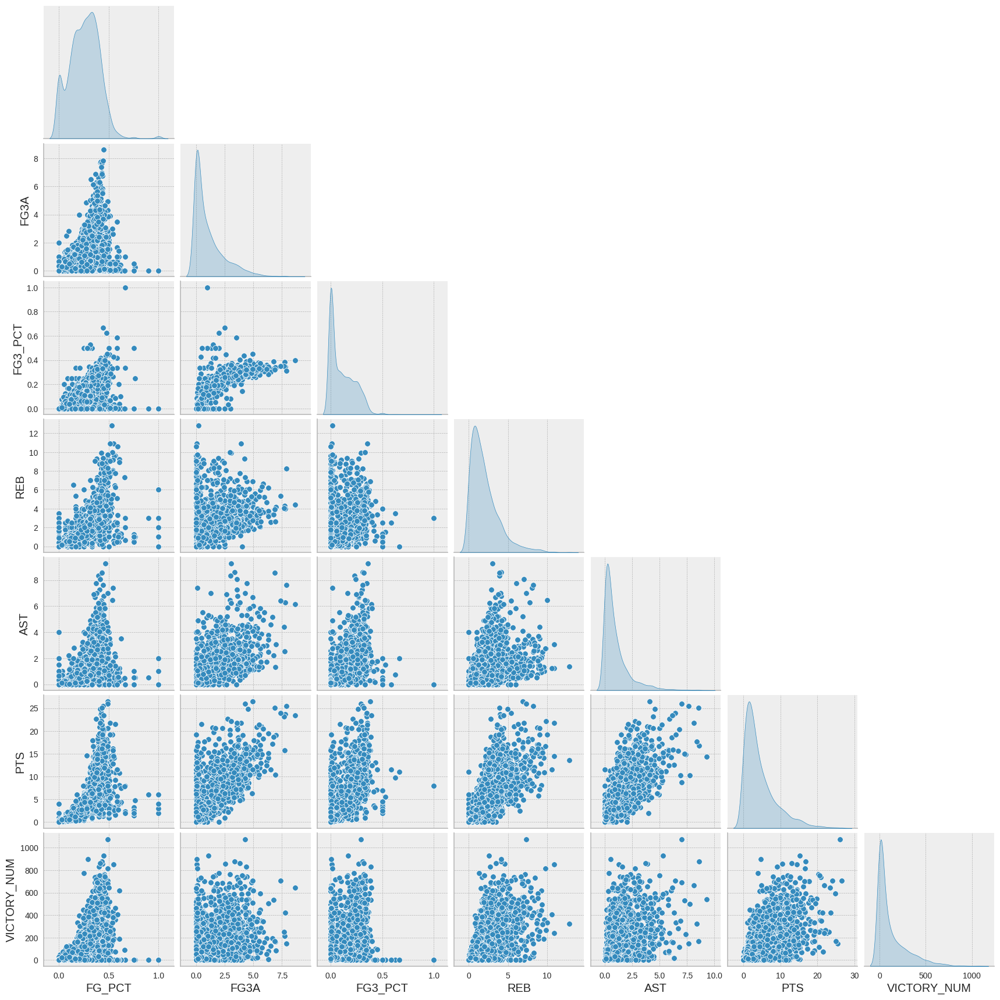

In [ ]:
# Ahora vamos a relacionar las estadísticas de juego luego de eliminar las que mencionamos anteriormente
plt.figure(figsize=(12, 12))

sns.pairplot(df_players[['FG_PCT', 'FG3A', 'FG3_PCT', 'REB', 'AST', 'PTS', 'VICTORY_NUM']], diag_kind='kde', corner=True)

* No se ve alguna relación clara a destacar, pero más adelante en el trabajo vamos a evaluar de nuevo el grafico agregando al mismo variables nuevas (grupos de jugadores) y ver si encontramos de esta forma relaciones destacadas.

***
# **Modelos**
***

## Algoritmo de Clasificación (df_NBA)

### Selection feature

In [ ]:
# Elegir las mejores columnas para el modelo
df_NBA.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48570 entries, 0 to 48569
Data columns (total 40 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   level_0              48570 non-null  int64         
 1   index                48570 non-null  int64         
 2   GAME_ID              48570 non-null  int64         
 3   TEAM_ID              48570 non-null  int64         
 4   PLAYER_ID            48570 non-null  int64         
 5   FGM                  48570 non-null  float64       
 6   FGA                  48570 non-null  float64       
 7   FG3M                 48570 non-null  float64       
 8   FG3A                 48570 non-null  float64       
 9   FTM                  48570 non-null  float64       
 10  FTA                  48570 non-null  float64       
 11  OREB                 48570 non-null  float64       
 12  DREB                 48570 non-null  float64       
 13  REB                  48570 non-

In [ ]:
df_NBA.isnull().sum()

level_0                0
index                  0
GAME_ID                0
TEAM_ID                0
PLAYER_ID              0
FGM                    0
FGA                    0
FG3M                   0
FG3A                   0
FTM                    0
FTA                    0
OREB                   0
DREB                   0
REB                    0
AST                    0
STL                    0
BLK                    0
TO                     0
PF                     0
PTS                    0
PLUS_MINUS             0
FG_PCT                 0
FG3_PCT                0
FT_PCT                 0
VICTORY                0
SEASON                 0
TEAM                   0
GAME_DATE_EST          0
CONFERENCE             0
HOME_TEAM_ID           0
HOME_TEAM_NUM          0
START_DATE_SEASON      0
FINISH_DATE_SEASON     0
START_DATE_PLAYOFF     0
FINISH_DATE_PLAYOFF    0
INSTANCE               0
VICTORY_NUM            0
PERIOD                 0
LOCAL/VISIT            0
MATCHES                0


In [ ]:
df_NBA['VICTORY_NUM'].value_counts()

1    24285
0    24285
Name: VICTORY_NUM, dtype: int64

In [ ]:
X = df_NBA[['FGM','FGA','FG_PCT','FG3M','FG3A','FG3_PCT','FTM','FTA','FT_PCT',
            'OREB','DREB','REB','AST','STL','BLK','TO','PF','PTS','SEASON','HOME_TEAM_NUM']]
Y = df_NBA['VICTORY_NUM']

In [ ]:
# Divido el data set
x_train, x_test, Y_train, Y_test = train_test_split (X, Y, test_size=0.3, random_state=42)

In [ ]:
sfs = SFS(LinearRegression(),
          k_features = 15,
          forward=True,
          scoring = 'r2',
          cv = 0)

sfs.fit(X, Y)
sfs.k_feature_names_

('FGM',
 'FGA',
 'FG_PCT',
 'FG3A',
 'FG3_PCT',
 'FTA',
 'REB',
 'AST',
 'STL',
 'BLK',
 'TO',
 'PF',
 'PTS',
 'SEASON',
 'HOME_TEAM_NUM')

In [ ]:
x_SF = df_NBA[['FGM',
 'FGA',
 'FG_PCT',
 'FG3A',
 'FG3_PCT',
 'FTA',
 'FT_PCT',
 'REB',
 'AST',
 'STL',
 'BLK',
 'TO',
 'PF',
 'PTS',
 'HOME_TEAM_NUM']]

In [ ]:
x_SF.shape

(48570, 15)

#### <u>Regresion Logistica</u>:

In [ ]:
# Modelo
clf = LogisticRegression (C=1, n_jobs=1, random_state=42)
clf.fit(x_train, Y_train)

LogisticRegression(C=1, n_jobs=1, random_state=42)

In [ ]:
predictions = clf.predict(x_test)

In [ ]:
print(classification_report (Y_test, predictions))

              precision    recall  f1-score   support

           0       0.85      0.85      0.85      7295
           1       0.85      0.85      0.85      7276

    accuracy                           0.85     14571
   macro avg       0.85      0.85      0.85     14571
weighted avg       0.85      0.85      0.85     14571



In [ ]:
importance = clf.coef_[0]
impo = pd.DataFrame(list(zip(x_train.columns, importance)), columns=['feature', 'importance'])
impo.sort_values('importance', ascending=False)

,feature,importance
13,STL,0.377517
11,REB,0.229416
17,PTS,0.168747
10,DREB,0.117607
14,BLK,0.116461
9,OREB,0.111809
3,FG3M,0.092361
19,HOME_TEAM_NUM,0.064986
12,AST,0.047494
6,FTM,0.027094


#### <u>Modelo Decision Tree</u>:

In [ ]:
# Entreno
model = tree.DecisionTreeClassifier(random_state=42)
model.fit(x_train, Y_train)

DecisionTreeClassifier(random_state=42)

In [ ]:
Y_pred = model.predict (x_test)

In [ ]:
print(classification_report (Y_test, Y_pred))

              precision    recall  f1-score   support

           0       0.73      0.73      0.73      7295
           1       0.73      0.73      0.73      7276

    accuracy                           0.73     14571
   macro avg       0.73      0.73      0.73     14571
weighted avg       0.73      0.73      0.73     14571



### PCA, Modelos y Metricas

In [ ]:
# Ordeno las filas por el ID del partido
df_NBA = df_NBA.sort_values(['GAME_ID'])

parametros = ['FGM','FGA','FG_PCT','FG3M','FG3A','FG3_PCT','FTM','FTA','FT_PCT',
            'OREB','DREB','REB','AST','STL','BLK','TO','PF','PTS','SEASON','HOME_TEAM_NUM']
target = 'VICTORY_NUM'

In [ ]:
n = df_NBA[parametros]
b = df_NBA[target]

# Division Train/Test

n_train, n_test, b_train, b_test = train_test_split (n, b, test_size=0.30, random_state=42)

In [ ]:
# Fijarse en cada columna del dataset si su distribucion es normal

normal_cols = [] # Columnas normalizadas

for col in n_train.columns:

  k2, p_value = stats.normaltest(df_NBA[col])
  #chequeo de si p-value es mayor a 0.05 es distribucion normal
  if p_value > 0.05:
    normal_cols.append(col)
  print (f'Columna {col}----Estadistico = {k2}, p_value = {p_value}')

# Conjunto de columnas que no presentan una distribucion normal
not_stander = list(set(x_train.columns) - set(normal_cols))

Columna FGM----Estadistico = 202.9652249192469, p_value = 8.446200751954733e-45
Columna FGA----Estadistico = 584.5486589290803, p_value = 1.1664644610475776e-127
Columna FG_PCT----Estadistico = 73.01551688388355, p_value = 1.395988890149607e-16
Columna FG3M----Estadistico = 2988.963855509999, p_value = 0.0
Columna FG3A----Estadistico = 2157.475595864497, p_value = 0.0
Columna FG3_PCT----Estadistico = 391.0440401109642, p_value = 1.2186124178160392e-85
Columna FTM----Estadistico = 1393.957736065659, p_value = 2.0226633728542115e-303
Columna FTA----Estadistico = 1376.26186828716, p_value = 1.4077724910792962e-299
Columna FT_PCT----Estadistico = 1417.992208269471, p_value = 1.221530410494375e-308
Columna OREB----Estadistico = 1740.3574205734267, p_value = 0.0
Columna DREB----Estadistico = 303.3324922341614, p_value = 1.35577062624902e-66
Columna REB----Estadistico = 332.2476187680969, p_value = 7.134216288895705e-73
Columna AST----Estadistico = 473.04418692925685, p_value = 1.904407837422

**Insight:** Realizado la prueba de normalizacion, no encontramos ninguna columna que tenga una distribucion normal, dado que el valor del P-value es menor a 0.05.

In [ ]:
# Variables que no tienen una distribución normal
not_stander

['FGM',
 'FTA',
 'FG3M',
 'FGA',
 'FG_PCT',
 'PF',
 'FTM',
 'FG3_PCT',
 'PTS',
 'OREB',
 'FT_PCT',
 'SEASON',
 'TO',
 'HOME_TEAM_NUM',
 'BLK',
 'AST',
 'FG3A',
 'DREB',
 'STL',
 'REB']

In [ ]:
normal_cols # Variables con distribución normal

[]

In [ ]:
# Proceso de transformacion en X_train, normalizo los datos de las columnas (distribucion mas desconocida)

rs = RobustScaler()
n_train[not_stander] = rs.fit_transform(n_train[not_stander])

In [ ]:
n_train.head()

,FGM,FGA,FG_PCT,FG3M,FG3A,FG3_PCT,FTM,FTA,FT_PCT,OREB,DREB,REB,AST,STL,BLK,TO,PF,PTS,SEASON,HOME_TEAM_NUM
27726,-1.428571,-1.1,-0.862898,0.000000,-0.307692,0.660539,1.625,1.727273,-0.209524,0.8,-0.250,0.111111,-0.166667,1.50,-1.000000,0.2,-0.666667,-0.388889,0.2,0.0
30507,0.142857,-0.6,0.682732,0.000000,-0.384615,0.849265,0.500,0.272727,0.582906,0.0,0.000,-0.111111,0.333333,-0.25,-0.666667,0.2,0.500000,0.333333,0.3,-1.0
15481,-0.571429,-0.5,-0.245083,0.166667,0.461538,-0.227482,-1.125,-0.545455,-1.739869,-0.6,0.000,-0.444444,-1.666667,-0.50,-1.000000,-0.4,-0.333333,-0.888889,-0.3,-1.0
45345,0.571429,0.5,0.298695,1.500000,1.307692,0.598840,-1.250,-1.363636,1.711111,-0.4,-1.250,-1.444444,0.000000,0.50,-0.666667,-0.6,0.000000,0.388889,0.9,-1.0
44911,0.000000,0.8,-0.485790,0.333333,0.461538,0.030331,-0.375,-0.181818,-0.384127,0.6,-0.125,0.111111,0.166667,0.00,-0.666667,-1.4,-0.666667,-0.055556,0.9,0.0


#### **<u>PCA</u>:**

In [ ]:
pca = PCA(random_state=42)

# Entreno y transformo
r_train_pca = pca.fit_transform(n_train)

# Dataframe con las nuevas variables y su relevancia
pcaData = pd.DataFrame(pca.explained_variance_ratio_).reset_index()
pcaData.columns=['Nueva variable','Relevancia']
pcaData.head(10)

,Nueva variable,Relevancia
0,0,0.231475
1,1,0.131951
2,2,0.116738
3,3,0.077948
4,4,0.073476
5,5,0.062204
6,6,0.056898
7,7,0.049972
8,8,0.046697
9,9,0.045250


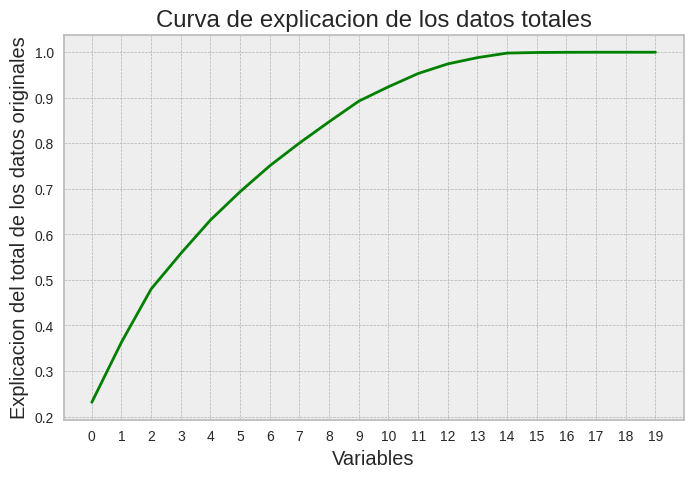

In [ ]:
# Grafico de la importancia acumulada de las variables nuevas

plt.rcParams['figure.figsize'] = 8, 5
plt.plot(np.cumsum(pca.explained_variance_ratio_),color='Green')
plt.xticks(np.arange(0, len(pca.explained_variance_ratio_), 1))
plt.xlabel('Variables')
plt.ylabel('Explicacion del total de los datos originales')
plt.title('Curva de explicacion de los datos totales')
plt.show()

**Insight:** Vemos que a partir de la variable 15 se puede explicar casi el 100% de todos los datos.

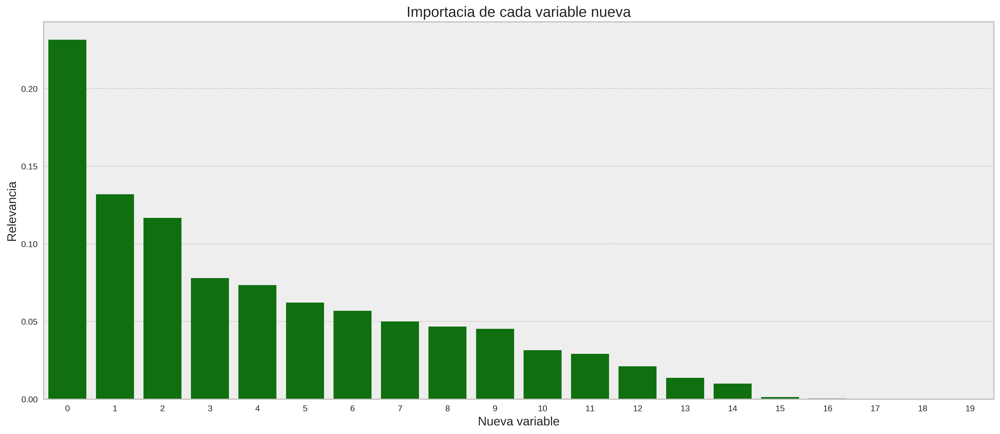

In [ ]:
# Grafico de barras

f, ax = plt.subplots(1, 1, figsize=(20, 8), dpi=350)
sns.barplot(data=pcaData, y='Relevancia', x='Nueva variable', color='Green')
ax.set(title='Importacia de cada variable nueva');

**Insight:** Como podemos ver en el grafico las ultimas 5 variables no tienen casi nada de insidencia en el total de los datos originales.

In [ ]:
# Vamos a entrenar con 14 variables de las 20 que teniamos

pca = PCA(n_components=14, random_state=42)
n_train = pca.fit_transform(n_train)

#### **<u>Modelos</u>:**

In [ ]:
# Regresion logistica
Reg_log = LogisticRegression(random_state=42)
Reg_log.fit(n_train, b_train)

# Arbol de desicion
Arb_dec = tree.DecisionTreeClassifier(random_state=42)
Arb_dec.fit(n_train, b_train)

DecisionTreeClassifier(random_state=42)

In [ ]:
# Realizo la misma transformacion que hice en el train al conjunto del test

n_test[not_stander] = rs.transform (n_test[not_stander])
n_test = pca.transform(n_test)

# Predigo
i_pred = Reg_log.predict(n_test)
i_pred_AB = Arb_dec.predict(n_test)

#### **<u>Metricas</u>:**

In [ ]:
# Regresion Logistica (Metricas)
print('Logistic')

acc = accuracy_score(b_test, i_pred)
f1 = f1_score(b_test, i_pred)
auc = roc_auc_score(b_test, i_pred)
logreg_cm = confusion_matrix(b_test, i_pred)
tp, fp, fn, tn =  logreg_cm.ravel()
print(classification_report(b_test, i_pred))
stats = pd.Series({'accuracy': acc,
              'f1_score' : f1,
              'auc': auc,
              'true positive': tp,
              'true negative': tn,
              })
print(stats)

# Arbol de desicion (Metricas)
print('\nArbol')

acc_2 = accuracy_score(b_test, i_pred_AB)
f1_2 = f1_score(b_test, i_pred_AB)
auc_2 = roc_auc_score(b_test, i_pred_AB)
arb_cm = confusion_matrix(b_test, i_pred_AB)
tp, fp, fn, tn =  arb_cm.ravel()
print(classification_report(b_test, i_pred_AB))

stats_2 = pd.Series({'accuracy': acc_2,
              'f1_score' : f1_2,
              'auc': auc_2,
              'true positive': tp,
              'true negative': tn,
              })
stats_2

Logistic
              precision    recall  f1-score   support

           0       0.85      0.85      0.85      7335
           1       0.85      0.85      0.85      7236

    accuracy                           0.85     14571
   macro avg       0.85      0.85      0.85     14571
weighted avg       0.85      0.85      0.85     14571

accuracy            0.851280
f1_score            0.850541
auc                 0.851286
true positive    6238.000000
true negative    6166.000000
dtype: float64

Arbol
              precision    recall  f1-score   support

           0       0.74      0.72      0.73      7335
           1       0.72      0.74      0.73      7236

    accuracy                           0.73     14571
   macro avg       0.73      0.73      0.73     14571
weighted avg       0.73      0.73      0.73     14571



accuracy            0.731590
f1_score            0.733383
auc                 0.731670
true positive    5281.000000
true negative    5379.000000
dtype: float64

In [ ]:
compare_RL_AD = pd.DataFrame({'Regresion Logistica': [acc, f1, auc],
                                'Arbol de decisión': [acc_2, f1_2, auc_2]},
                                 index = ['Accuracy', 'f1_score', 'AUC'])

compare_RL_AD.head()

,Regresion Logistica,Arbol de decisión
Accuracy,0.851280,0.731590
f1_score,0.850541,0.733383
AUC,0.851286,0.731670


**Insights:**

* Accuracy: Metrica de clasificacion, mide el porcentaje de efectividad de acierto del modelo. Podemos ver aca que es mejor atravez de la regresion logica (85%) que con un arbol de desicion (73%).
* F1 Score: Metrica que busca el balance entre presicion y sencibilidad, se usa para problemas desvalanceados (que este no es el caso). Podemos ver aproximadamente los mismos porcentajes en ambos modelos (85% y 73%).
* AUC: Para clasificacion Binaria, mide el rendimiento global del modelo. Que en este caso tambien mantienen aproximadamente los mismos porcentajes que las dos medidas anteriores.
* Sencibilidad (Recall) y Especificidad: El primero mide el porcentaje de acierto que el modelo predigo como positivo, es decir cuantas victorias (partido de NBA) establecio correctamente en comparacion a todas las victorias reales dentro del test. Y el segundo tiene la misma analogia pero tiene en cuenta las derrotas y no las victorias. En el primer modelo (Regresion logistica) el porcentaje aproximadamente se mantiene en ambas medidas (85%), en cambio en el arbol de desicion tiene mas efectividad prediciendo una victoria que una derrota (74% y 72% respectivamente).
* **Conclusión:** El mejor modelo para predecir nuestro target (el resultado de un partido NBA) es el de Regreción Logistica (85%).

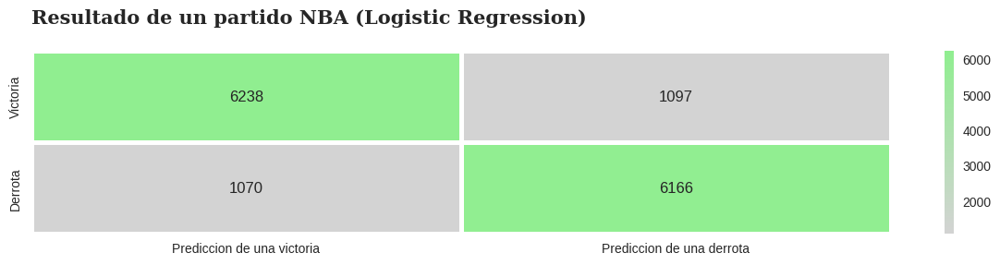

In [ ]:
# Grafico de la matriz de confusion

background_color = 'white'
colormap = LinearSegmentedColormap.from_list("", ["lightgray", "lightgreen"])

fig = plt.figure(figsize=(15,18))
fig.patch.set_facecolor(background_color)
gs = fig.add_gridspec(5, 2)
gs.update(wspace=0.1, hspace=0.5)
ax0 = fig.add_subplot(gs[0, :])

# Mapa de calor
sns.heatmap(logreg_cm, linewidths=2.5,yticklabels=['Victoria','Derrota'],
            xticklabels=['Prediccion de una victoria','Prediccion de una derrota'],
            cmap=colormap,
            cbar=True,
            annot=True,
            fmt='d',
            ax=ax0,
            annot_kws={"fontsize":12}
            )

ax0.text(0, -0.3, 'Resultado de un partido NBA (Logistic Regression)',fontsize=15, fontweight='bold', fontfamily='serif')

plt.show()

In [ ]:
# Test:
acc = accuracy_score(b_test, i_pred)
f1 = f1_score(b_test, i_pred)

# Train:
i_pred_train = Reg_log.predict(n_train)
acc_train = accuracy_score(b_train, i_pred_train)
f1_train = f1_score(b_train, i_pred_train)

In [ ]:
# Comparacion de metricas entre el test y el train con Regreción Logistica
compare_train_test = pd.DataFrame({'Train': [acc_train, f1_train],
                                    'Test': [acc, f1]},
                                    index = ['Accuracy', 'f1_score'])

compare_train_test.head()

,Train,Test
Accuracy,0.847907,0.851280
f1_score,0.847907,0.850541


* **Insight:** Podemos ver que las métricas tanto del test como del train son similares, por lo que concluimos que no hay overfitting.

#### **<u>Busqueda de hiperparametros</u>**:

In [ ]:
# Diccionario para guardar todos las metricas
results = {}

<u>Modelo Base</u>:


In [ ]:
results['Modelo base'] = {'score_train': mean_absolute_error(b_train, Reg_log.predict(n_train)),
                   'score_test': mean_absolute_error(b_test, Reg_log.predict(n_test)),
                   'score_train_r2':r2_score(b_train, Reg_log.predict(n_train)),
                   'score_test_r2':r2_score(b_test, Reg_log.predict(n_test)),
                   'n_trainings': 1}

results

{'Modelo base': {'score_train': 0.15209270860907673,
  'score_test': 0.14872006039393315,
  'score_train_r2': 0.39162400722124735,
  'score_test_r2': 0.40509229584863693,
  'n_trainings': 1}}

* El score mientras más cerca del cero este, mejor va a ser el modelo. Con lo cual esta muy bien.
* Tanto los valores del train como del test son similares, otra confirmación que no hay overfitting.


In [ ]:
# Parametros
params_grid = {'penalty': ['l1', 'l2', 'elasticnet', 'none'],
               'C': [0.001, 0.01, 0.1, 1, 10, 100],
               'fit_intercept': [True, False],
              'solver': ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'],
               'class_weight': [None, 'balanced'],
               'max_iter': [100, 200],
               'tol': [0.0001, 0.001, 0.01],
              'random_state': [42]}

<u>GridSearchCV</u>:

In [ ]:
grid_search =GridSearchCV(Reg_log, params_grid, cv=2, n_jobs=-1, refit=True,
                             scoring='f1', verbose=1)

model_grid = grid_search.fit(n_train, b_train)

Fitting 2 folds for each of 2880 candidates, totalling 5760 fits


In [ ]:
model_grid.best_estimator_

LogisticRegression(C=1, penalty='l1', random_state=42, solver='liblinear',
                   tol=0.001)

In [ ]:
results['Grid Search'] = {'score_train': mean_absolute_error(b_train, grid_search.predict(n_train)),
                         'score_test':mean_absolute_error(b_test, grid_search.predict(n_test)) ,
                         'score_train_r2':r2_score(b_train, grid_search.predict(n_train)),
                         'score_test_r2':r2_score(b_test, grid_search.predict(n_test)),
                        'n_trainings': pd.DataFrame(grid_search.cv_results_).shape[0] * 3}
results

{'Modelo base': {'score_train': 0.15209270860907673,
  'score_test': 0.14872006039393315,
  'score_train_r2': 0.39162400722124735,
  'score_test_r2': 0.40509229584863693,
  'n_trainings': 1},
 'Grid Search': {'score_train': 0.15212212123885996,
  'score_test': 0.14858280145494476,
  'score_train_r2': 0.39150635570456216,
  'score_test_r2': 0.405641356950761,
  'n_trainings': 8640}}

<u>RandomSearch</u>:

In [ ]:
reg_rand =RandomizedSearchCV(Reg_log, params_grid, cv=5, n_jobs=-1, refit=True,
                             scoring='f1', verbose=1)

model_rand = reg_rand.fit(n_train, b_train)

Fitting 5 folds for each of 10 candidates, totalling 50 fits


In [ ]:
model_rand.best_estimator_

LogisticRegression(C=0.001, max_iter=200, penalty='none', random_state=42,
                   solver='newton-cg')

In [ ]:
results['Random Search'] = {'score_train': mean_absolute_error(b_train, model_rand.predict(n_train)),
                   'score_test':mean_absolute_error(b_test, model_rand.predict(n_test)) ,
                   'score_train_r2':r2_score(b_train, model_rand.predict(n_train)),
                   'score_test_r2':r2_score(b_test, model_rand.predict(n_test)),
                   'n_trainings': pd.DataFrame(model_rand.cv_results_).shape[0] * 3}
results

{'Modelo base': {'score_train': 0.15209270860907673,
  'score_test': 0.14872006039393315,
  'score_train_r2': 0.39162400722124735,
  'score_test_r2': 0.40509229584863693,
  'n_trainings': 1},
 'Grid Search': {'score_train': 0.15212212123885996,
  'score_test': 0.14858280145494476,
  'score_train_r2': 0.39150635570456216,
  'score_test_r2': 0.405641356950761,
  'n_trainings': 8640},
 'Random Search': {'score_train': 0.15206329597929352,
  'score_test': 0.14851417198545055,
  'score_train_r2': 0.39174165873793243,
  'score_test_r2': 0.40591588750182295,
  'n_trainings': 30}}

<u>Comparativa final</u>:

In [ ]:
comparison = pd.DataFrame(results).T.reset_index()
comparison

,index,score_train,score_test,score_train_r2,score_test_r2,n_trainings
0,Modelo base,0.152093,0.148720,0.391624,0.405092,1.0
1,Grid Search,0.152122,0.148583,0.391506,0.405641,8640.0
2,Random Search,0.152063,0.148514,0.391742,0.405916,30.0


**Insight:** En conclusión parece mas conveniente usar el modelo base, ya que con un entrenamiento y menos tiempo obtiene valores muy similares a los otros dos.

## Algoritmo de Agrupación (df_players)

#### <u>Transformaciones</u>:

In [ ]:
# Vamos a usar "df_players", para ver que grupos de jugadores nos agrupa
df_players.head()

,PLAYER_NAME,MATCHES,FGM,FGA,FG3M,FG3A,FTM,FTA,OREB,DREB,...,PTS,FG_PCT,FG3_PCT,FT_PCT,VICTORY_NUM,CHAMPION_NUM,SEASON_NUM,BEST_15,BEST_10_DEFENCE,MVP_SEASON
0,A.J. Guyton,1.0,0.000000,4.000000,0.000000,2.000000,4.000000,4.000000,1.000000,1.000000,...,4.000000,0.000000,0.000000,1.000000,0.0,0.0,1.0,0.0,0.0,0.0
1,A.J. Lawson,2.0,1.000000,1.500000,1.000000,1.000000,1.000000,1.000000,0.000000,1.000000,...,4.000000,0.333500,0.500000,0.500000,0.0,0.0,1.0,0.0,0.0,0.0
2,AJ Hammons,58.0,0.586207,1.310345,0.086207,0.206897,0.155172,0.344828,0.241379,0.793103,...,1.413793,0.153862,0.066086,0.064655,14.0,0.0,2.0,0.0,0.0,0.0
3,AJ Price,415.0,1.578313,4.062651,0.643373,1.939759,0.614458,0.826506,0.200000,0.848193,...,4.414458,0.249624,0.187631,0.231696,178.0,0.0,6.0,0.0,0.0,0.0
4,Aamir Simms,4.0,0.250000,0.500000,0.000000,0.000000,0.500000,0.500000,0.750000,0.500000,...,1.000000,0.250000,0.000000,0.250000,0.0,0.0,1.0,0.0,0.0,0.0


<Axes: >

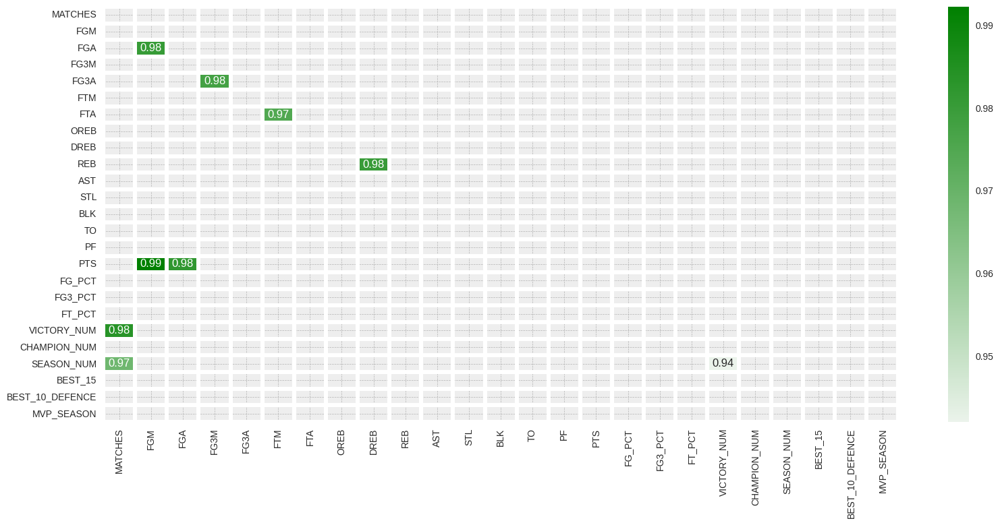

In [ ]:
# Volvemos a hacer el grafico de correlación pero esta vez solo destacando las relaciones superiores a 0,90,
# para eliminar las variables que tienen una vinculación muy fuerte (explicado en el apartado de análisis bivariado)

players = df_players.copy()

# Grafico de correlación
plt.rcParams['figure.figsize'] = 19, 8
corr = players.corr()
mask = np.triu(np.ones_like(corr, dtype=np.bool))
cmap = sns.light_palette('Green', as_cmap=True)
high_corr = corr[corr>=.9]

sns.heatmap(high_corr, mask=mask, cmap=cmap, annot=True, linewidth=3)

**Variables (relación)** ----------------------------------------> **Eliminar**
* FGA y FGM (0,98) -----------------------------------> FGM
* FTA y FTM (0,97) ------------------------------------> FTM
* FG3A y FG3M (0,98) -------------------------------> FG3M
* REB y DREB (0,98) ----------------------------------> DREB
* PTS y FGA (0,98) ------------------------------------> FGA
* VICTORY_NUM Y MATCHES (0,98) ---------> MATCHES
* VICTORY_NUM Y SEASON_NUM (0,94) --> SEASON_NUM

In [ ]:
# Elimino las variables
players.drop(['PLAYER_NAME', 'FGM', 'FTM','FG3M', 'DREB', 'FGA', 'MATCHES', 'SEASON_NUM'], axis=1, inplace=True)

# Normalizo los valores de las variables, para poder trabajar con K-Means
scaler = RobustScaler()
sData = pd.DataFrame(scaler.fit_transform(players), columns = players.columns)

<Axes: >

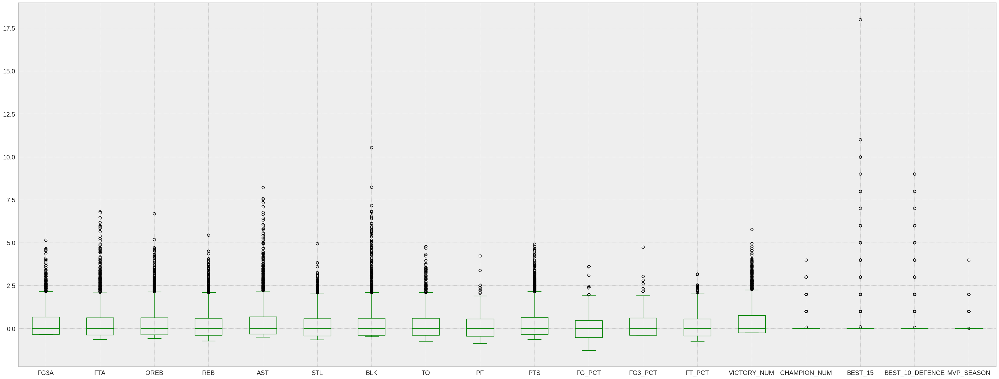

In [ ]:
# Grafico de las variables
sData.boxplot(fontsize = 'large', figsize = (40, 15), color='green')

* Se puede ver la presencia de muchos valores atípicos en las variables.


#### <u>PCA (todas las variables)</u>:

In [ ]:
pca = PCA(random_state=42)
pcaData = pd.DataFrame(pca.fit_transform(sData))
pca.explained_variance_ratio_

array([0.55455228, 0.14695783, 0.06398953, 0.04544261, 0.03518456,
       0.03384136, 0.02501428, 0.02038744, 0.0162143 , 0.01279897,
       0.01176122, 0.00782593, 0.00743823, 0.00590868, 0.0053897 ,
       0.00396959, 0.00270726, 0.00061624])

In [ ]:
# Nueva tabla
pcaData.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17
0,1.452107,-0.476920,-0.221401,-2.112445,0.473580,-1.757476,-1.323058,-0.413471,2.629813,-0.041957,-0.385546,1.694708,0.742747,-0.471192,-0.162329,-0.375016,0.617556,0.014988
1,-0.997352,-1.049319,-0.437081,0.231502,1.056860,-1.495816,0.156827,0.681133,-0.354503,-0.997850,0.137008,0.223195,0.313358,1.431357,-0.528136,0.397662,-0.026512,-0.017952
2,-1.937928,0.546989,0.234436,0.141281,0.456510,0.193468,-0.175357,-0.006087,-0.227873,-0.078663,0.031682,-0.049579,-0.027870,0.086018,0.123273,0.065183,-0.046225,0.003428
3,-0.210714,-1.320847,-0.037159,0.390231,-0.195153,-0.038153,-0.071300,-0.046985,-0.188443,-0.251796,-0.104167,0.065983,-0.114233,0.016969,-0.083970,-0.113493,0.094095,-0.006608
4,-1.769698,0.418058,0.096606,-0.628012,-0.349918,-0.450713,0.283149,-0.036105,-0.205052,-0.588125,-0.222988,0.526429,0.250356,-0.272773,-0.110463,-0.151836,0.081175,-0.013454


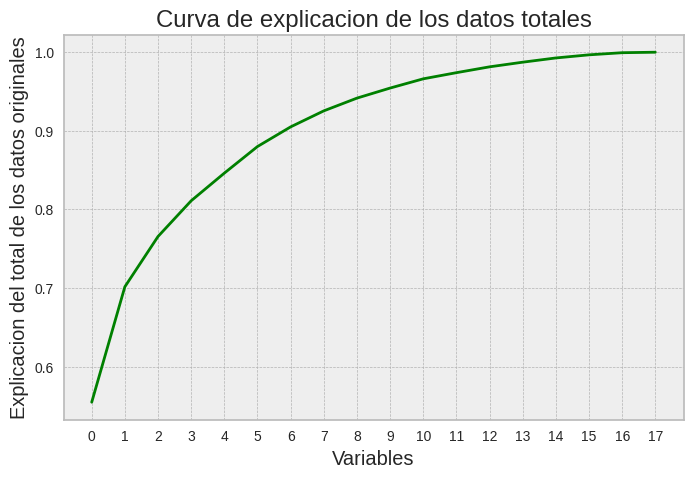

In [ ]:
# Grafico para ver importancia acumulada de las variables nuevas

plt.rcParams['figure.figsize'] = 8, 5
plt.plot(np.cumsum(pca.explained_variance_ratio_),color='Green')
plt.xticks(np.arange(0, len(pca.explained_variance_ratio_), 1))
plt.xlabel('Variables')
plt.ylabel('Explicacion del total de los datos originales')
plt.title('Curva de explicacion de los datos totales')
plt.show()

* Este grafico nos ayuda a ver que con solo 7 variables tenemos mas del 90% de los datos, por lo que podemos borrar mas de la mitad de los parámetros (10 de las 15 que hay).




In [ ]:
# Elimino las columnas que no son relevantes
pcaData.drop(columns = [8, 9, 10, 11, 12, 13, 14, 15, 16, 17], inplace=True)
pcaData.head()

,0,1,2,3,4,5,6,7
0,1.452107,-0.476920,-0.221401,-2.112445,0.473580,-1.757476,-1.323058,-0.413471
1,-0.997352,-1.049319,-0.437081,0.231502,1.056860,-1.495816,0.156827,0.681133
2,-1.937928,0.546989,0.234436,0.141281,0.456510,0.193468,-0.175357,-0.006087
3,-0.210714,-1.320847,-0.037159,0.390231,-0.195153,-0.038153,-0.071300,-0.046985
4,-1.769698,0.418058,0.096606,-0.628012,-0.349918,-0.450713,0.283149,-0.036105


#### <u>K-Means</u>:

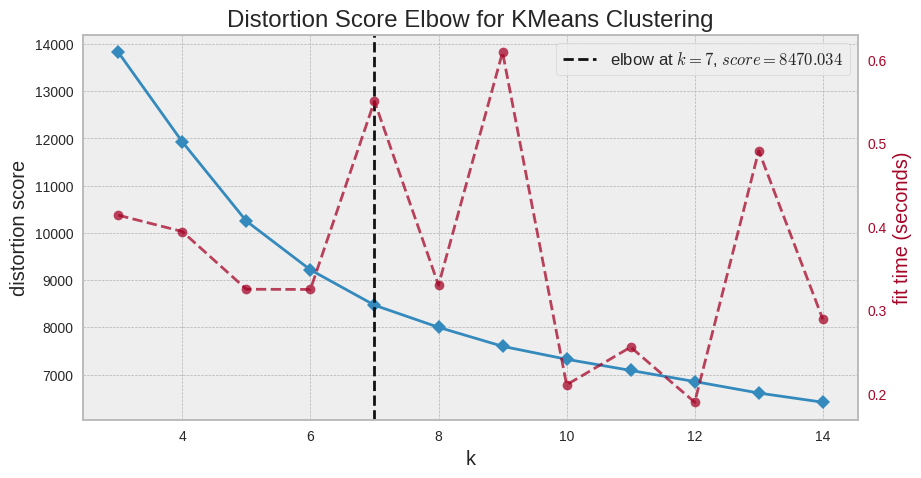

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [ ]:
# Grafico del Metodo del codo, minimo 3 grupos de jugadores.

plt.rcParams['figure.figsize'] = 10, 5
visualizer = KElbowVisualizer(KMeans(random_state=42), k = (3, 15))
visualizer.fit(pcaData)
visualizer.poof()

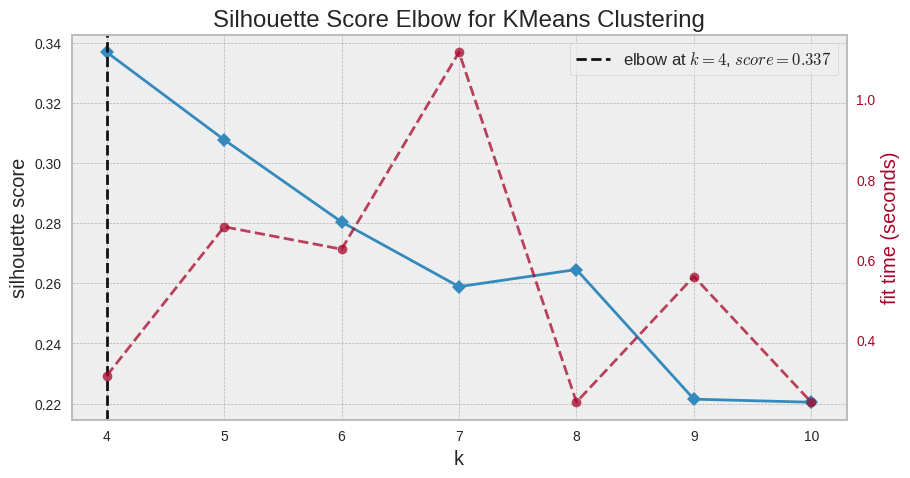

<Axes: title={'center': 'Silhouette Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='silhouette score'>

In [ ]:
# Busqueda por Silhouette Score

visualizer = KElbowVisualizer(KMeans(random_state=42), k = (4, 11), metric= 'silhouette')
visualizer.fit(pcaData)
visualizer.poof()

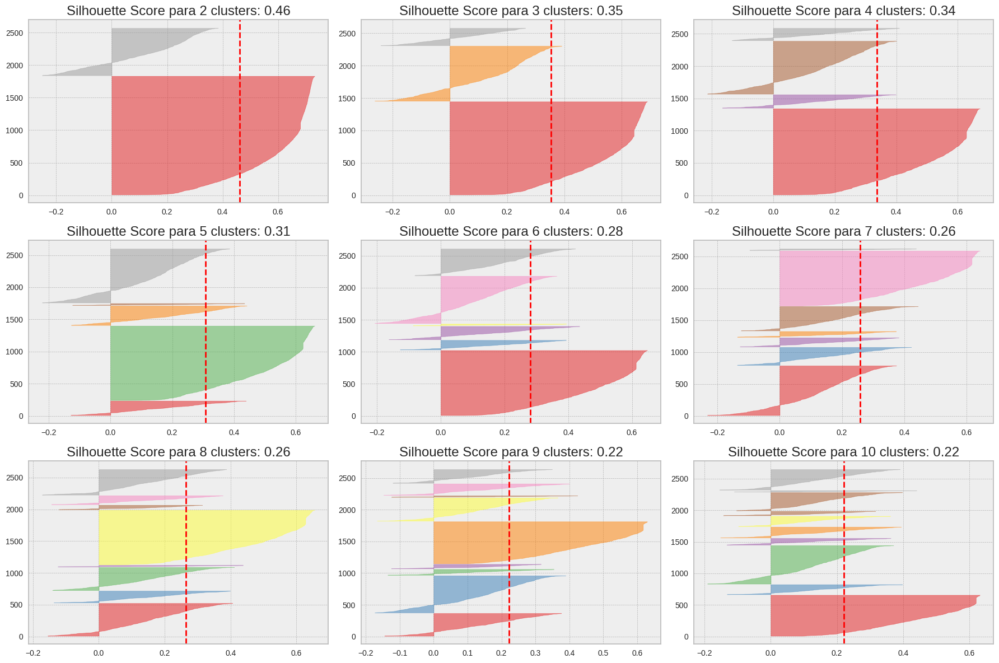

In [ ]:
# Grafico para ver la cercania de cada grupo segun el numero de clusters (Silhouette Score),
# hasta 10 grupos.

fig, ((ax1, ax2, ax3), (ax4, ax5, ax6), (ax7, ax8, ax9)) = plt.subplots(3,3, figsize = (18,12))
ax = [ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9]

for i in range(2,11):
    modelKM = KMeans(n_clusters = i, random_state=42)
    silViz = SilhouetteVisualizer(modelKM, ax=ax[i-2])
    silViz.fit(pcaData)
    txtx = 'Silhouette Score para ' + str(i) + ' clusters: '+ str(round(sil_score(pcaData, modelKM.labels_), 2))
    ax[i-2].set_title(txtx)
fig.tight_layout()

**Insights:**
* Analizando los gráficos parece mas adecuado dividir los jugadores en 7 grupos, ya que podemos ver que hay grupos con las mismas proporciones (cantidad), por lo que se puede realizar una comparación entre ellos y ver sus características. El objetivo es diferenciar todos los jugadores, en un numero de grupos aceptable que los distinga, ya que en los análisis anteriores vimos que hay mucha diferencia de niveles de estadística y en premios tanto individuales como grupales.
* Ademas podemos ver en el grafico de Silhouette que si los agrupamos en 7, todos ellos superan el promedio (0,26).

In [ ]:
# Entrenamiento del modelo con 7 grupos
modelKM = KMeans(n_clusters = 7, random_state=42)
modelKM.fit(pcaData)

# Generacion del clusters
pcaPredKM = pd.Series(modelKM.labels_)
print(pd.concat({
    "Plyers" : pcaPredKM.value_counts(),
    "Percent" : round(pcaPredKM.value_counts(normalize = True)*100, 2)
}, axis = 1))

   Plyers  Percent
5     861    33.76
0     777    30.47
4     381    14.94
1     279    10.94
2     141     5.53
3      89     3.49
6      22     0.86


#### <u>Hirarchical Clustering</u>:

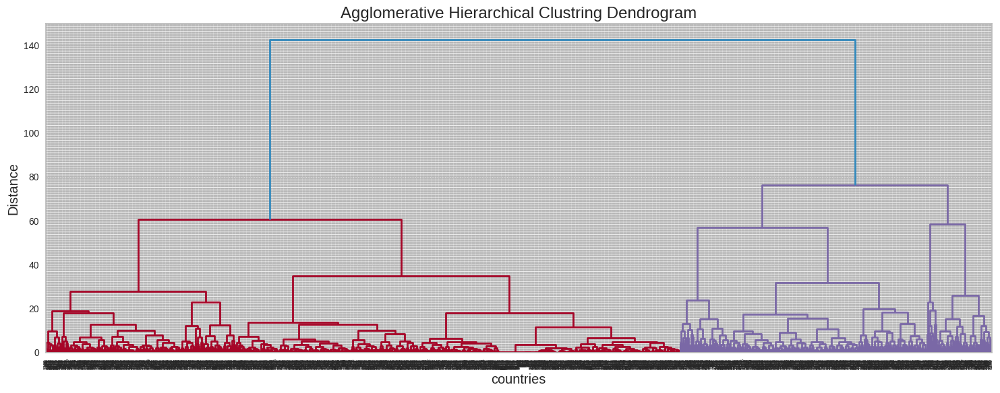

In [ ]:
# Grafico
link = linkage(pcaData, metric = 'euclidean', method = 'ward')

plt.figure(figsize = (15,6))
plt.title('Agglomerative Hierarchical Clustring Dendrogram')
plt.xlabel('countries')
plt.ylabel('Distance')
dendrogram(link)
plt.tight_layout()

In [ ]:
# Entrenando el modelo con 7 grupos
modelAGC = agc(n_clusters = 7, affinity = 'euclidean', linkage = 'ward')
modelAGC.fit(pcaData)
sPredAGC = pd.Series(modelAGC.labels_)
print(pd.concat({'count' : sPredAGC.value_counts(),
                 'percent' : round(sPredAGC.value_counts(normalize = True)*100, 2)},
                axis = 1 ))

   count  percent
3    701    27.49
0    531    20.82
1    512    20.08
6    497    19.49
2    147     5.76
5    135     5.29
4     27     1.06


#### <u>Seleccion del mejor metodo de agrupación</u>:

In [ ]:
# Metricas
silhouette_km = '%.2f' % sil_score(sData, pcaPredKM)
davies_km = '%.2f' % davies_bouldin_score(sData, pcaPredKM)
silhouette_agc = '%.2f' % sil_score(sData, sPredAGC)
davies_agc = '%.2f' % davies_bouldin_score(sData, sPredAGC)

In [ ]:
compare_model = pd.DataFrame({'K-Means': [silhouette_km, davies_km],
                         'Hierarchical': [silhouette_agc, davies_agc]},
                        index = ['Silhouette Score', 'Davies Bouldin Score'])

compare_model.head()

,K-Means,Hierarchical
Silhouette Score,0.23,0.16
Davies Bouldin Score,1.37,1.45


**Insights:**
* Podemos ver que K-Means es el mejor modelo para agrupar los jugadores, ya que presenta las mejores métricas.
* Debido a que el valor de Silhouette de K-Means es más cercano a uno (0,23 a comparación con 0,16) y el valor de Davies-Bouldin esta mas cerca del cero (1,37 contra 1,45).

#### <u>Conclusiones de los grupos creados</u>:

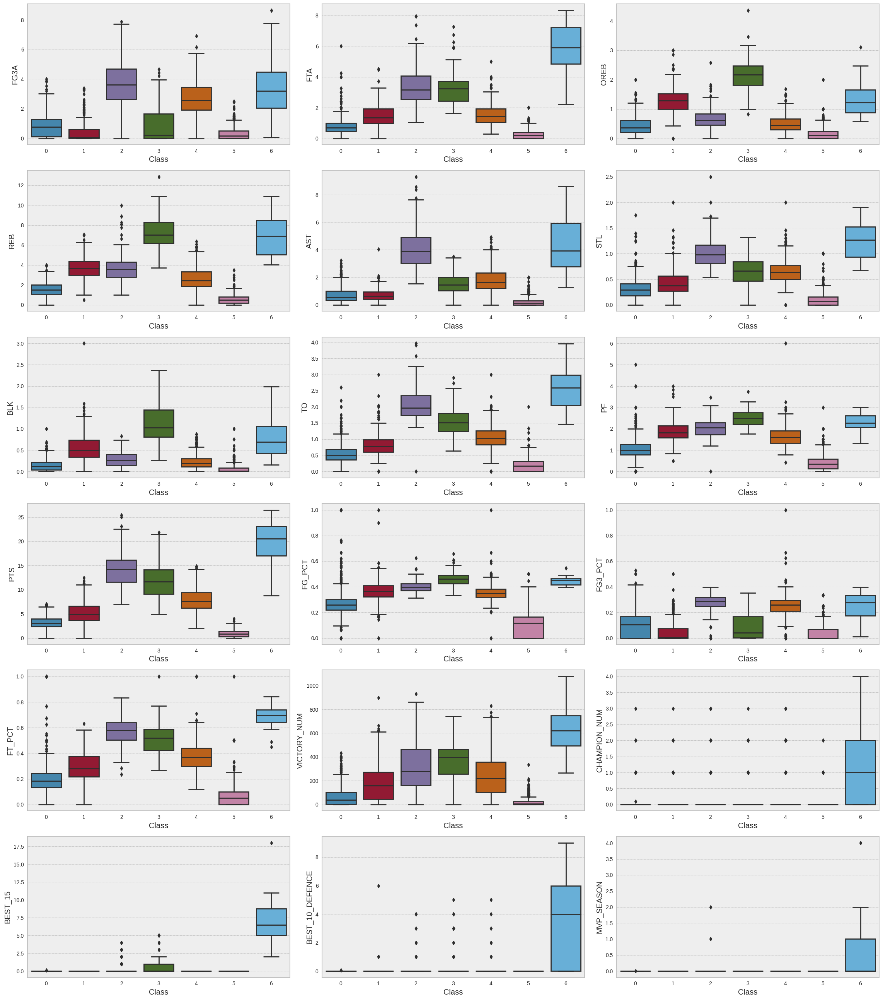

In [ ]:
# Grafico para comparar los grupos con cada una de las estadisticas de los jugadores
dataKM = players.copy()
dataKM['Class'] = pcaPredKM
fig, [ax1, ax2, ax3, ax4, ax5, ax6] = plt.subplots(6, 3, figsize = (23, 26))
ax = [ax1, ax2, ax3, ax4, ax5, ax6]
j, k = 0, 0
for i in dataKM.drop(columns = "Class").columns:
    sns.boxplot(x = "Class", y = i, data = dataKM, ax = ax[j][k])
    if divmod(k,2) == (1,0):
        j += 1
        k = 0
    else: k += 1
fig.tight_layout()
plt.show()

In [ ]:
# Tabla de los grupos con los promedios de cada variable
dataKM.groupby('Class').median()

,FG3A,FTA,OREB,REB,AST,STL,BLK,TO,PF,PTS,FG_PCT,FG3_PCT,FT_PCT,VICTORY_NUM,CHAMPION_NUM,BEST_15,BEST_10_DEFENCE,MVP_SEASON
Class,,,,,,,,,,,,,,,,,,
0,0.760638,0.700000,0.368664,1.508507,0.544850,0.290323,0.121528,0.500000,1.000000,3.000000,0.257024,0.103727,0.184157,40.0,0.0,0.0,0.0,0.0
1,0.062099,1.358169,1.277778,3.666667,0.653846,0.377088,0.497047,0.780488,1.811856,4.961353,0.364755,0.005660,0.281863,160.0,0.0,0.0,0.0,0.0
2,3.611111,3.149515,0.609907,3.552486,3.891530,0.978471,0.266871,1.964339,2.044776,14.236538,0.396281,0.286069,0.578421,279.0,0.0,0.0,0.0,0.0
3,0.215743,3.228814,2.170139,7.031789,1.455405,0.667001,1.027545,1.512651,2.494757,11.652015,0.460791,0.042120,0.517761,395.0,0.0,0.0,0.0,0.0
4,2.574751,1.437330,0.440318,2.449013,1.641955,0.632558,0.192020,1.025000,1.605568,7.609302,0.348087,0.257097,0.366944,222.0,0.0,0.0,0.0,0.0
5,0.175000,0.193548,0.095238,0.500000,0.131579,0.063830,0.012987,0.166667,0.350000,0.875000,0.115084,0.000000,0.050000,5.0,0.0,0.0,0.0,0.0
6,3.202403,5.899063,1.214460,6.891185,3.917518,1.269489,0.693032,2.583928,2.270483,20.575742,0.449327,0.275021,0.696141,619.5,1.0,6.5,4.0,0.0


**Insights:**
* **Grupo 0:** Este es uno de los dos grupos más grande en cuanto a cantidad de jugadores (777). A diferencia del otro grupo grande (numero 5) sus estadísticas son un poco mas altas, llegando a 3 puntos y casi 2 rebotes por partido. Se los podría considerar como jugadores "Suplentes".
* **Grupo 1:** Tiene características o cualidades muy parecidas al grupo 3, pero con un nivel mas bajo. Aportando 5 puntos, 4 rebotes y casi un bloqueo por partido, mientras que no llega a la unidad en asistencias, robos y tiro de tres. Se lo podría considerar como un jugador "Titular poste bajo".
* **Grupo 2:** Este es un grupo selecto de jugadores, que lograron estar dentro de los mejores quintetos de la temporada y ademas dos de ellos ganaron el MVP de temporada. Sumando aproximadamente 14 puntos, 4 asistencias, 4 rebotes, 1 robo y 4 intentos de tres por partido, lo que lo convierte en un jugador muy solido en el perímetro. Se lo podría considerar como una "Estrella perimetral".
* **Grupo 3:** Otro grupo selecto, ya que solo esta conformado por 141 jugadores. De los cuales algunos ganaron un campeonato ó fueron considerados entre los mejores quintetos de la temporada. En este grupo se destacan estadísticas como puntos (12), rebotes (7) y bloqueos (1), por lo que se ve un juego muy solido en la zona pintada (cerca del aro). No sumando en estadísticas como asistencias, robos y tiro de tres. Al grupo se lo podría considerar como un jugador "Estrella poste bajo".
* **Grupo 4:** Grupo de jugadores que juegan en el perímetro, ya que buscan el tiro de 3 (2,6 por partido) y consiguen mas robos que bloqueos (0,6 y 0,2 respectivamente). Suman aproximadamente 8 puntos, 2 asistencias y 2,5 rebotes por partido. Lo podemos considerar como un jugador "Titular perimetral".
* **Grupo 5:** Este es otro de los grupos grandes en cuanto a cantidad de jugadores (861). Este grupo tiene solo 5 victorias en promedio de cada jugador en toda su carrera, sumado a que no llegan a la unidad en ninguna de las estadísticas de juego. Por lo cual son jugadores que no llegaron a tener minutos en cancha y no tuvieron lugar en ningún equipo. Se los puede considerar como "No tuvo exito".
* **Grupo 6:** Es el grupo mas selecto de todos, conformado solo por 22 jugadores entre 2003 al 2021. Logrando en este grupo todos los reconocimientos a nivel individual como grupal (MVP de temporada, mejores quintetos ofensivos y defensivos y campeonatos). Aportando aproximadamente 21 puntos, 7 rebotes y 4 asistencias por partido en toda su carrera. Sin duda se los podría considerar como "Súper estrella".

In [ ]:
# Cambio el nombre a los grupos
grupos = {0: 'Suplentes', 1: 'Titular poste bajo', 2: 'Estrella perimetral', 3: 'Estrella poste bajo',
          4: 'Titular perimetral', 5: 'No tuvo exito', 6: 'Súper estrella'}

dataKM['PLAYER_NAME'] = df_players['PLAYER_NAME']
dataKM.Class.replace(grupos, inplace = True)
dataKM.Class.value_counts()

No tuvo exito          861
Suplentes              777
Titular perimetral     381
Titular poste bajo     279
Estrella perimetral    141
Estrella poste bajo     89
Súper estrella          22
Name: Class, dtype: int64

In [ ]:
# Muestro el grupo de "Súper estrella"
dataKM[dataKM.Class == 'Súper estrella']['PLAYER_NAME']

124             Anthony Davis
204             Blake Griffin
334           Carmelo Anthony
403                Chris Paul
496            Damian Lillard
683             Dirk Nowitzki
709            Draymond Green
727             Dwight Howard
729               Dwyane Wade
862     Giannis Antetokounmpo
1050             James Harden
1193             Jimmy Butler
1214              Joel Embiid
1372            Kawhi Leonard
1420             Kevin Durant
1421            Kevin Garnett
1456              Kobe Bryant
1522             LeBron James
1930              Paul George
2110        Russell Westbrook
2237            Stephen Curry
2316               Tim Duncan
Name: PLAYER_NAME, dtype: object

<Figure size 1200x1200 with 0 Axes>

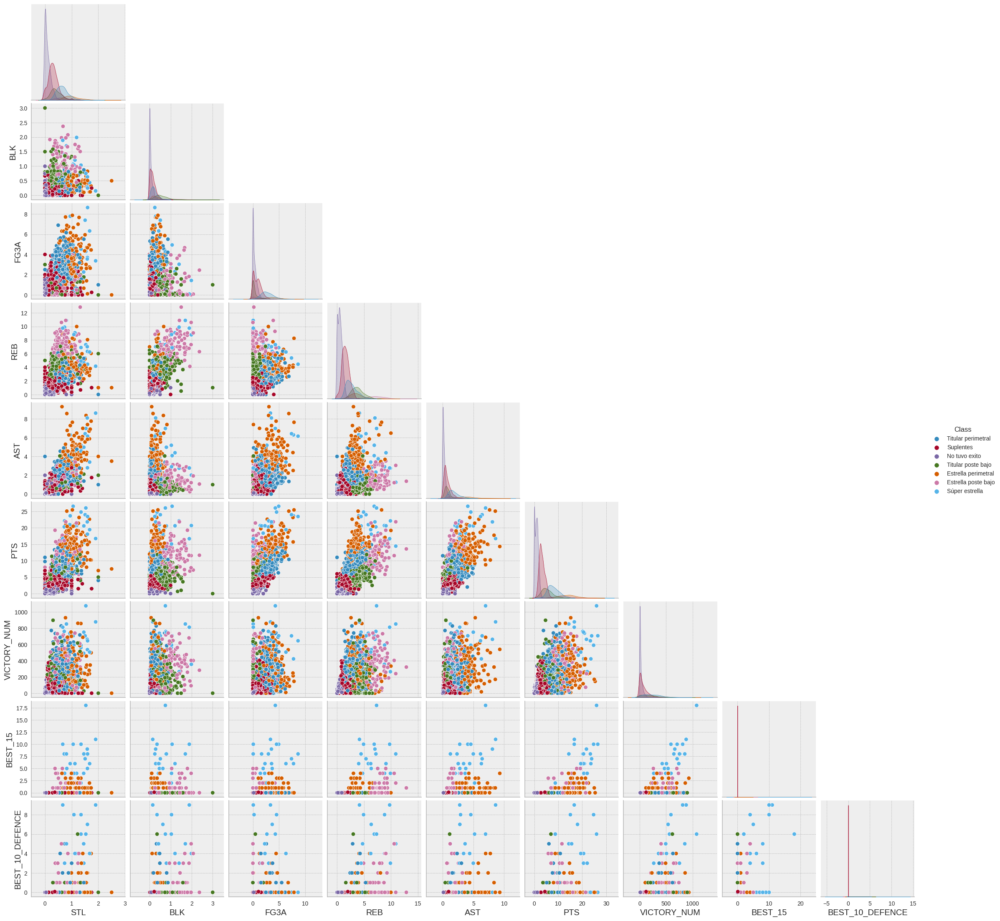

In [ ]:
# Grafico de relación
plt.figure(figsize=(12, 12))

sns.pairplot(dataKM[['STL', 'BLK', 'FG3A', 'REB', 'AST', 'PTS',
                     'VICTORY_NUM', 'BEST_15', 'BEST_10_DEFENCE', 'Class']], diag_kind='kde', hue='Class', corner=True)

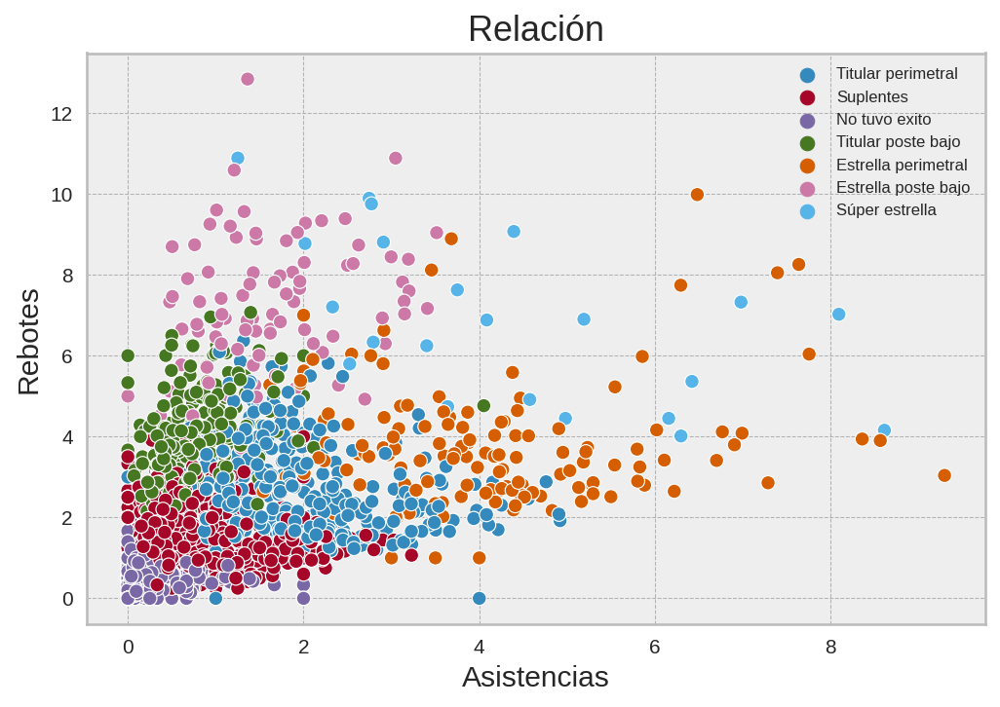

In [ ]:
# En este grafico se pueden ver con claridad los distintos grupos
f, ax = plt.subplots(figsize=(7,5), dpi=150)

sns.scatterplot(dataKM, x='AST', y='REB', hue='Class')
ax.set(xlabel='Asistencias', ylabel='Rebotes', title='Relación')
ax.legend(fontsize=8)

f.tight_layout()

# Exportacion de tablas

In [ ]:
df_NBA.to_excel("RegularSeason.xlsx", index=False)
df_regular_season.to_excel("RegularSeason.xlsx", index=False)
df_playoffs.to_excel('Playoff.xlsx', index=False)
df_ranking_season.to_excel('Ranking.xlsx', index=False)
df_players.to_excel('Players.xlsx', index=False)